## IGO17403 KP Slc4a11-MCD Rosa26 - mTmG/+ exposed tog Tamoxifen for 3d at 6 weeks
6/22/25 - Data generated from 6 week KP Slc4a11-MCD/+ R26-mTmG/+ tumors; data submitted by CHP/EB on 6/3/2025; analyzed by JC 6/22/2025

Analyze global run on cellranger v8 data and create h5_ad files for further analysis - w/o introns

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib

from pathlib import Path
import anndata

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [3]:
Path("./figures/umapfigures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [4]:
results_file = 'write/IGO17402-KPSlc4a11mTmG6w3dTraced.h5ad'  # the file that will store the analysis results

Read in the count matrix into an [`AnnData`](https://anndata.readthedocs.io/en/latest/anndata.AnnData.html) object, which holds many slots for annotations and different representations of the data. It also comes with its own HDF5 file format: `.h5ad`.

In [5]:
adata = sc.read_10x_h5('IGO17402-filtered_feature_bc_matrix.h5', gex_only=False)

reading IGO17402-filtered_feature_bc_matrix.h5
 (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/_core/anndata.py:1908: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [6]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [7]:
samples = list(adata[:,adata.var['feature_types']=='Antibody Capture'].var.index)

In [8]:
# Now filter out barcodes
hashadata = adata[:,samples]
adata = adata[:,[y for y in adata.var_names if y not in samples]]

In [9]:
hashadata.var

,gene_ids,feature_types,genome,pattern,read,sequence
BO1534_B0301,BO1534_B0301,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,ACCCACCAGTAAGAC
BO1535_B0302,BO1535_B0302,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,GGTCGAGAGCATTCA
BO1540_B0303,BO1540_B0303,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CTTGCCGCATGTCAT
BR1615_B0304,BR1615_B0304,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,AAAGCATTCTTCACG
BS1265_B0305,BS1265_B0305,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,CTTTGTCTTTGTGAG
BR1311_B0306,BR1311_B0306,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TATGCTGCCACGGTA
BR1128_B0307,BR1128_B0307,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,GAGTCTGCCAGTATC
BQ1151_B0308,BQ1151_B0308,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TATAGAACGCCAGGC
BQ1152_B0309,BQ1152_B0309,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TGCCTATGAAACAAG


## Preprocessing

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:208: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


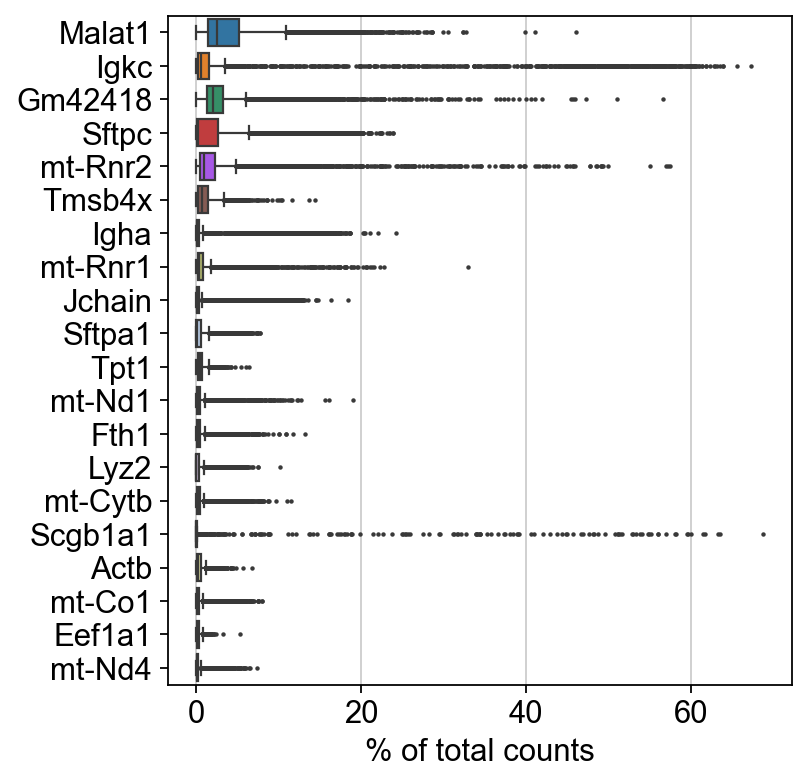

In [10]:
sc.pl.highest_expr_genes(adata, n_top=20, )

In [11]:
sc.pp.filter_cells(adata, min_counts=1500)
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 3478 cells that have less than 1500 counts
filtered out 8 cells that have less than 300 genes expressed
filtered out 32540 genes that are detected in less than 3 cells


In [12]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

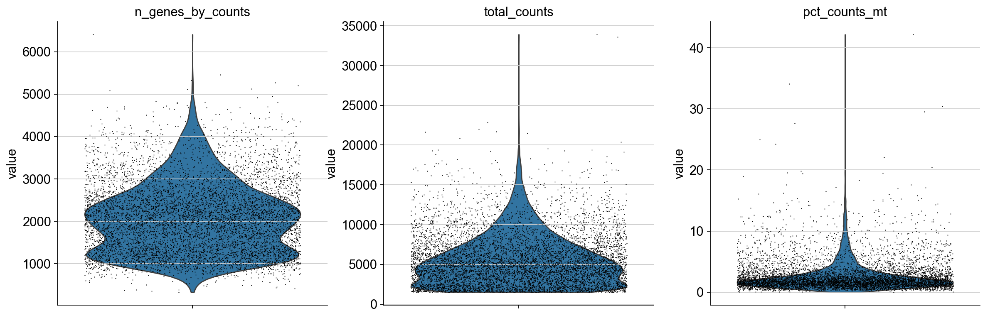

In [13]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

(array([  41.,  196.,  189.,   94.,   78.,  163., 1353., 2349., 2077.,
         528.]),
 array([0.73794912, 0.75942688, 0.78090465, 0.80238241, 0.82386018,
        0.84533794, 0.86681571, 0.88829347, 0.90977123, 0.931249  ,
        0.95272676]),
 <BarContainer object of 10 artists>)

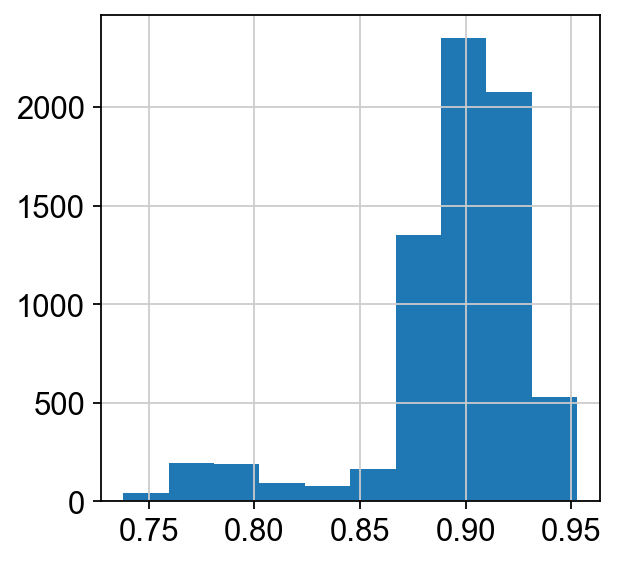

In [14]:
adata.obs["log10GenesPerUMI"] = adata.obs['n_genes_by_counts'].apply(math.log10) / adata.obs['total_counts'].apply(math.log10)
matplotlib.pyplot.hist(adata.obs["log10GenesPerUMI"])

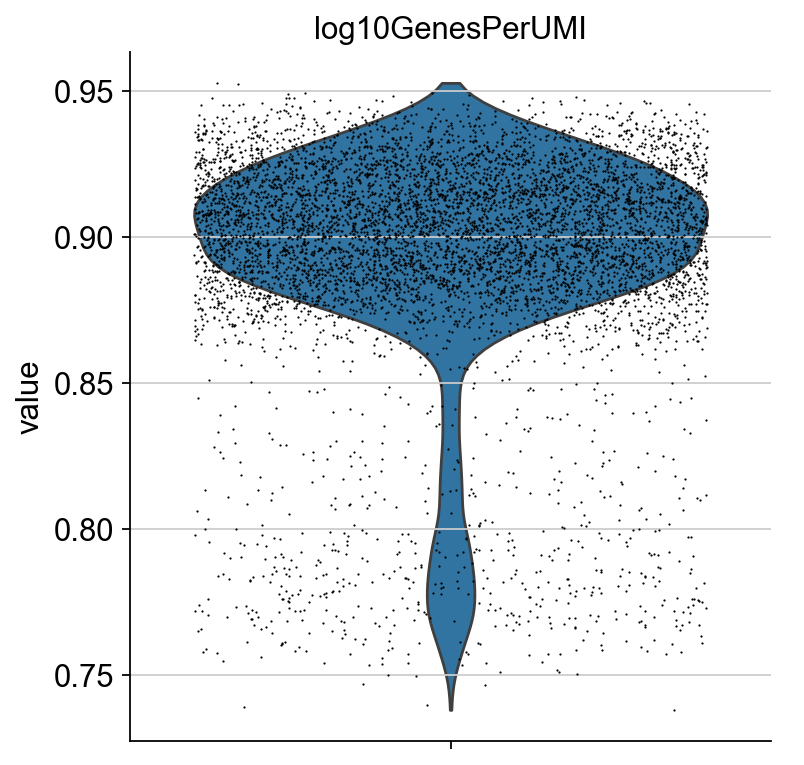

In [15]:
sc.pl.violin(adata, ['log10GenesPerUMI'],
             jitter=0.4, multi_panel=True, rotation=90)

In [16]:
#Filter by Log10GenesPerUMI
adata = adata[adata.obs.log10GenesPerUMI >= 0.8,:]

In [17]:
adata = adata[adata.obs.pct_counts_mt <= 20, :]

## Run Demultiplexing

In [18]:
hashadata = hashadata[hashadata.obs.index.isin(adata.obs.index), :]

In [19]:
hashadata.var_names

Index(['BO1534_B0301', 'BO1535_B0302', 'BO1540_B0303', 'BR1615_B0304',
       'BS1265_B0305', 'BR1311_B0306', 'BR1128_B0307', 'BQ1151_B0308',
       'BQ1152_B0309'],
      dtype='object')

In [20]:
hashCounts = pd.DataFrame(hashadata.X.todense(), columns=hashadata.var_names, index=adata.obs.index)

In [21]:
hashDisc = hashCounts.describe([.1,.2,.3,.4,.5,.6,.7,.8,.9,0.99])
#hashDisc

In [22]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(hashDisc.loc["90%",hashName])
    hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
#hashIDs

BO1534_B0301
1798.0
BO1535_B0302
7.0
BO1540_B0303
3.0
BR1615_B0304
7.0
BS1265_B0305
5.0
BR1311_B0306
33.0
BR1128_B0307
1.0
BQ1151_B0308
528.5
BQ1152_B0309
124.5


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/4170078627.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ True False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/4170078627.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/4170078627.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise 

In [23]:
from matplotlib import pyplot as plt

In [24]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
plt.rcParams['figure.figsize'] = (3,4)

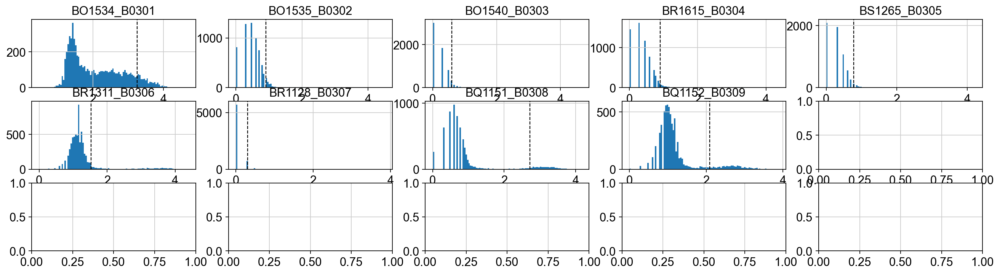

In [25]:
fig, axs = plt.subplots(3,5, figsize =(20, 5))

for i, hashName in enumerate(hashadata.var_names):
    hashCounts2 = np.log10(hashCounts[hashName]+1)
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].hist(hashCounts2, bins = 100)
    axs[i//5,i%5].axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)

#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

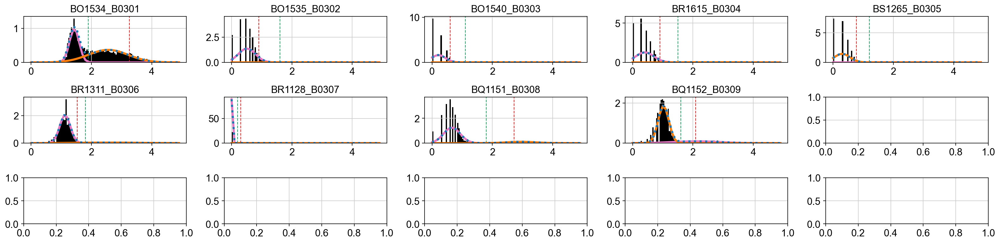

In [26]:
from sklearn.mixture import BayesianGaussianMixture
from scipy.stats import norm
fig, axs = plt.subplots(3,5, figsize =(20, 5))
dfHashBoundry = pd.DataFrame(np.zeros(len(hashadata.var_names)),hashadata.var_names, columns=["boundry"])
gmm = BayesianGaussianMixture(n_components=2, random_state=250,init_params='k-means++')
binEx = np.arange(0,5,5/100).reshape(-1,1)

import pdb
for i, hashName in enumerate(hashadata.var_names):
    hashCount = np.array(np.log10(hashCounts[hashName]+1)).reshape(-1, 1)
    fitGMM = gmm.fit(hashCount)
    mean = fitGMM.means_  
    covs  = fitGMM.covariances_
    weights = fitGMM.weights_
  
    fitGmmBound = fitGMM.predict(binEx)

    x_axis = np.arange(0, 5, 0.1)
    y_axis0 = norm.pdf(x_axis, float(mean[0][0]), np.sqrt(float(covs[0][0][0])))*weights[0] # 1st gaussian
    y_axis1 = norm.pdf(x_axis, float(mean[1][0]), np.sqrt(float(covs[1][0][0])))*weights[1] # 2nd gaussian

    hashBoundry = False #binEx[np.where(fitGmmBound == 1)[0][0]][0]  
    #print(hashName)
    #pdb.set_trace()
    #if hashName == "BJ1609_B0303":
    #if hashName == "BK1009_B0307":    
    #   pdb.set_trace()
    #print(hashName)
    # fix text case where GMM is modeled to occur around a hash by counting the number of switches
    if mean[0][0] < mean[1][0] and (((y_axis1 < y_axis0)[0] == False and sum(v1 != v2 for v1, v2 in zip(y_axis1 < y_axis0, (y_axis1 < y_axis0)[1:])) % 2 == 0) or 
    sum(v1 != v2 for v1, v2 in zip(y_axis1 < y_axis0, (y_axis1 < y_axis0)[1:])) == 1):
        hashBoundry = x_axis[np.where(y_axis1 < y_axis0)[0][-1]+2]
    else:
        hashBoundry = x_axis[np.where(y_axis0 < y_axis1)[0][-1]+2]
    
    naiveBoundry = np.log10(int(hashDisc.loc["90%",hashName])+1)
    
    dfHashBoundry.loc[hashName] = hashBoundry
    
    # Plot 2
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].axvline(naiveBoundry, c='C3', linestyle='dashed', linewidth=1) #red
    axs[i//5,i%5].axvline(hashBoundry, c='C2', linestyle='dashed', linewidth=1)  #green
    axs[i//5,i%5].hist(hashCount, density=True, color='black', bins=100)        
    axs[i//5,i%5].plot(x_axis, y_axis0, lw=3, c='C6')                            #pink
    axs[i//5,i%5].plot(x_axis, y_axis1, lw=3, c='C1')                            #orange
    axs[i//5,i%5].plot(x_axis, y_axis0+y_axis1, lw=3, c='C0', ls=':')            #dotted blue
    
plt.tight_layout(pad=1.0)
#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

In [27]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
#set manual minimum threshold to be 0.5
for hashName in hashadata.var_names:
    print(hashName)
    print(dfHashBoundry.loc[hashName].values[0])
    #manually set minimum threshold to 0.5 given poor HashData
    if (dfHashBoundry.loc[hashName].values[0] < 1):
        dfHashBoundry.loc[hashName].values[0] = 1
    print(dfHashBoundry.loc[hashName].values[0])
    hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
#hashIDs

BO1534_B0301
1.9000000000000001
1.9000000000000001
BO1535_B0302
1.6
1.6
BO1540_B0303
1.1
1.1
BR1615_B0304
1.5
1.5
BS1265_B0305
1.2000000000000002
1.2000000000000002
BR1311_B0306
1.8
1.8
BR1128_B0307
0.2
1.0
BQ1151_B0308
1.8
1.8
BQ1152_B0309
1.6
1.6


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/2024925687.py:11: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ True  True False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/2024925687.py:11: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/2024925687.py:11: FutureWarning: Setting an item of inc

In [28]:
classification = np.empty(len(adata), dtype="object")
i = 0
for cellBar, hashBool in hashIDs.iterrows():
    numHashes = sum(hashBool)
    if (numHashes == 1):
        classif = hashID[hashBool.values].values[0]
    elif (numHashes > 1):
        classif = "doublet"
    else:
        classif = "negative"
    classification[i] = classif
    i = i + 1
    #break

In [29]:
adata.obs["Classification"] = classification
hashadata.obs["Classification"] = classification
adata.obs["Classification"].value_counts()

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/4135005838.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["Classification"] = classification
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/4135005838.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  hashadata.obs["Classification"] = classification


Classification
BO1534_B0301    2745
doublet          824
negative         748
BQ1151_B0308     632
BQ1152_B0309     590
BR1311_B0306     335
BS1265_B0305     233
BO1540_B0303     203
BR1615_B0304     193
BO1535_B0302     113
BR1128_B0307      30
Name: count, dtype: int64

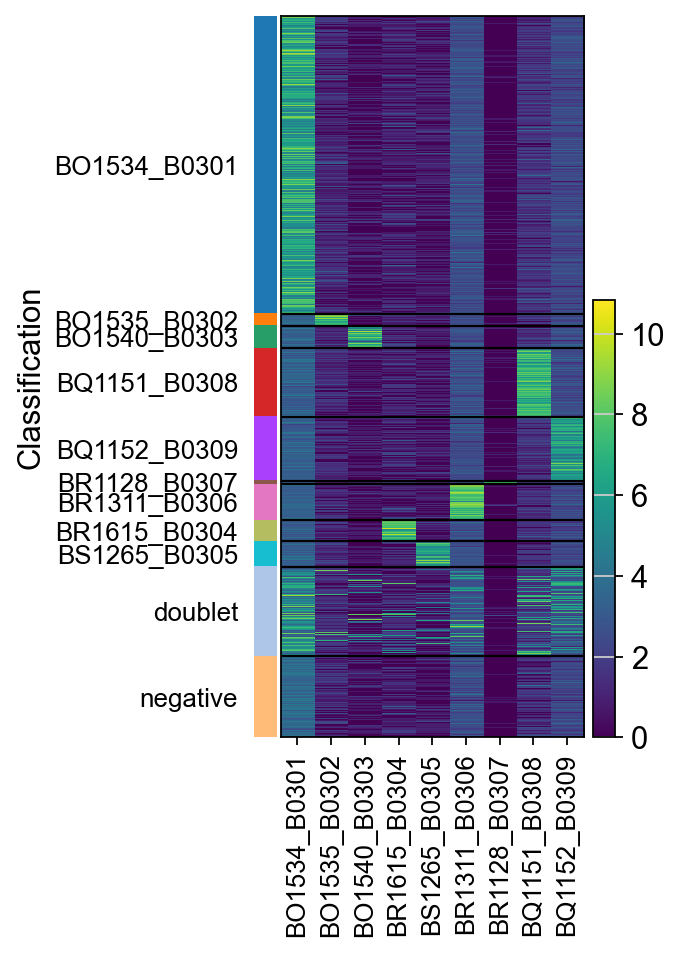

In [30]:
#output visulaization of hashing
sc.pl.heatmap(hashadata, hashadata.var_names, groupby="Classification", log=True)#, save = f"_{figName}_hash.png")

## set highly variable genes before moving all mean to 0

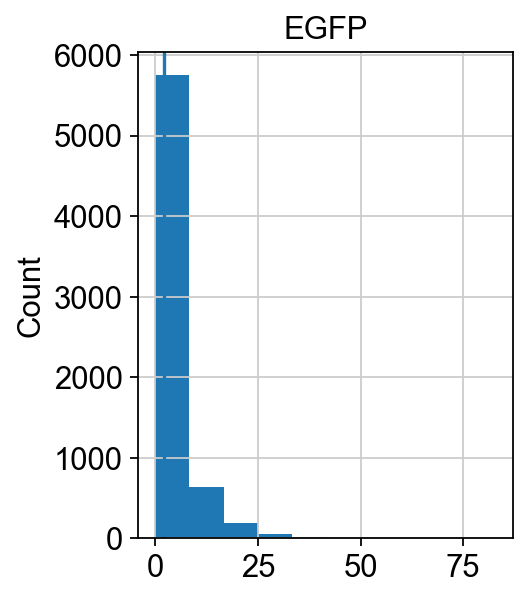

In [31]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['EGFP'])].toarray())
plt.ylabel("Count")
plt.title("EGFP")
plt.axvline(x=2)
plt.show()

In [32]:
adata.obs['EGFP_count'] = adata.X[:,adata.var.index.isin(['EGFP'])].toarray()

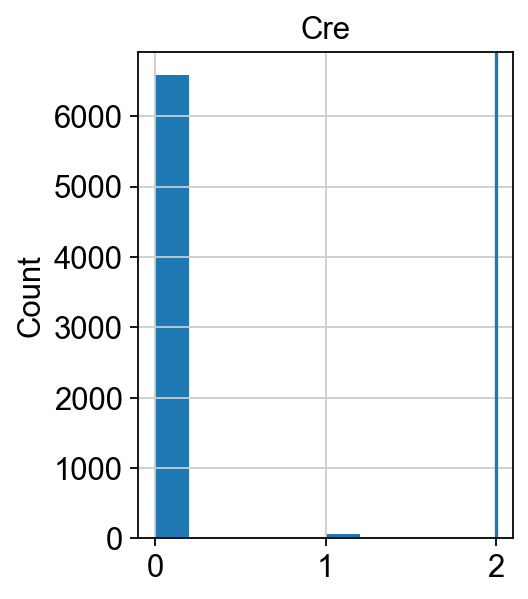

In [33]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['Cre'])].toarray())
plt.ylabel("Count")
plt.title("Cre")
plt.axvline(x=2)
plt.show()

In [34]:
adata.obs['Cre_count'] = adata.X[:,adata.var.index.isin(['Cre'])].toarray()

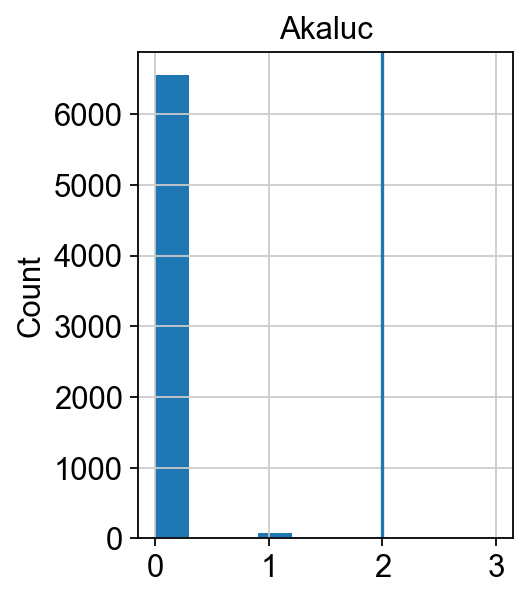

In [35]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['Akaluc'])].toarray())
plt.ylabel("Count")
plt.title("Akaluc")
plt.axvline(x=2)
plt.show()

In [36]:
adata.obs['Akaluc_count'] = adata.X[:,adata.var.index.isin(['Akaluc'])].toarray()

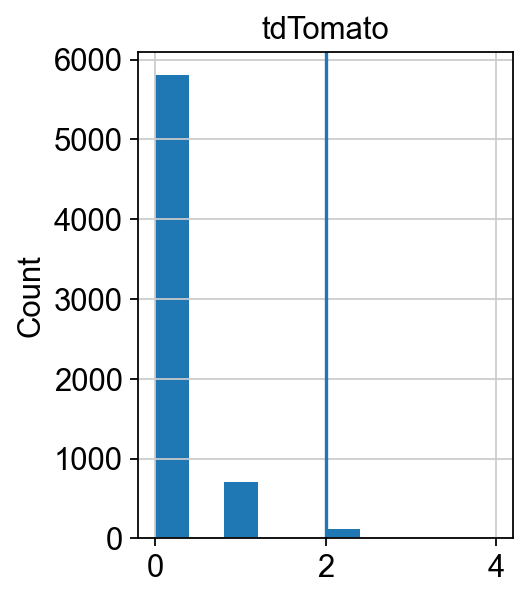

In [37]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['tdTomato'])].toarray())
plt.ylabel("Count")
plt.title("tdTomato")
plt.axvline(x=2)
plt.show()

In [38]:
adata.obs['tdTomato_count'] = adata.X[:,adata.var.index.isin(['tdTomato'])].toarray()

## Filter doublets and negative cells

In [39]:
adata.obs.Classification.value_counts()

Classification
BO1534_B0301    2745
doublet          824
negative         748
BQ1151_B0308     632
BQ1152_B0309     590
BR1311_B0306     335
BS1265_B0305     233
BO1540_B0303     203
BR1615_B0304     193
BO1535_B0302     113
BR1128_B0307      30
Name: count, dtype: int64

In [40]:
adata.obs['Classification'].isin(['doublet','negative'])

AAACCCGCAATATCGA-1    False
AAACCCGCAATGCGTG-1    False
AAACCCGCACCTAACC-1    False
AAACCCGCACCTGCTG-1    False
AAACCCTGTGGGTCTC-1    False
                      ...  
TGTGGTTGTTCGATAC-1    False
TGTGTACGTGATCCTG-1    False
TGTGTACGTTAGCGCC-1    False
TGTGTTAGTCTGGCTA-1     True
TGTGTTAGTTCGCCTT-1    False
Name: Classification, Length: 6646, dtype: bool

In [41]:
adata

AnnData object with n_obs × n_vars = 6646 × 22309
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'EGFP_count', 'Cre_count', 'Akaluc_count', 'tdTomato_count'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [42]:
adata = adata[~adata.obs['Classification'].isin(['doublet','negative']),:]
# consider trying without BN1351_B0302 -> hashing looks strange

In [43]:
adata.obs.Classification.value_counts()

Classification
BO1534_B0301    2745
BQ1151_B0308     632
BQ1152_B0309     590
BR1311_B0306     335
BS1265_B0305     233
BO1540_B0303     203
BR1615_B0304     193
BO1535_B0302     113
BR1128_B0307      30
Name: count, dtype: int64

## Set Groups

In [44]:
samples

['BO1534_B0301',
 'BO1535_B0302',
 'BO1540_B0303',
 'BR1615_B0304',
 'BS1265_B0305',
 'BR1311_B0306',
 'BR1128_B0307',
 'BQ1151_B0308',
 'BQ1152_B0309']

In [45]:
#Set groups
#BO1016_GFP has Akaluc (BO1016_BFP does not)
adata.obs['Group'] = '6wk3d'
adata.obs['Allele'] = 'Slc4a11'
adata.obs['Allele'][adata.obs.Classification.isin(['BQ1151_B0308',
                                                   'BQ1152_B0309'])] = 'Hopx'
#adata.obs['traced'] = 'traced'
#adata.obs['traced'][adata.obs.Classification.isin(['111970-1',
#                                                   '111970-2'])] = 'subq'
#adata.obs['traced'][adata.obs.Classification.isin(['BN1970_GFP'])] = 'carrier'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/3961249006.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['Group'] = '3d'
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/3961249006.py:5: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https:

In [46]:
adata.layers['counts']=adata.X.copy()

In [47]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [48]:
sc.pp.log1p(adata)

In [49]:
sc.pp.highly_variable_genes(adata) #batch_key=Classification

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


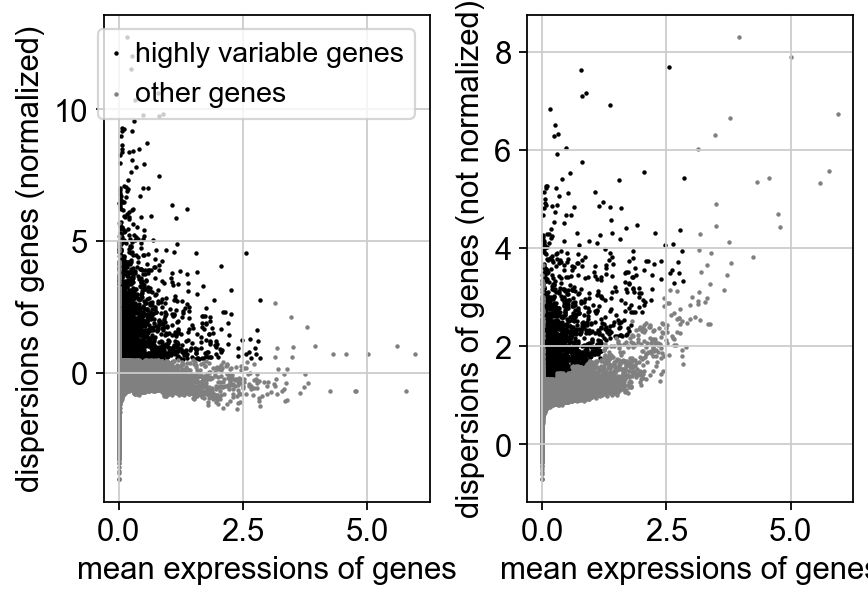

In [50]:
sc.pl.highly_variable_genes(adata)

In [51]:
#will need to update this after realignment
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tagBFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/2467826253.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/246782

In [52]:
adata.raw = adata

In [53]:
adata.write('write/allmice-IGO17402.h5ad', compression='gzip')

In [54]:
sc.pp.scale(adata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


## Principal component analysis

In [55]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:01)


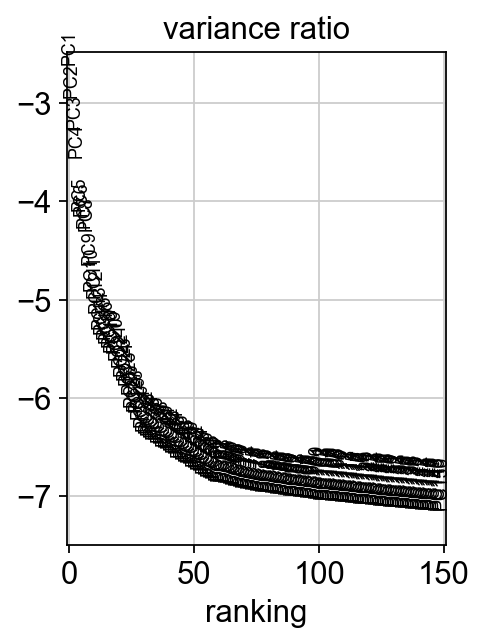

In [56]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

In [57]:
adata.write(results_file, compression='gzip')

## Computing the neighborhood graph

In [58]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)


## Embedding the neighborhood graph

In [59]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:06)


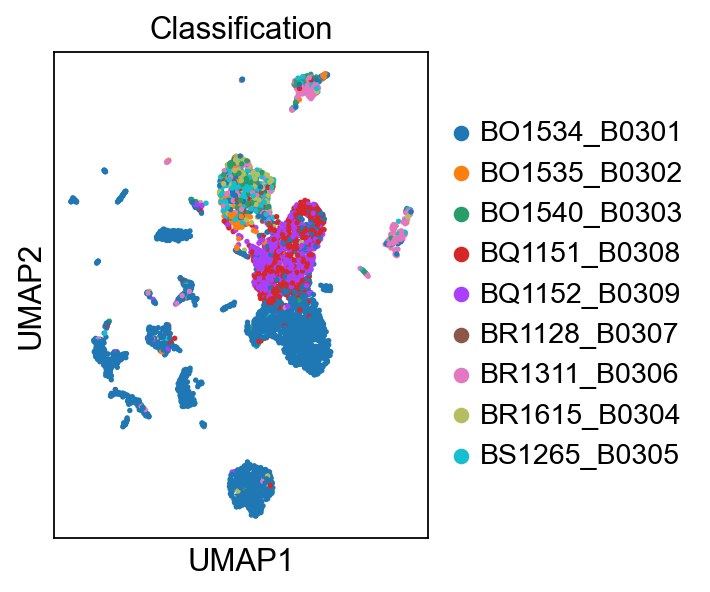

In [60]:
sc.pl.umap(adata, color=['Classification'])

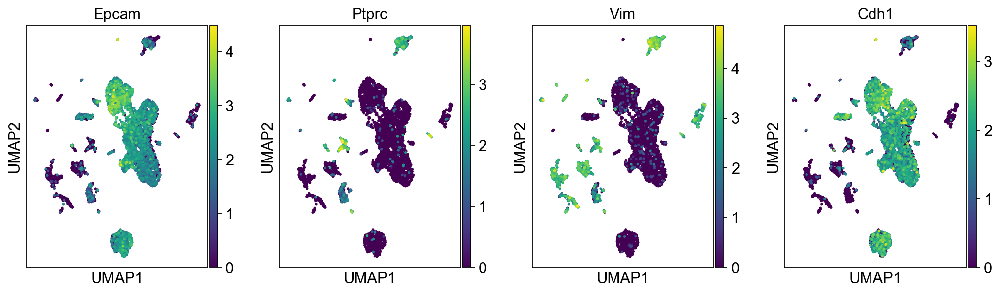

In [61]:
sc.pl.umap(adata, color=['Epcam','Ptprc','Vim', 'Cdh1',]) #'Ptprc','Cdh2'

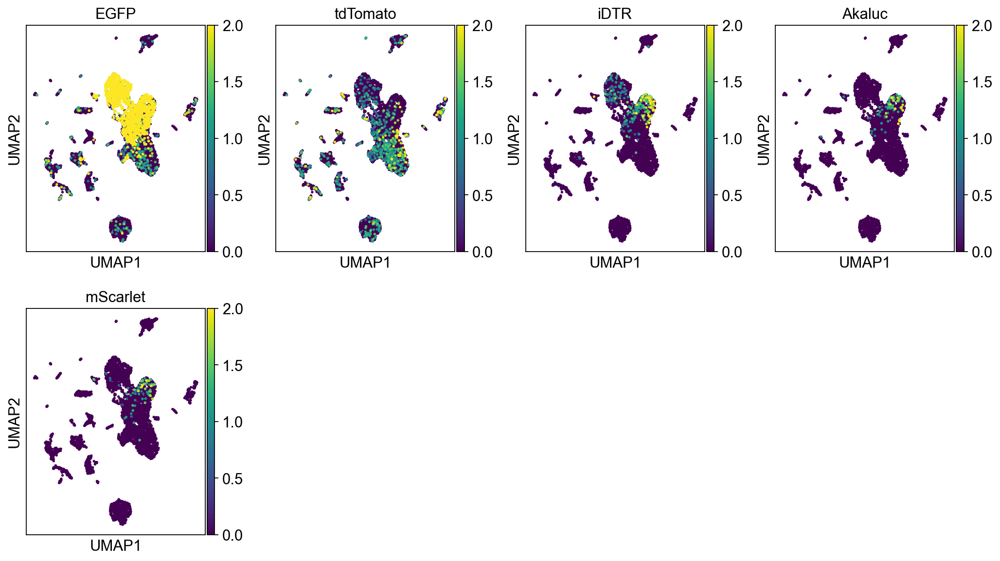

In [62]:
sc.pl.umap(adata, color=['EGFP','tdTomato','iDTR','Akaluc','mScarlet'], vmax=2)

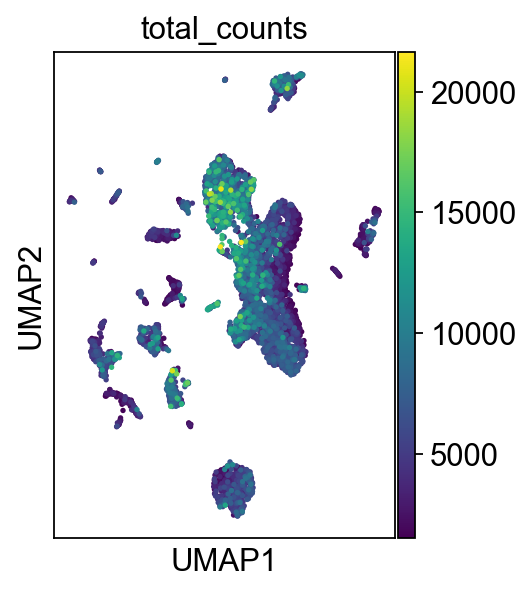

In [63]:
sc.pl.umap(adata, color=['total_counts'])

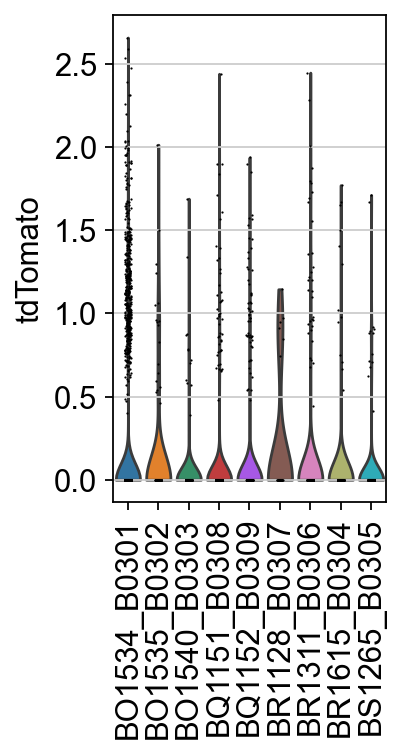

In [64]:
sc.pl.violin(adata, 'tdTomato','Classification',rotation=90)

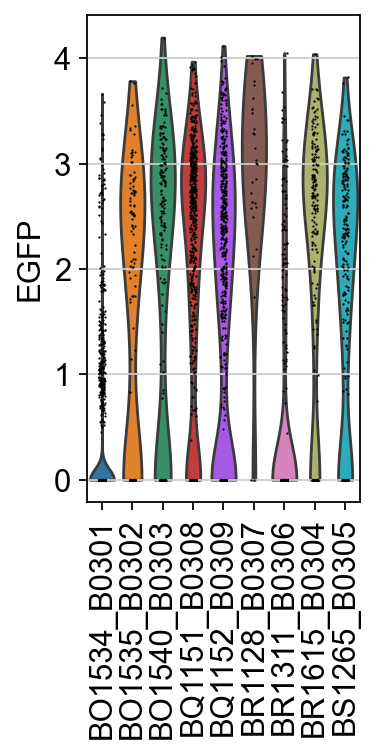

In [65]:
sc.pl.violin(adata, 'EGFP','Classification',rotation=90)

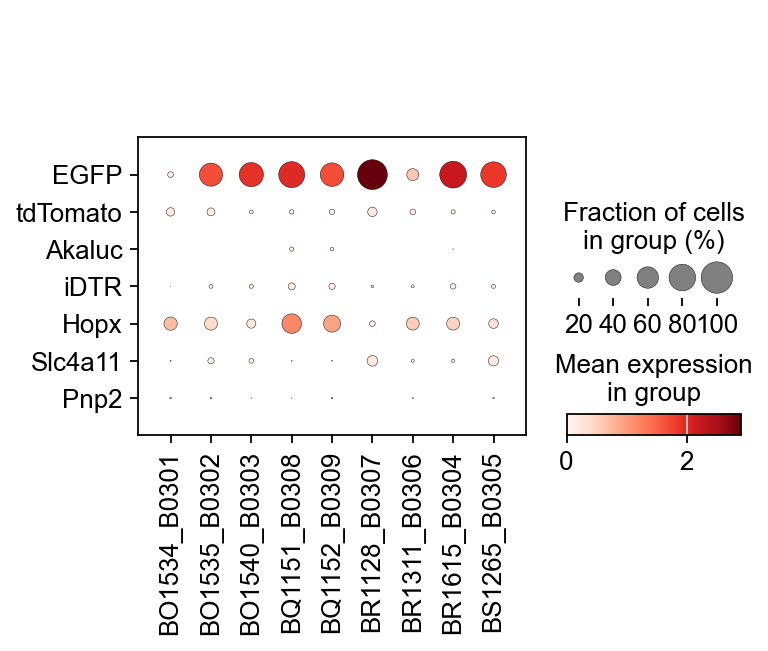

In [66]:
sc.pl.dotplot(adata, ['EGFP','tdTomato','Akaluc','iDTR','Hopx','Slc4a11','Pnp2'],'Classification',swap_axes=True)

In [67]:
adata.obs.Classification.value_counts()

Classification
BO1534_B0301    2745
BQ1151_B0308     632
BQ1152_B0309     590
BR1311_B0306     335
BS1265_B0305     233
BO1540_B0303     203
BR1615_B0304     193
BO1535_B0302     113
BR1128_B0307      30
Name: count, dtype: int64

In [68]:
# BO1534 is carrier (immune-live+); eventually will need to exclude.
# BR1311 is too high for what should have been sorted and not EGFP enriched; also exclude

## Define scoring Functions

In [69]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('./clusters/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [70]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=500,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [71]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1888 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1492 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1489 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1686 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1687 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Rps2-ps6', 'Fam46c', 'Gm6139', 'Gm10179', 'Gm5864'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1995 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added

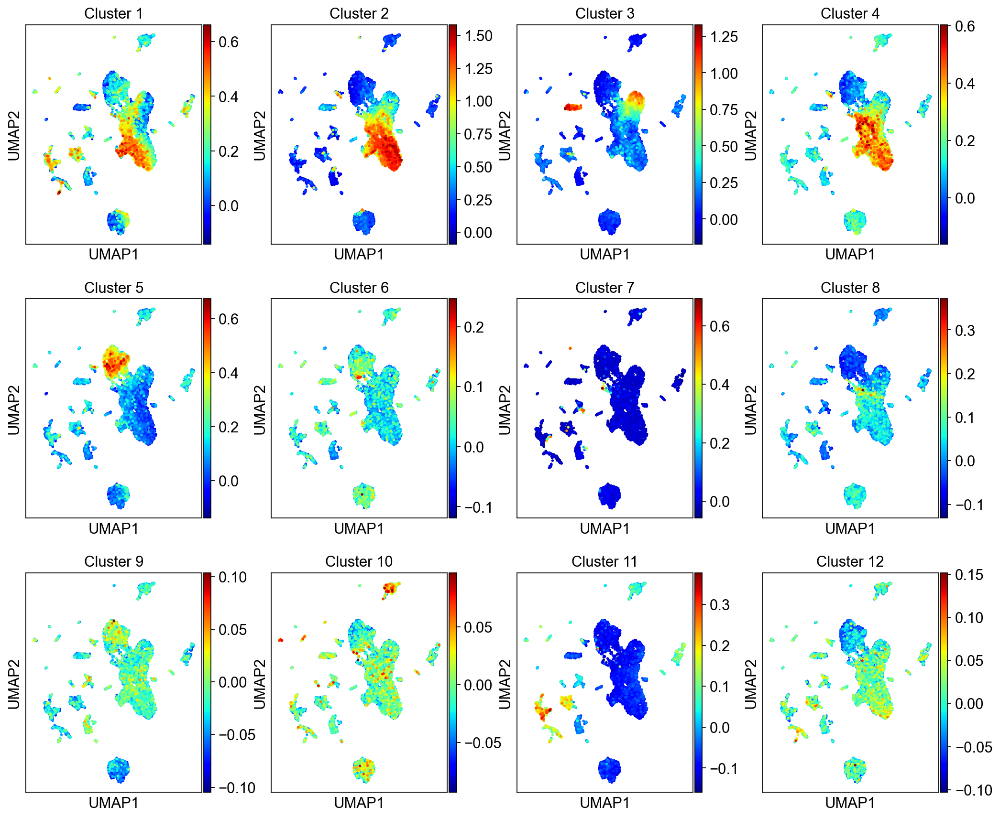

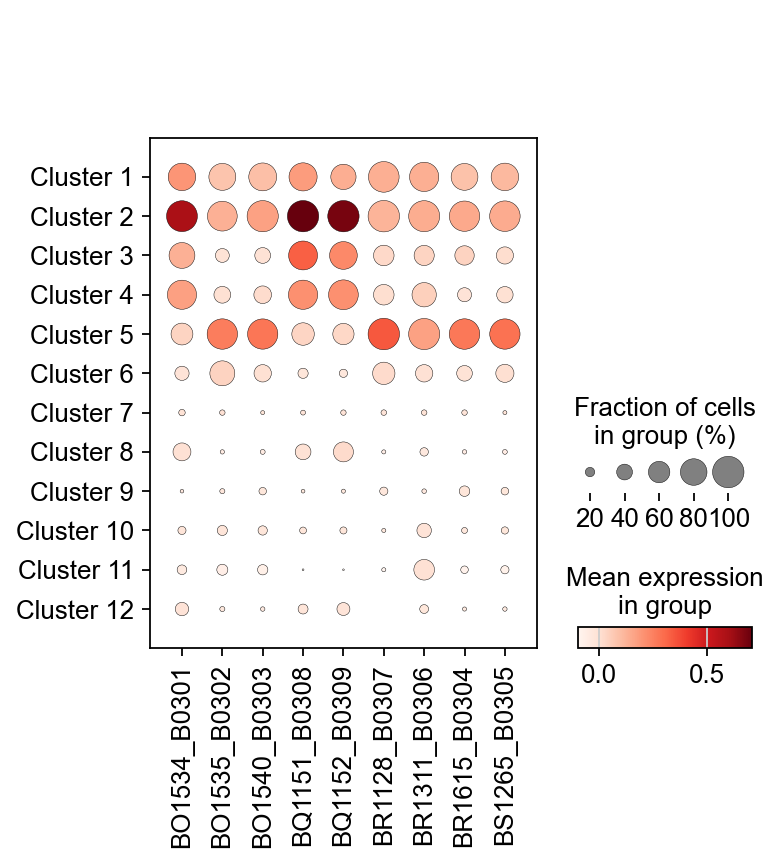

In [72]:
scoreAndPlot(adata, numgenes=100)

## Clustering the neighborhood graph

As with Seurat and many other frameworks, we recommend the Leiden graph-clustering method (community detection based on optimizing modularity) by [Traag *et al.* (2018)](https://scanpy.readthedocs.io/en/latest/references.html#traag18). Note that Leiden clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.

In [73]:
sc.tl.leiden(adata, resolution=0.15)

running Leiden clustering


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/2358901094.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.15)


    finished: found 18 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


Plot the clusters, which agree quite well with the result of Seurat.

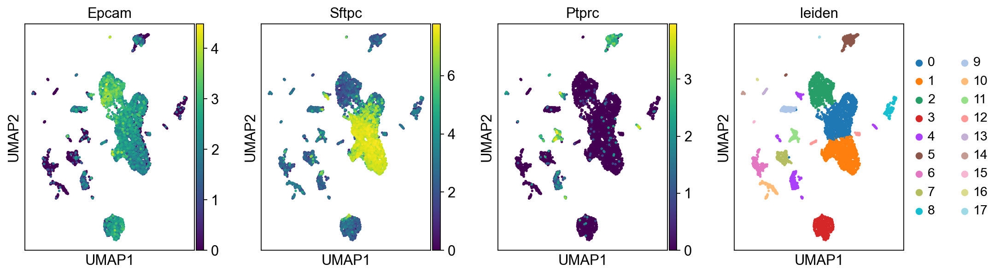

(None,)

In [74]:
sc.pl.umap(adata, color=['Epcam', 'Sftpc', # Tumor cells
                         'Ptprc','leiden']), #immune
                         #  'Cd4', 'Cd8a', #T cell #'Cd3e',
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

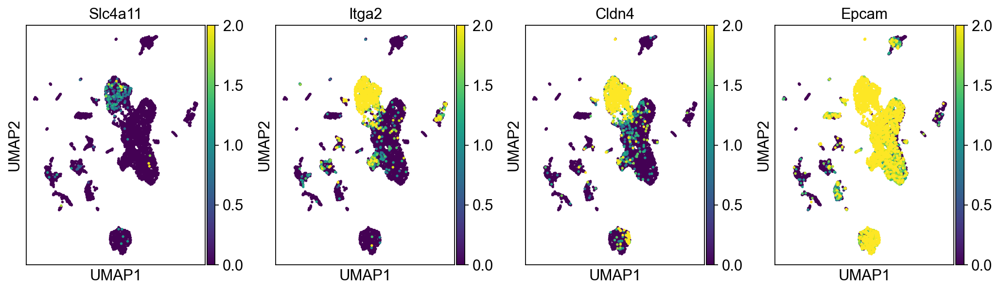

In [75]:
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4','Epcam'], vmax=2) #'Tigit', 

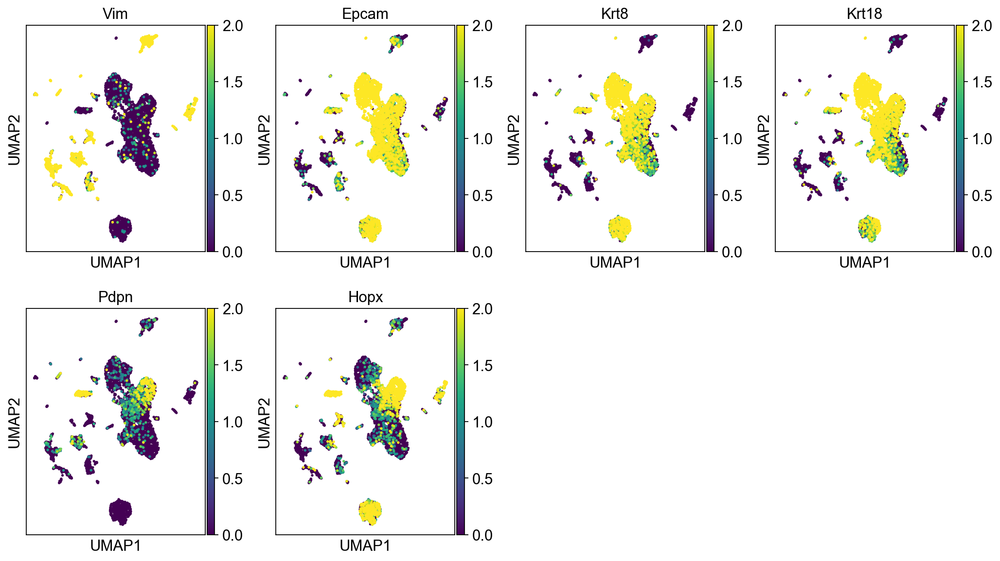

In [76]:
sc.pl.umap(adata, color=['Vim', 'Epcam', 'Krt8', 'Krt18', 'Pdpn', 'Hopx'], vmax=2) #'Pecam1',

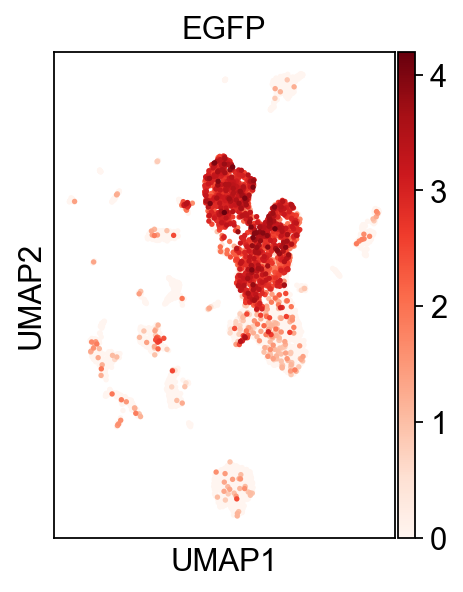

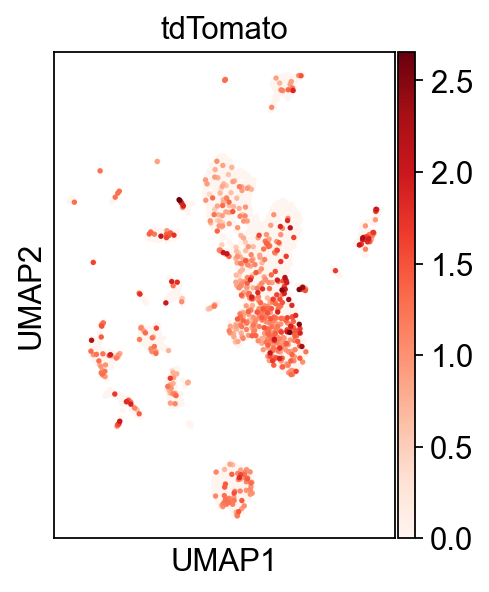

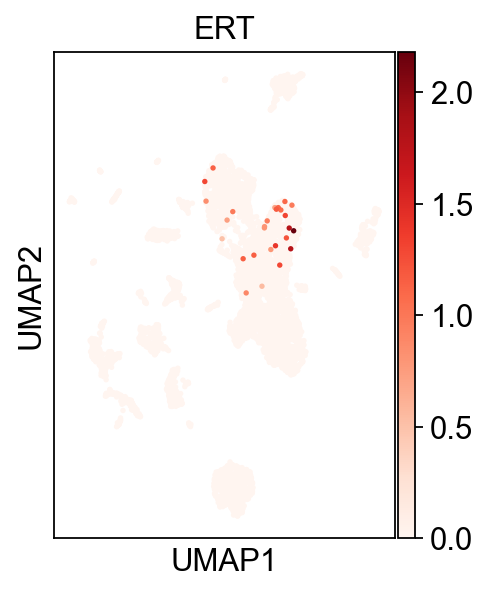

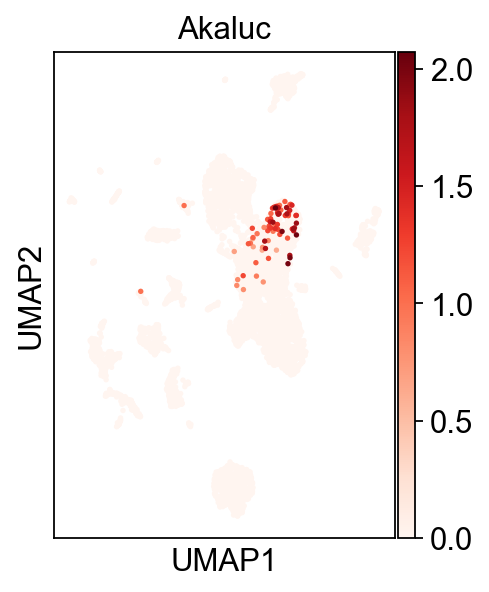

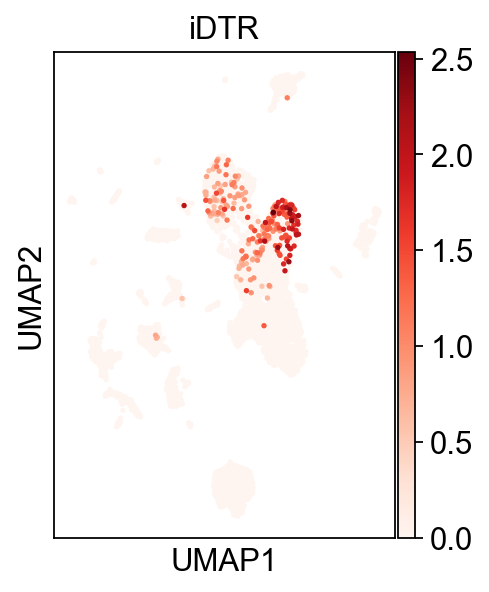

In [77]:
sc.pl.umap(adata, color=['EGFP'], cmap='Reds')
sc.pl.umap(adata, color=['tdTomato'], cmap='Reds')
sc.pl.umap(adata, color=['ERT'], cmap='Reds')
sc.pl.umap(adata, color=['Akaluc'], cmap='Reds')
sc.pl.umap(adata, color=['iDTR'], cmap='Reds')

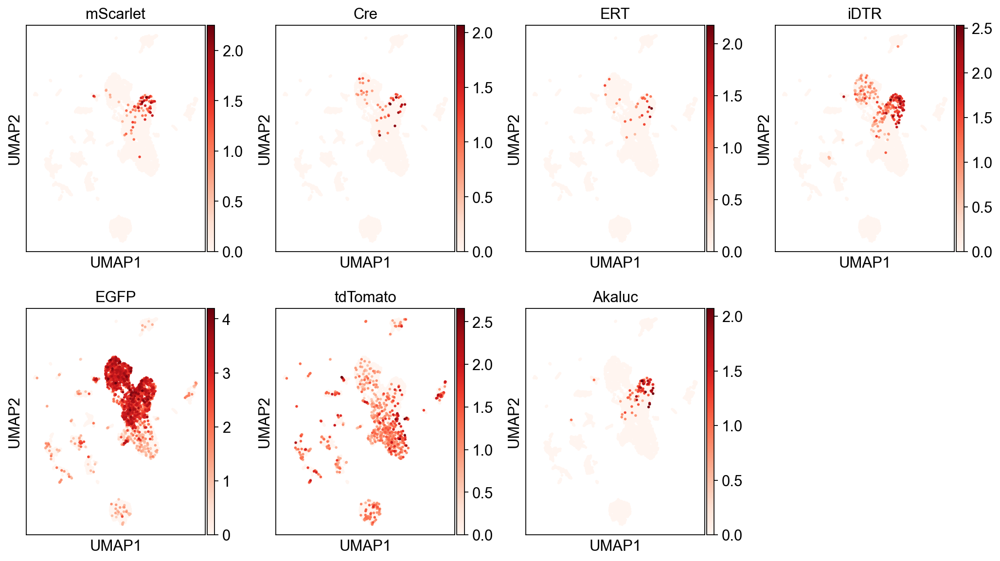

In [78]:
sc.pl.umap(adata, color=["mScarlet", "Cre", "ERT",'iDTR','EGFP','tdTomato','Akaluc'], cmap='Reds') #'mKate2'

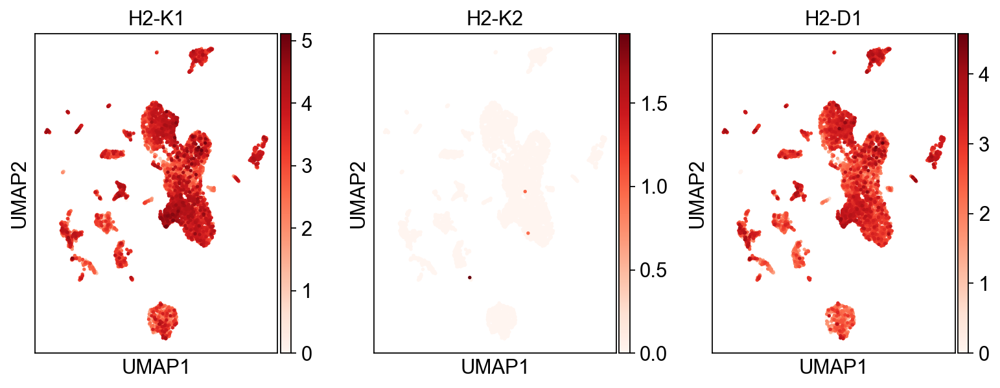

In [79]:
sc.pl.umap(adata, color=["H2-K1", "H2-K2", "H2-D1"], cmap='Reds') #'mKate2'

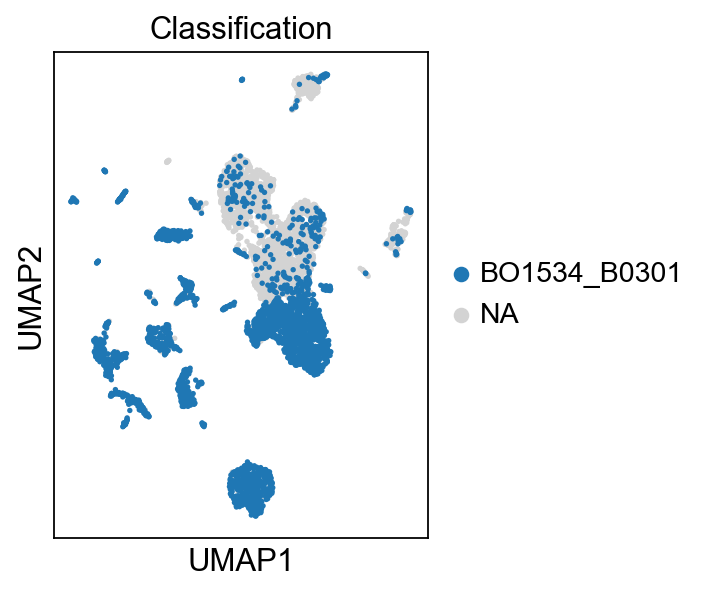

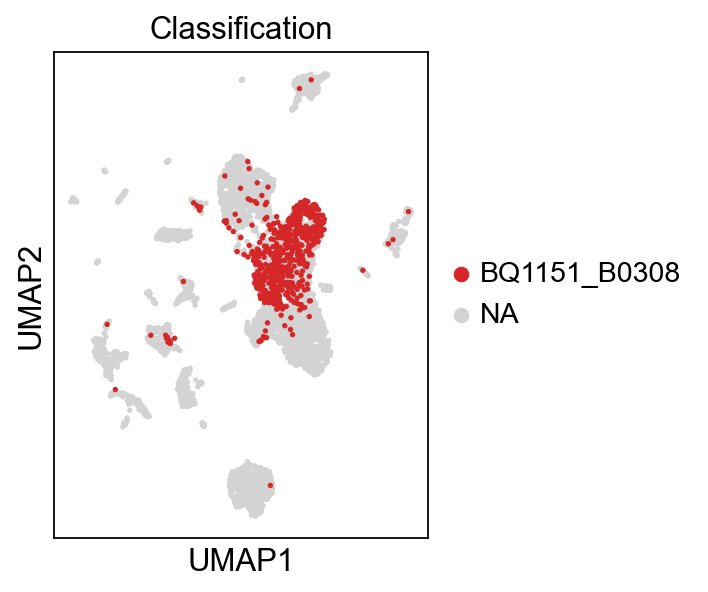

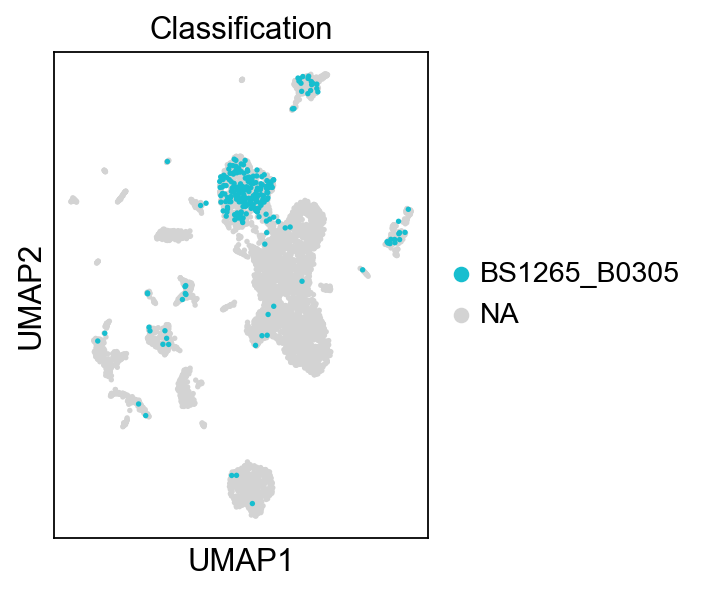

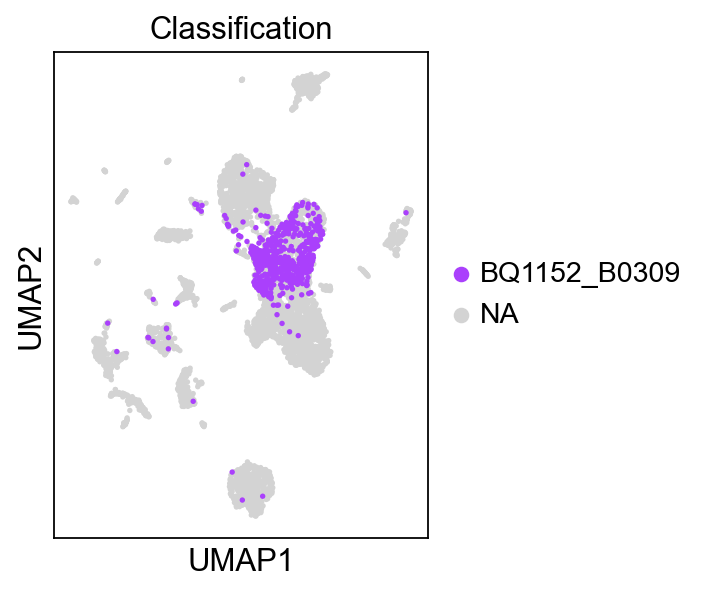

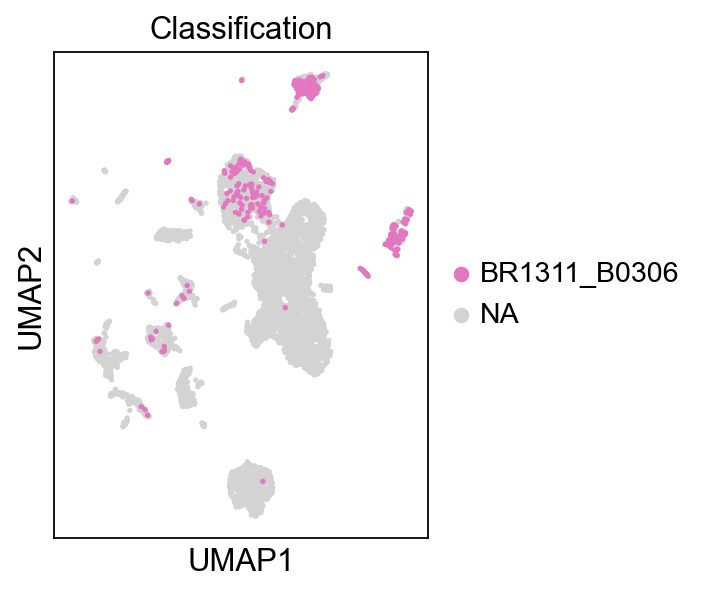

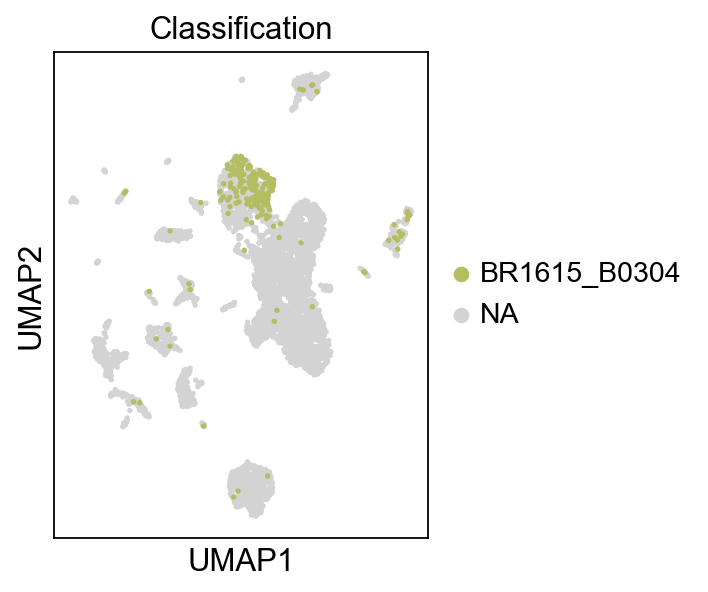

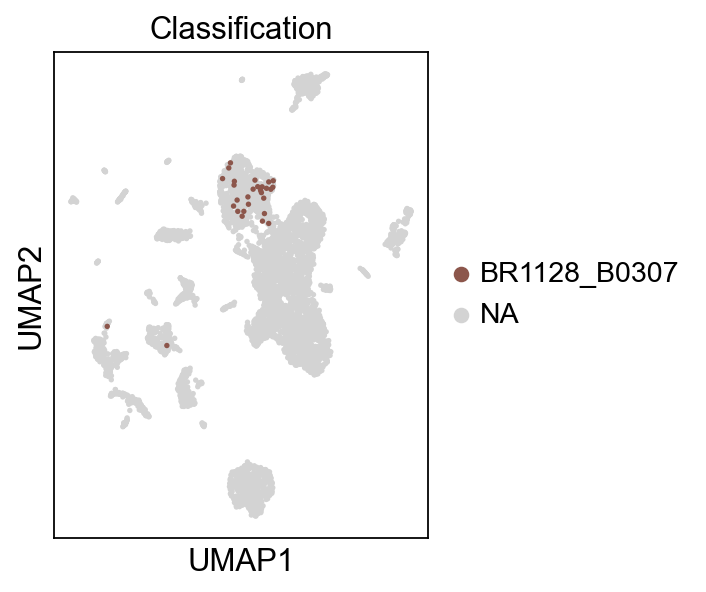

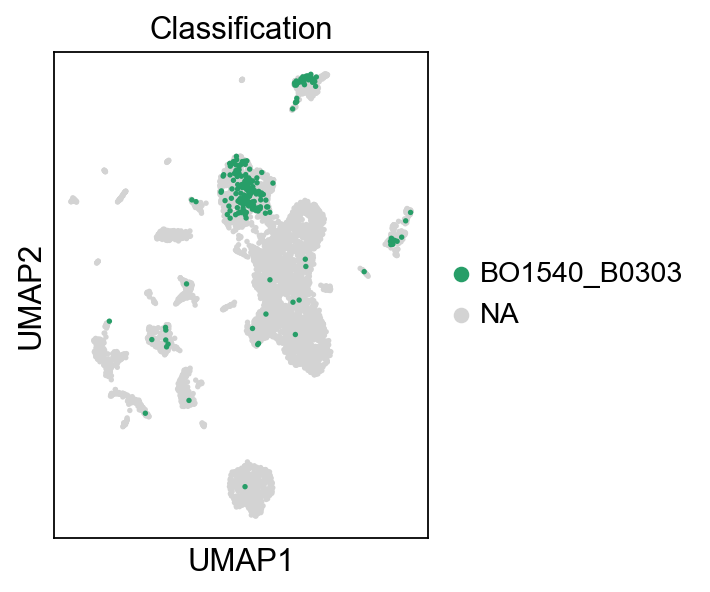

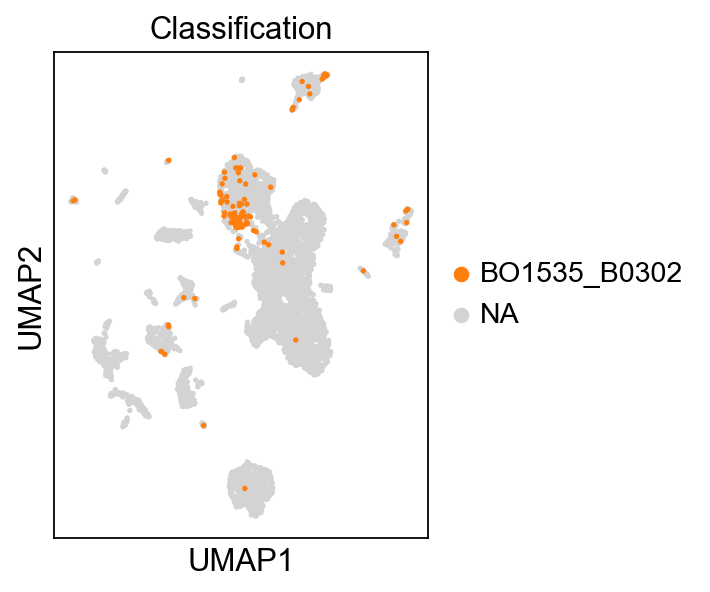

In [80]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

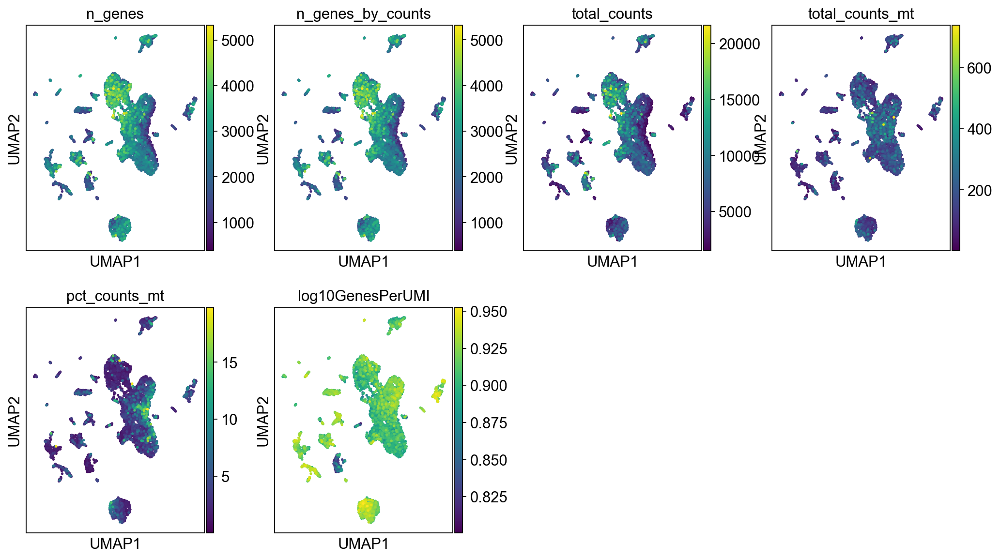

In [81]:
sc.pl.umap(adata,color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

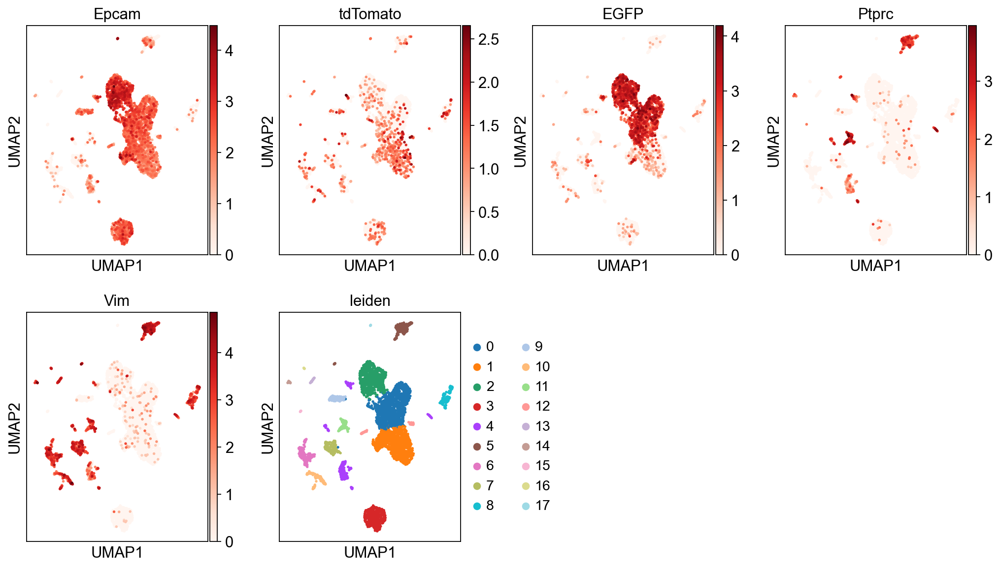

In [82]:
sc.pl.umap(adata, color=['Epcam','tdTomato','EGFP','Ptprc','Vim','leiden',],cmap="Reds")

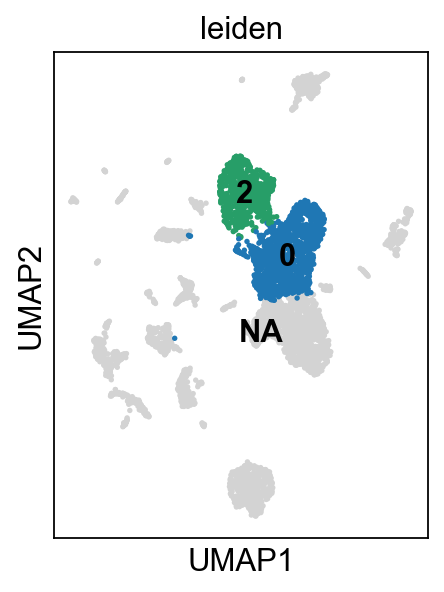

In [83]:
sc.pl.umap(adata, color=['leiden'], groups=['0','2'],legend_loc='on data')

## Select Tumor Cells

In [84]:
# Select only those subset of cells that are useful
adata2 = sc.read('write/allmice-IGO17402.h5ad')
adata = adata2[adata.obs['leiden'].isin(['0','2']),:] # keep tumor cells
adata = adata[~adata.obs.Classification.isin(['BO1534_B0301','BR1311_B0306']),:] #exclude non EGFP sorted cells or questionable sorts
del adata2

In [85]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/2000007.py:2: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['log1p'] = {}


In [86]:
sc.pp.highly_variable_genes(adata)#, batch_key='Classification')

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [87]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tagBFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/114365792.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/1143657

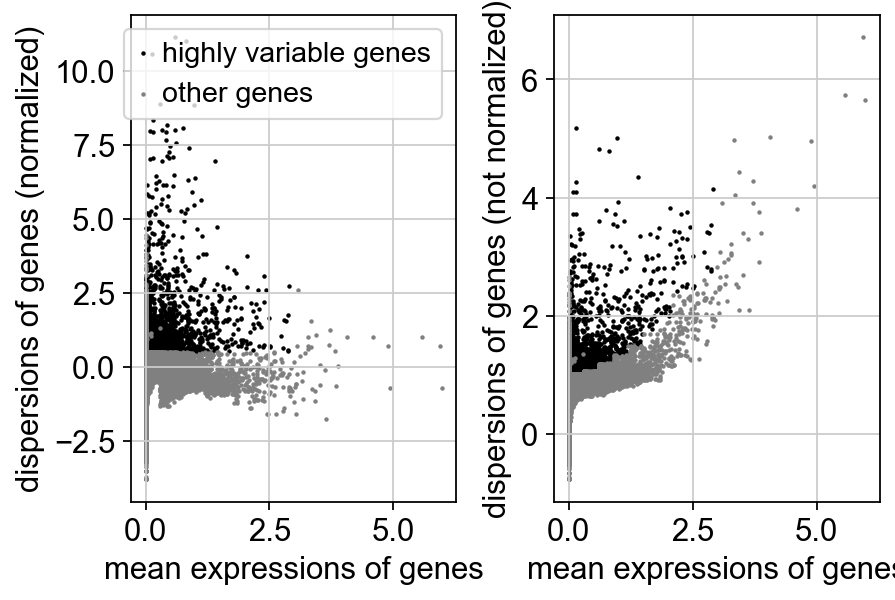

In [88]:
sc.pl.highly_variable_genes(adata)

In [89]:
adata.raw = adata

In [90]:
adata.write('write/allmice-tumor-IGO17402.h5ad', compression='gzip')
#adata = sc.read('write/allmice-tumor.h5ad')

## Now rerun algorithm

In [91]:
adata.obs.Classification.value_counts()

Classification
BQ1152_B0309    556
BQ1151_B0308    553
BS1265_B0305    174
BR1615_B0304    153
BO1540_B0303    137
BO1535_B0302     79
BR1128_B0307     28
Name: count, dtype: int64

In [92]:
sc.pp.scale(adata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


## Principal component analysis

In [93]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:00)


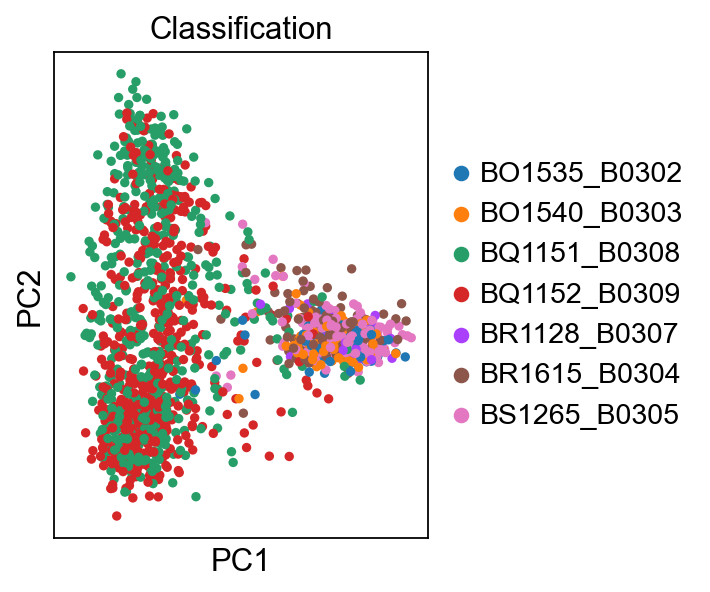

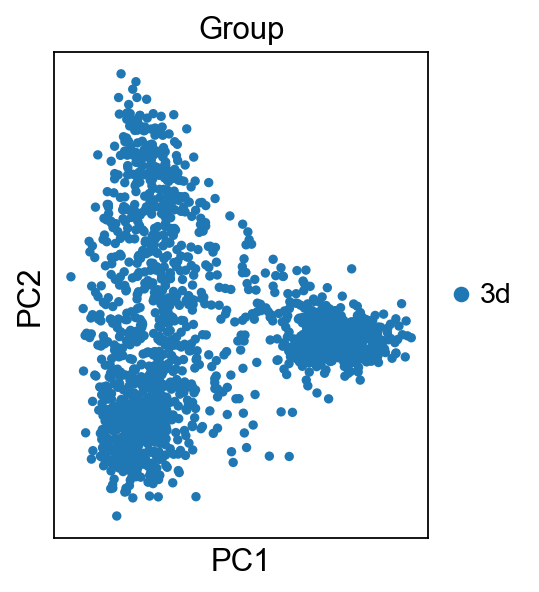

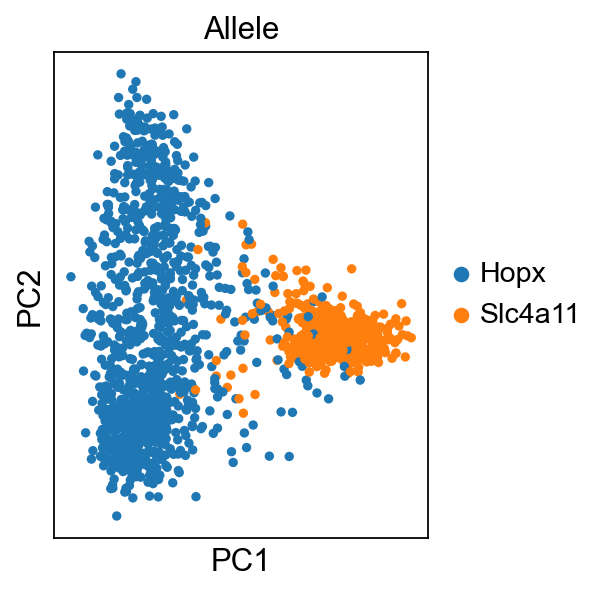

In [94]:
#sc.pl.pca(adata, color='leiden',dimensions=[(0,1)])
sc.pl.pca(adata, color='Classification',dimensions=[(0,1)])
sc.pl.pca(adata, color='Group',dimensions=[(0,1)])
sc.pl.pca(adata, color='Allele',dimensions=[(0,1)])

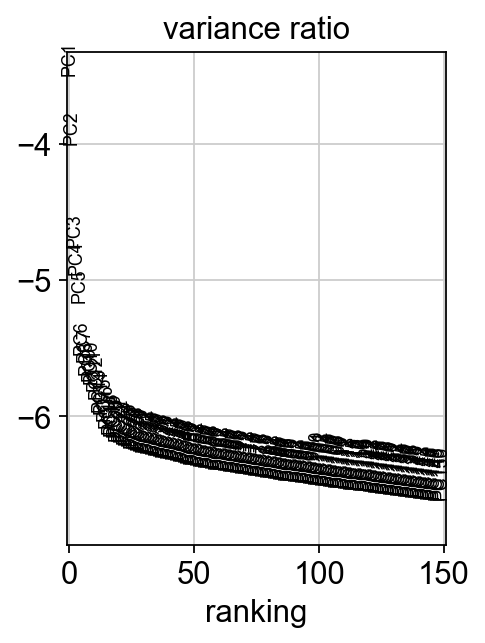

In [95]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

In [96]:
adata.write(results_file, compression='gzip')

In [97]:
adata.obs.Classification.value_counts()

Classification
BQ1152_B0309    556
BQ1151_B0308    553
BS1265_B0305    174
BR1615_B0304    153
BO1540_B0303    137
BO1535_B0302     79
BR1128_B0307     28
Name: count, dtype: int64

## Computing the neighborhood graph

In [98]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=20)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


## Embedding the neighborhood graph

In [99]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:02)


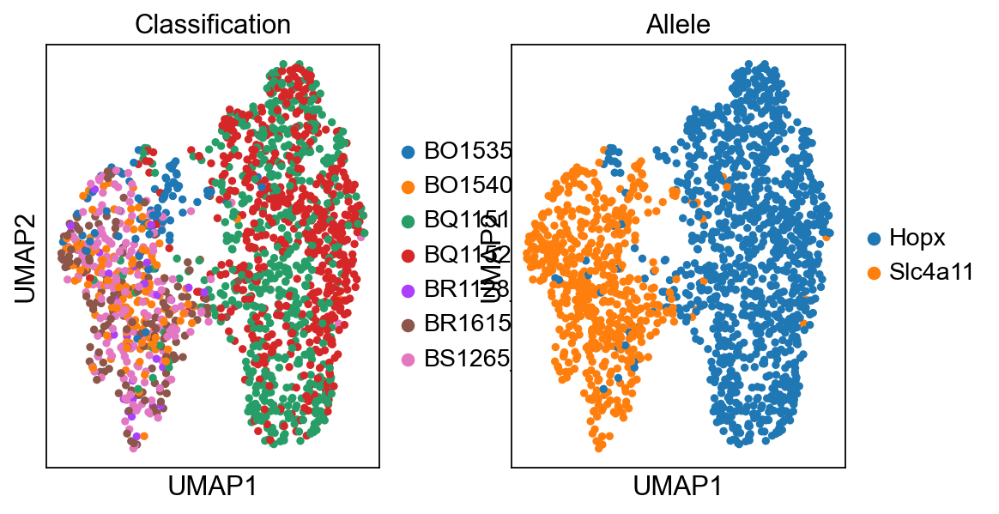

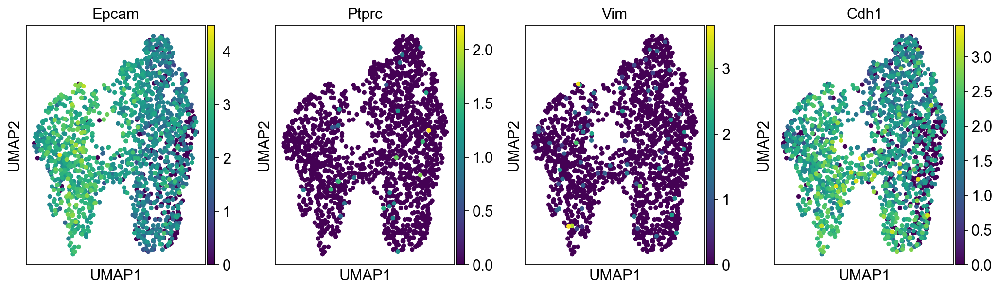

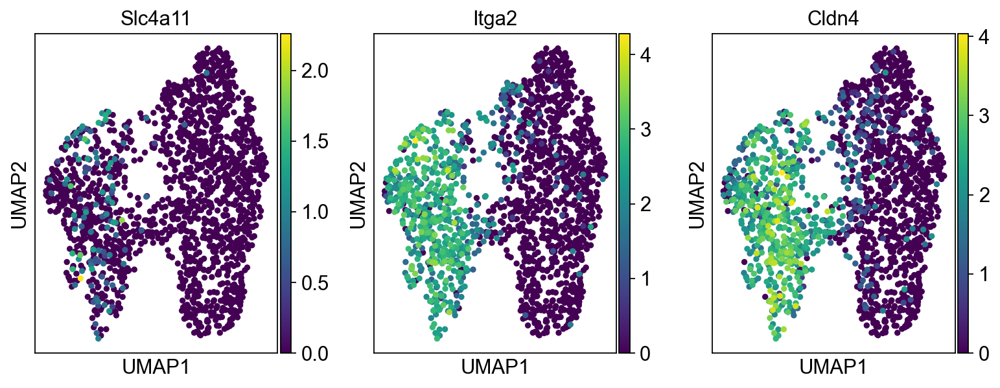

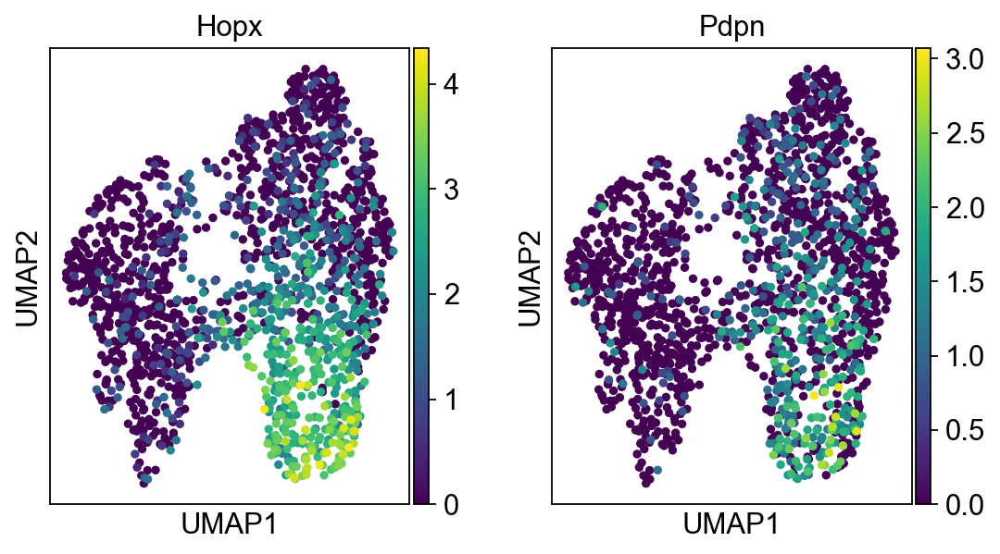

In [100]:
sc.pl.umap(adata, color=['Classification', 'Allele'])
#sc.pl.umap(adata, color=['Porcn', 'Lgr5', 'Lgr6','Axin2']) #LGR5 not found #
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',]) #CDH2 not found #'Cdh2'
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])
#sc.pl.umap(adata, color=['Cd81', 'Cd19'])
#sc.pl.umap(adata, color=['Trp53','Meg3'], vmax=5)

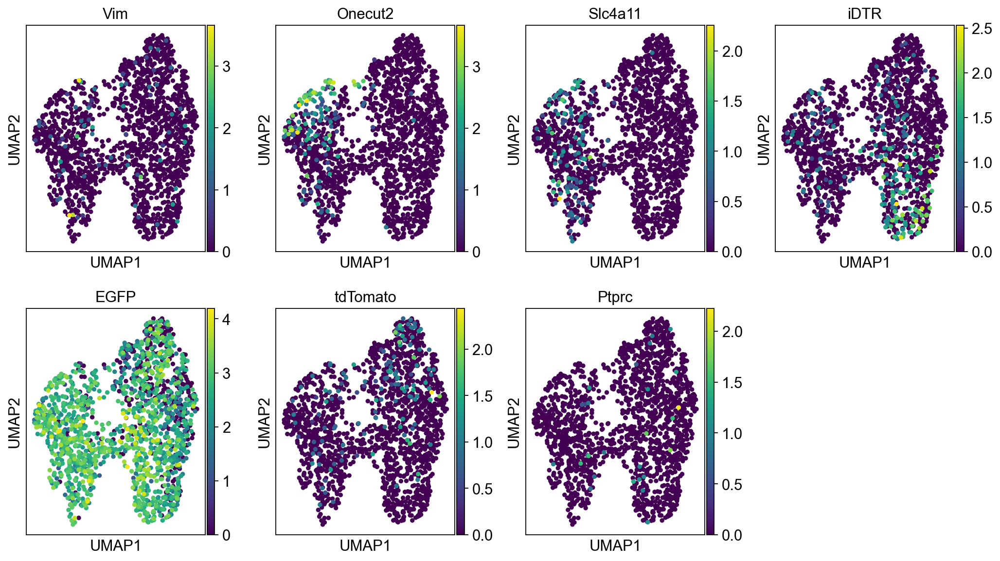

In [101]:
sc.pl.umap(adata, color=['Vim', 'Onecut2', 'Slc4a11', 'iDTR', 'EGFP','tdTomato','Ptprc']) #'Sox11', 

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1885 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1388 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1592 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1594 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    1688 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Rps2-ps6', 'Fam46c', 'Gm6139', 'Gm10179', 'Gm5864'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1893 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added

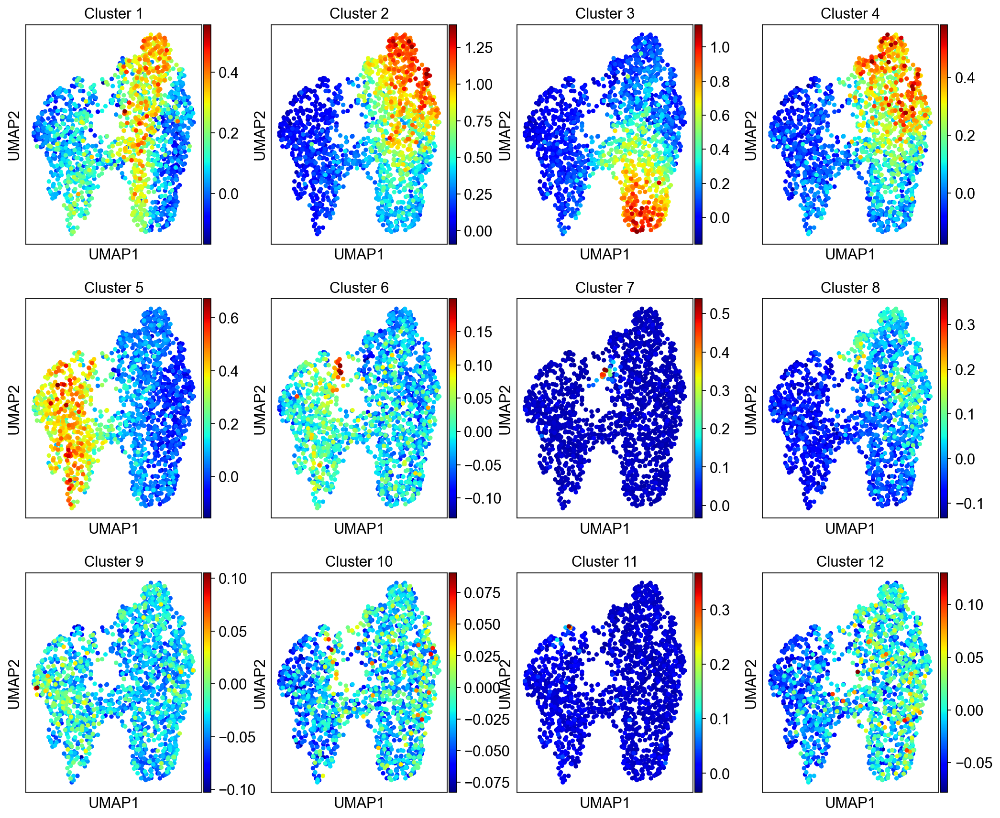

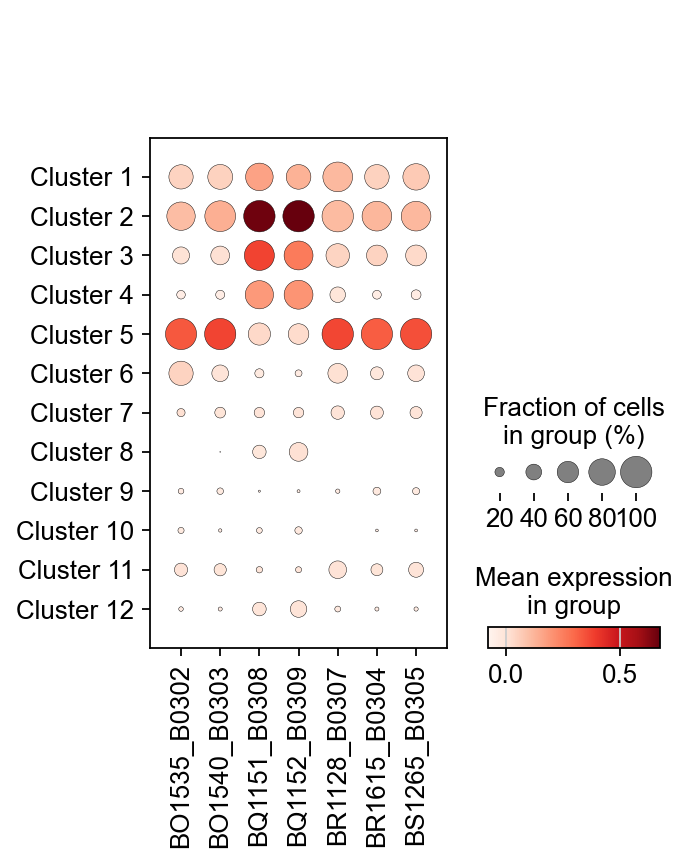

In [102]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata, numgenes=100)

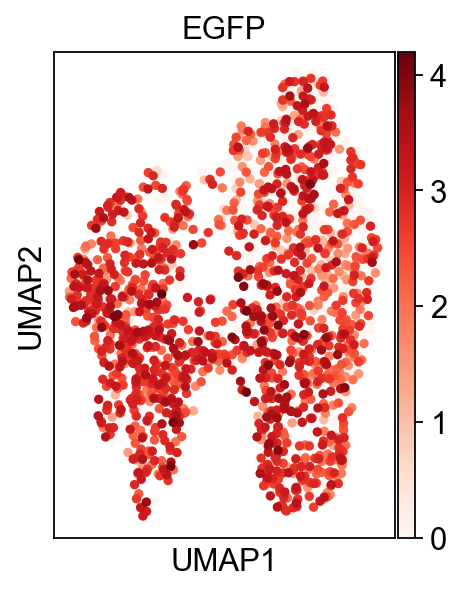

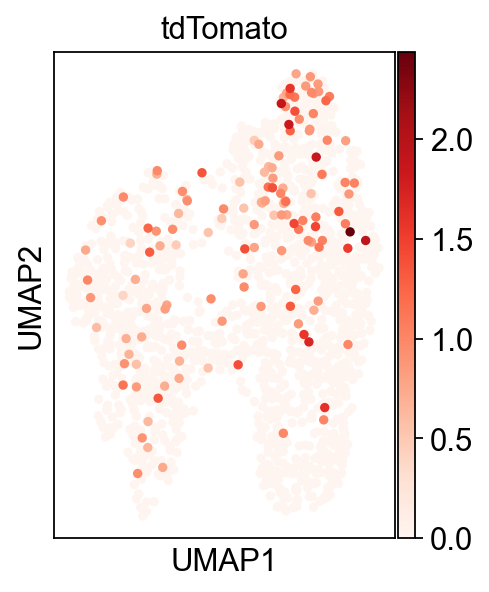

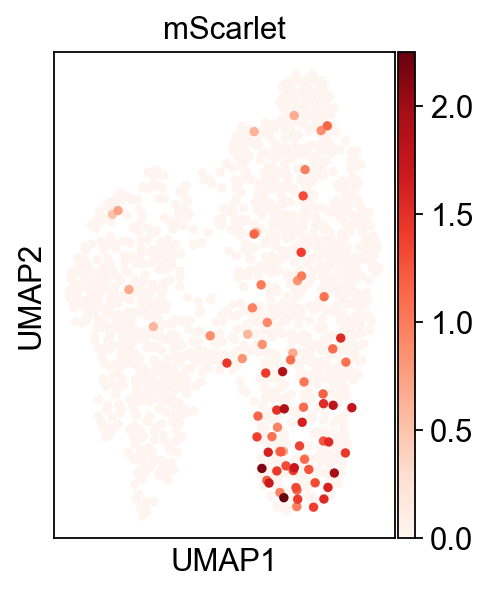

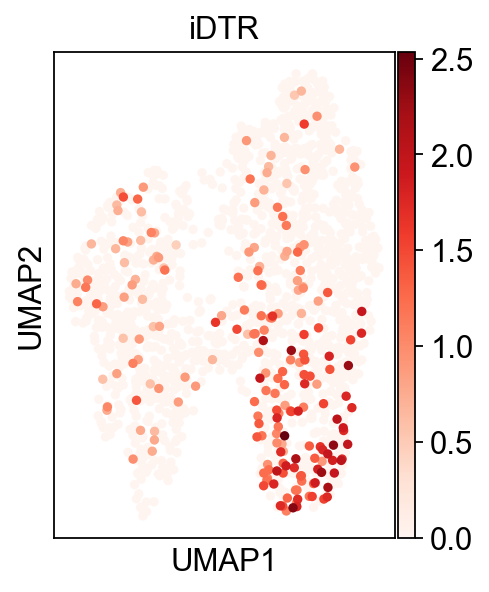

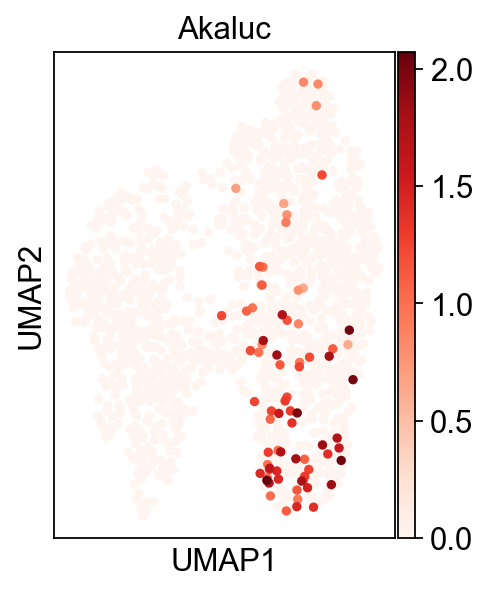

In [103]:
sc.pl.umap(adata, color=['EGFP'], cmap='Reds')
sc.pl.umap(adata, color=['tdTomato'], cmap='Reds')
sc.pl.umap(adata, color=['mScarlet'], cmap='Reds')
sc.pl.umap(adata, color=['iDTR'], cmap='Reds')
sc.pl.umap(adata, color=['Akaluc'], cmap='Reds')

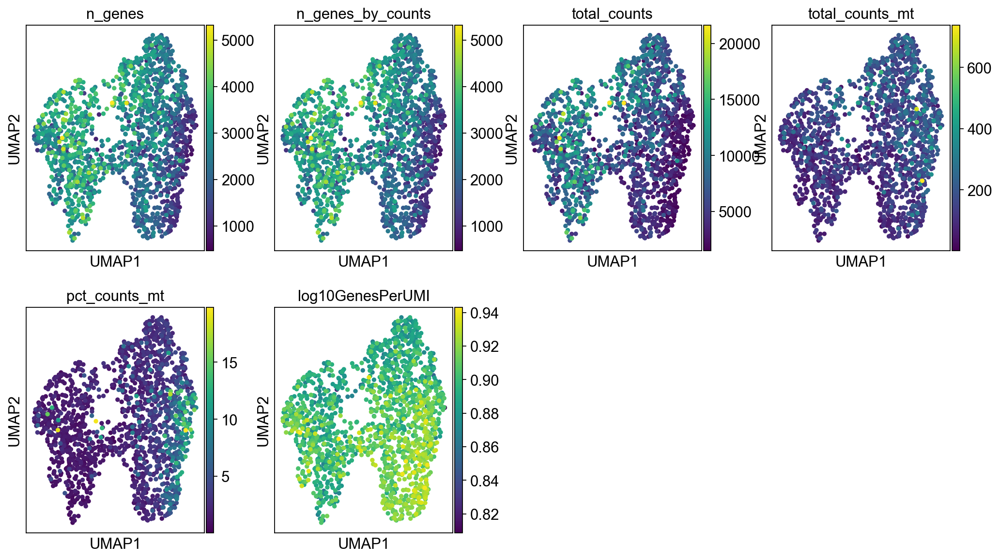

In [104]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

In [105]:
adata.obs.Classification.value_counts(sort=False)

Classification
BO1535_B0302     79
BO1540_B0303    137
BQ1151_B0308    553
BQ1152_B0309    556
BR1128_B0307     28
BR1615_B0304    153
BS1265_B0305    174
Name: count, dtype: int64

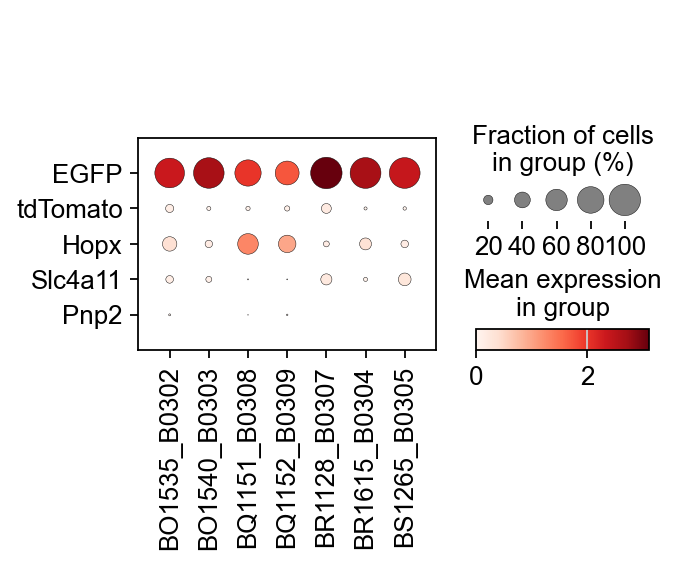

In [106]:
sc.pl.dotplot(adata, ['EGFP','tdTomato','Hopx','Slc4a11','Pnp2'],'Classification',swap_axes=True)

In [107]:
sc.tl.embedding_density(adata, basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


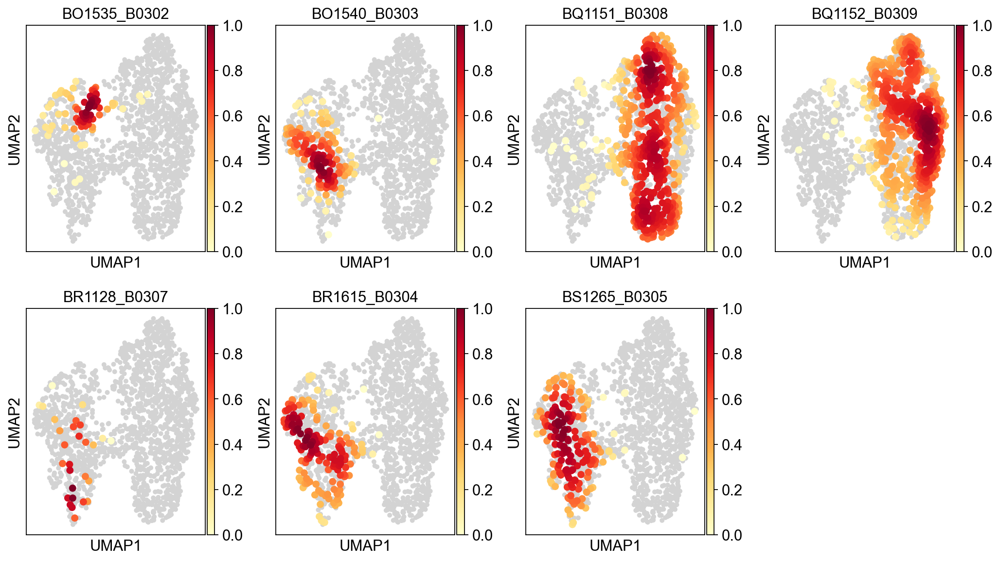

In [108]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Classification')

In [109]:
sc.tl.embedding_density(adata, basis='umap', groupby='Allele')

computing density on 'umap'
--> added
    'umap_density_Allele', densities (adata.obs)
    'umap_density_Allele_params', parameter (adata.uns)


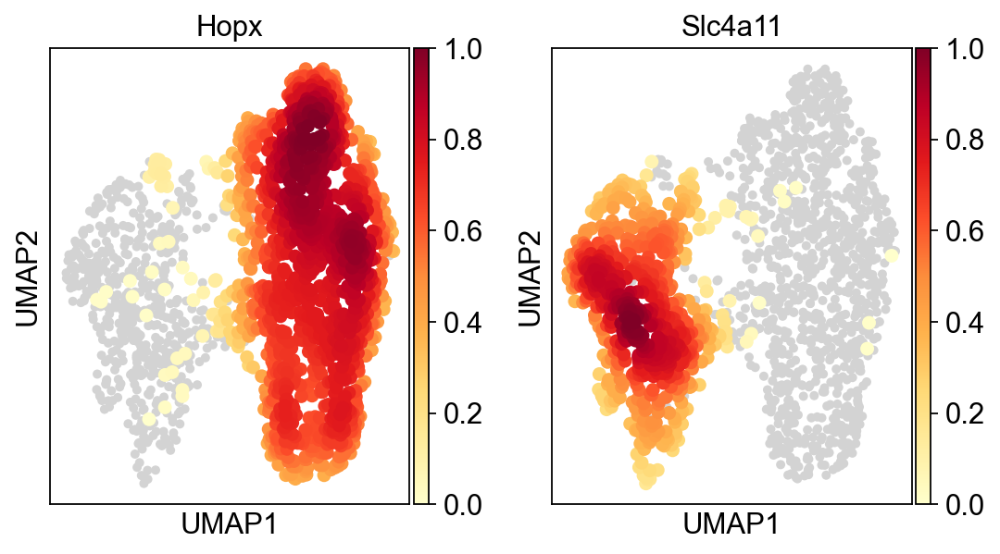

In [110]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Allele')

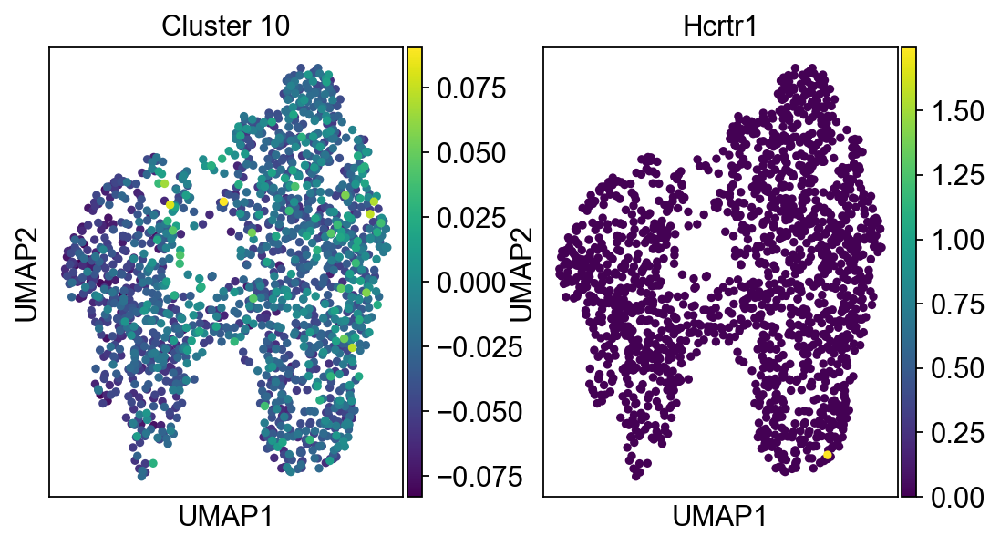

In [111]:
sc.pl.umap(adata, color=['Cluster 10','Hcrtr1'])

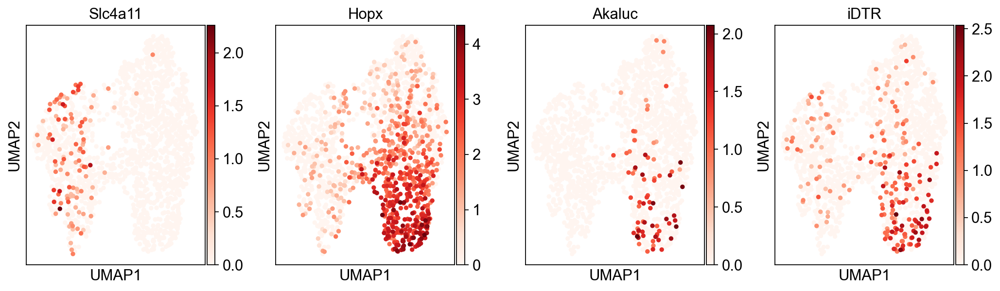

In [112]:
sc.pl.umap(adata, color=['Slc4a11','Hopx','Akaluc','iDTR'],cmap='Reds')

## Clustering the neighborhood graph

running Leiden clustering
    finished: found 4 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


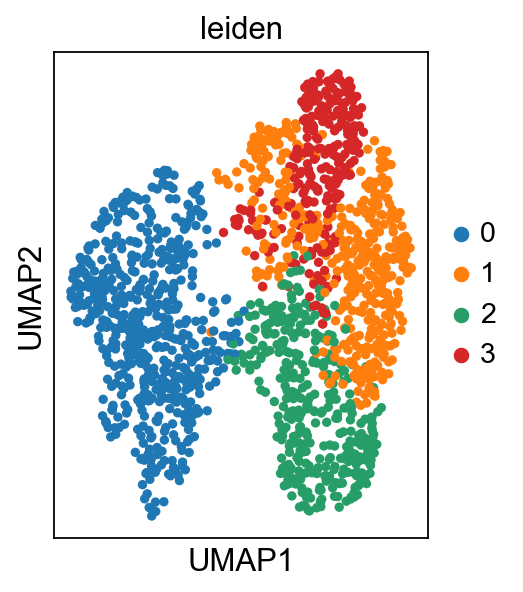

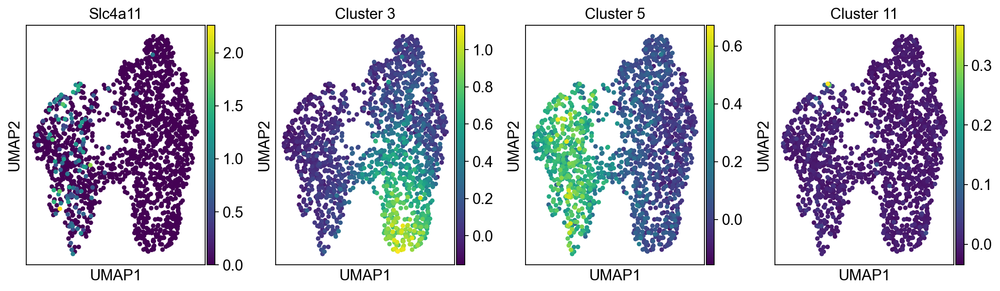

In [113]:
sc.tl.leiden(adata, resolution=.3)
sc.pl.umap(adata, color=['leiden'])
sc.pl.umap(adata, color=['Slc4a11','Cluster 3','Cluster 5','Cluster 11'])

In [114]:
adata.obs[['Classification']].value_counts(sort=False)

Classification
BO1535_B0302       79
BO1540_B0303      137
BQ1151_B0308      553
BQ1152_B0309      556
BR1128_B0307       28
BR1615_B0304      153
BS1265_B0305      174
Name: count, dtype: int64

## Logistic Regression

In [115]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('./genes.joblib')

In [116]:
adata_log = adata[:,adata.var.index.isin(names)]

In [117]:
adata_names = [x for x in adata_log.var.index]

In [118]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [119]:
smartseq = anndata.read('./smartseq.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [120]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [121]:
names = [x for x in names_adata.var.index]

In [122]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='saga')
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [123]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[136,   8,   3,   0,   2,   1,   1,   0,   1,   0,   0,   0],
       [  6,  69,   0,   3,   0,   0,   0,   0,   0,   2,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  1,   2,   0,  61,   0,   0,   0,  10,   2,   1,   0,   0],
       [  0,   0,   4,   0, 177,   2,   0,   3,   1,   1,   0,   1],
       [  0,   0,   0,   0,   0,  34,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  13,   0,   2,   0,   0,   0],
       [  0,   0,   0,   2,   1,   0,   1, 134,   2,   3,   0,   1],
       [  0,   0,   0,   0,   1,   0,   0,   2,  38,   1,   0,   0],
       [  0,   0,   1,   1,   0,   0,   0,   3,   0,  57,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   1,   0,  40]])

Text(0.5, 295.64444444444445, 'Predicted label')

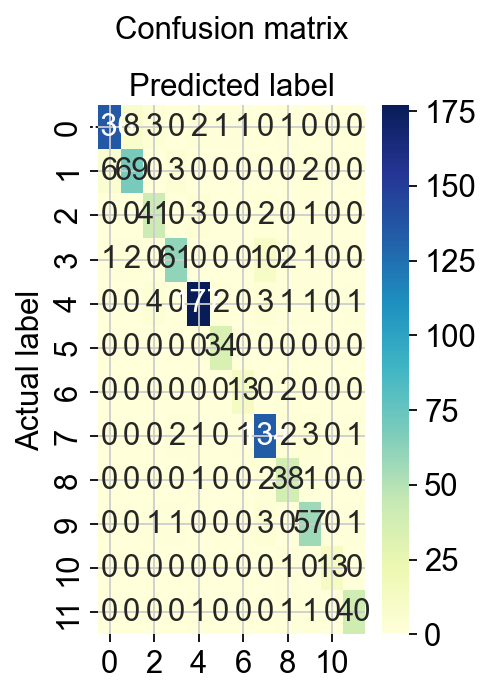

In [124]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [125]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.95      0.89      0.92       152
           2       0.87      0.86      0.87        80
           3       0.84      0.87      0.85        47
           4       0.91      0.79      0.85        77
           5       0.96      0.94      0.95       189
           6       0.92      1.00      0.96        34
           7       0.87      0.87      0.87        15
           8       0.87      0.93      0.90       144
           9       0.79      0.90      0.84        42
          10       0.85      0.90      0.88        63
          11       1.00      0.93      0.96        14
          12       0.93      0.93      0.93        43

    accuracy                           0.90       900
   macro avg       0.90      0.90      0.90       900
weighted avg       0.91      0.90      0.90       900



In [126]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [127]:
label_binarizer.classes_

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12])

In [128]:
class_of_interest = 5
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

4

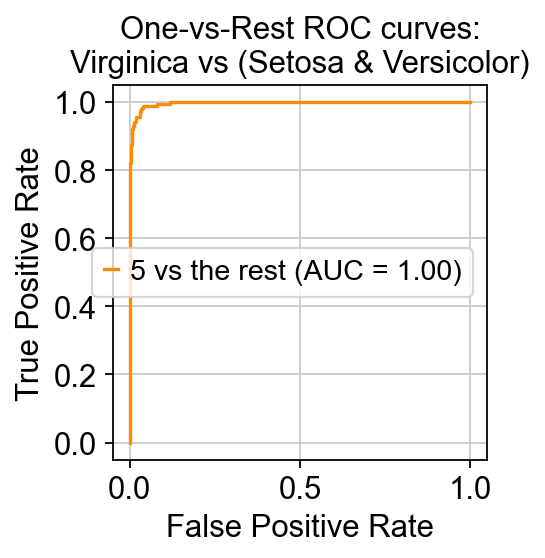

In [129]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [130]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [131]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [132]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,3,3,9.728060e-09,7.678347e-05,6.407038e-01,2.401747e-02,2.721231e-06,1.090835e-04,2.859791e-04,3.320183e-01,2.000982e-05,1.372859e-05,7.192493e-05,2.680171e-03,0.640704,1
1,1,1,9.999999e-01,4.153593e-08,3.256413e-11,8.475207e-10,4.679325e-09,3.199456e-08,5.722019e-08,1.406687e-13,2.280055e-12,1.587339e-12,1.476768e-09,4.756241e-11,1.000000,1
2,8,8,9.116404e-07,3.573061e-05,1.677670e-04,2.842191e-05,3.579217e-05,4.236107e-05,2.290458e-04,9.943328e-01,3.581119e-03,1.311722e-03,2.081113e-04,2.625401e-05,0.994333,1
3,10,10,4.043251e-04,1.015233e-02,4.638135e-04,3.131411e-05,2.968363e-01,3.221743e-03,2.622939e-04,1.233994e-04,7.208668e-04,6.870053e-01,2.892553e-04,4.890334e-04,0.687005,1
4,8,8,3.758918e-07,1.007578e-06,3.357589e-07,6.484226e-06,2.189178e-06,5.718559e-06,9.940719e-05,9.831065e-01,1.672558e-02,1.083323e-05,7.408556e-06,3.412883e-05,0.983107,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,5,5,2.990056e-03,5.286009e-07,2.624829e-05,7.660793e-05,9.676826e-01,1.974074e-02,2.908516e-04,3.165018e-04,1.617540e-03,7.038635e-03,1.995152e-04,2.021283e-05,0.967683,1
896,5,5,1.113496e-07,4.018655e-04,1.086611e-05,9.009453e-05,9.994422e-01,1.187914e-05,6.112693e-06,2.488209e-11,5.948485e-07,1.059542e-07,3.339300e-05,2.768817e-06,0.999442,1
897,8,8,9.703340e-07,6.496429e-06,6.812599e-06,6.502904e-04,2.547009e-09,2.525828e-06,3.743992e-05,9.802287e-01,1.892129e-02,1.264477e-04,1.068650e-05,8.355512e-06,0.980229,1
898,5,5,2.656060e-10,1.973958e-07,4.364672e-05,2.300954e-09,9.999521e-01,1.032314e-07,1.111676e-06,1.727846e-07,9.035589e-08,6.221294e-08,2.029108e-06,5.050211e-07,0.999952,1


In [133]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.24-0.82,0.236240,0.820690,0.620155
1,0.82-0.98,0.820690,0.977710,0.820312
2,0.98-1.0,0.977710,0.996380,0.914729
3,1.0-1.0,0.998926,0.999828,0.992218


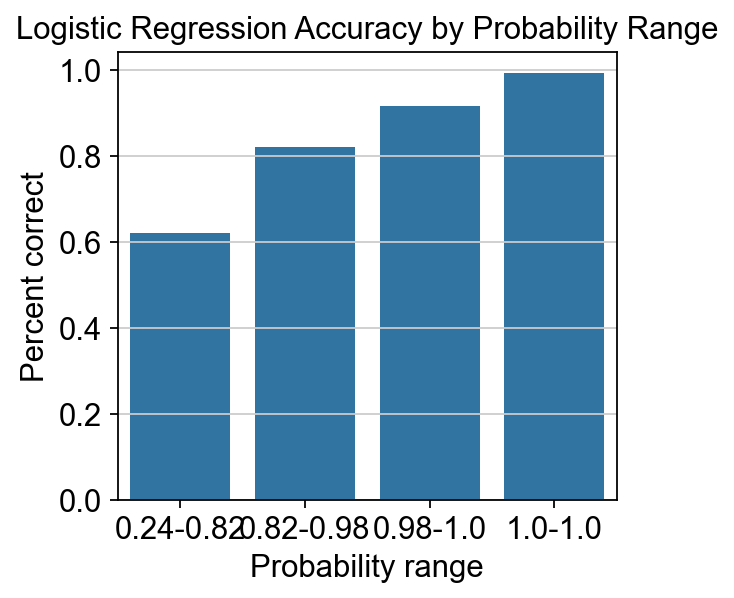

In [134]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [135]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

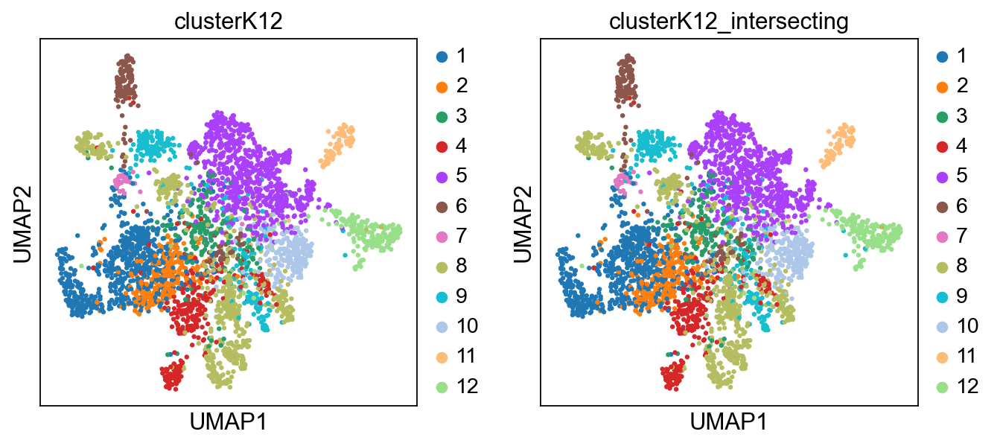

In [136]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [137]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [138]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/3184290090.py:2: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])


0.0

In [139]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,2.810108e-09,2.978439e-07,1.175299e-07,3.554325e-10,2.599431e-09,1.304893e-10,1.546529e-08,1.536072e-15,1.323834e-09,1.211142e-11,9.999996e-01,4.095842e-09,1.000000
1,12,4.885258e-10,7.753307e-10,4.936624e-10,1.247971e-08,2.727824e-13,7.066558e-07,1.003612e-08,1.229707e-09,3.975734e-07,1.092065e-07,3.479347e-09,9.999988e-01,0.999999
2,5,7.373612e-04,5.549014e-08,1.318916e-03,2.045324e-07,9.978464e-01,2.032127e-05,2.047239e-05,1.462967e-07,3.137914e-07,2.223007e-05,1.164981e-05,2.197466e-05,0.997846
3,10,9.682597e-06,9.288880e-06,5.007688e-06,3.392429e-03,6.958916e-08,1.398699e-05,3.331778e-06,6.618068e-04,1.256817e-05,9.958741e-01,3.486395e-06,1.424972e-05,0.995874
4,1,9.999995e-01,8.889535e-10,1.251248e-07,3.385624e-07,7.223078e-09,1.329445e-08,8.223603e-09,1.006360e-10,2.204537e-13,1.861213e-09,5.330765e-08,1.359323e-09,0.999999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,8,4.551185e-08,9.149925e-06,1.449569e-07,2.123443e-07,3.629045e-09,2.300268e-08,4.060427e-07,9.997836e-01,2.061750e-04,8.011958e-08,1.070584e-07,1.075797e-08,0.999784
3596,9,1.343931e-10,6.466084e-08,2.214109e-08,6.099157e-08,7.059350e-09,8.746424e-09,1.089419e-06,4.338370e-03,9.956601e-01,2.772590e-08,2.414538e-07,2.210877e-08,0.995660
3597,8,1.355203e-07,2.415504e-06,1.252612e-07,7.097593e-06,8.511693e-10,3.827260e-08,1.651144e-06,9.994328e-01,5.547774e-04,2.562732e-07,5.346571e-07,1.500845e-07,0.999433
3598,8,7.648662e-08,1.106612e-05,2.617953e-06,1.571867e-06,6.218985e-05,1.731998e-07,2.755000e-06,9.998967e-01,1.945819e-05,1.922858e-06,1.075544e-06,3.996587e-07,0.999897


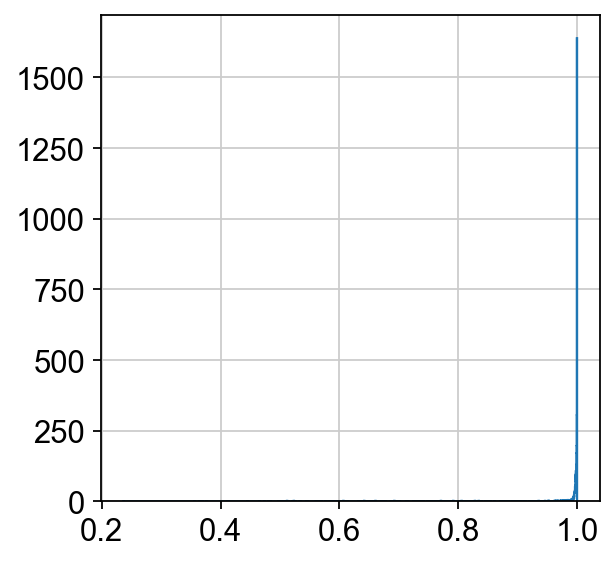

In [140]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## End LogisticRegression

In [141]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [142]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [143]:
y_pred = logreg.predict(adata_log_ordered.X)

In [144]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [145]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

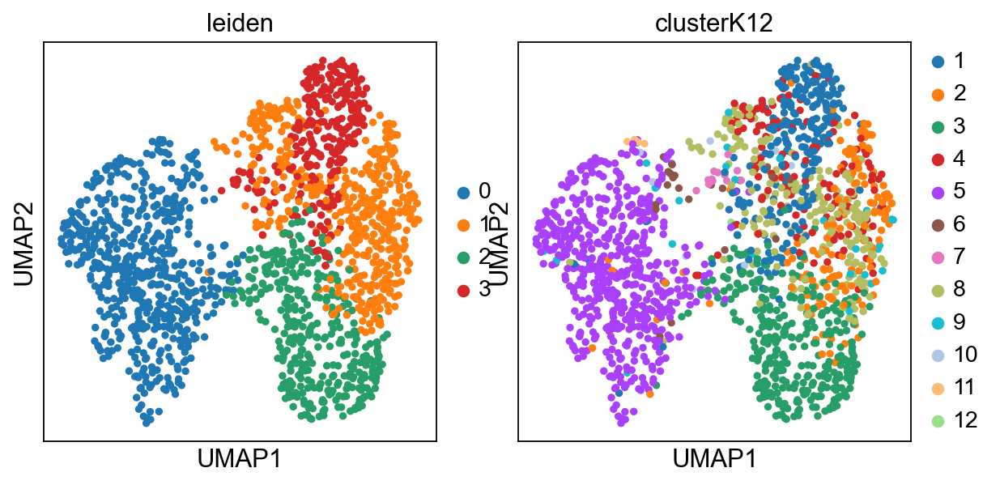

In [146]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

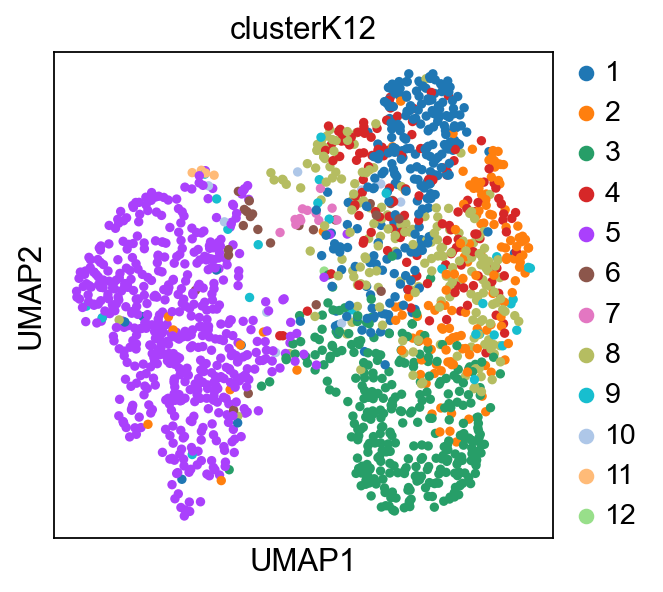

In [147]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

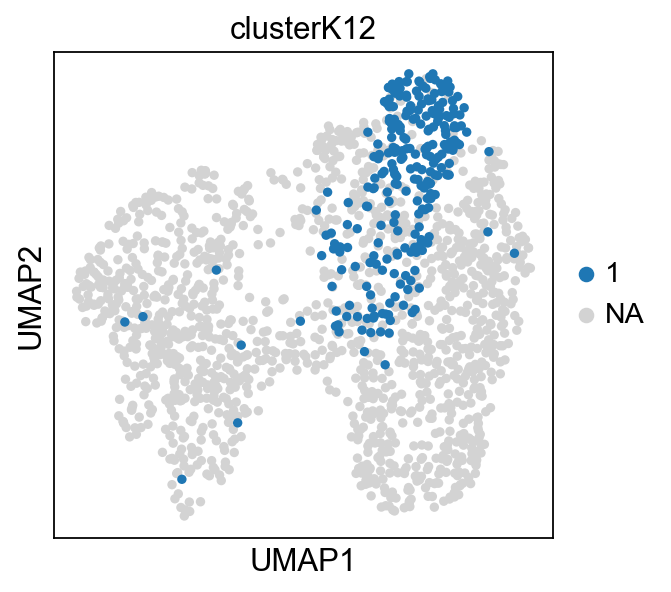

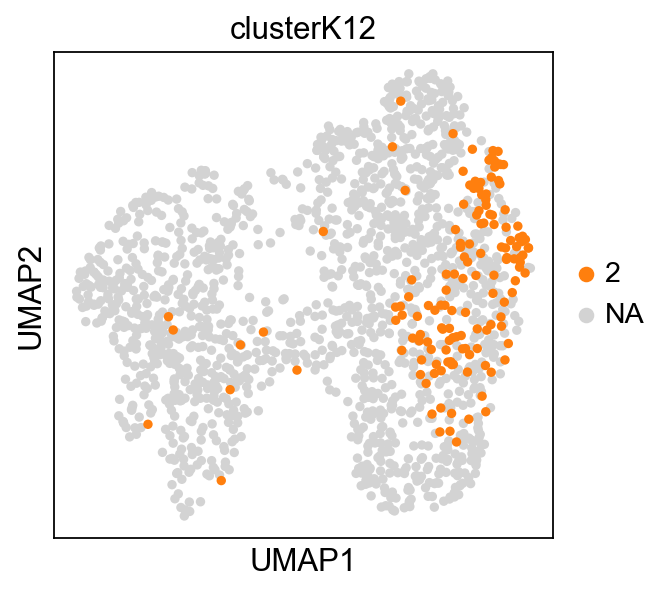

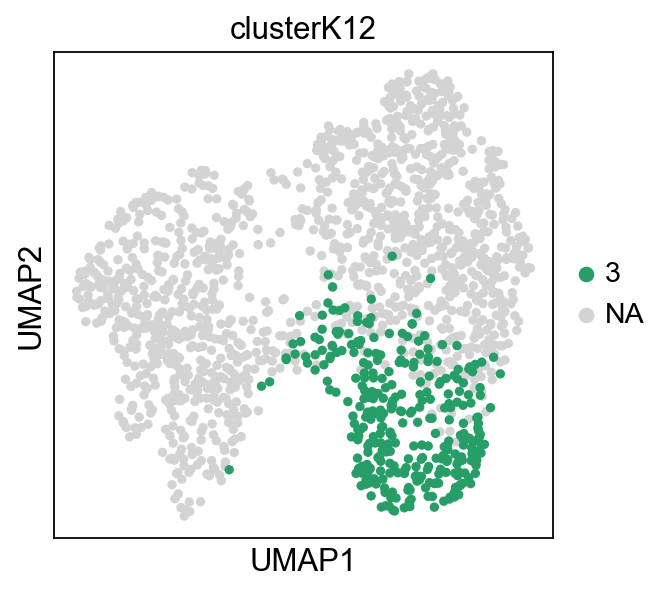

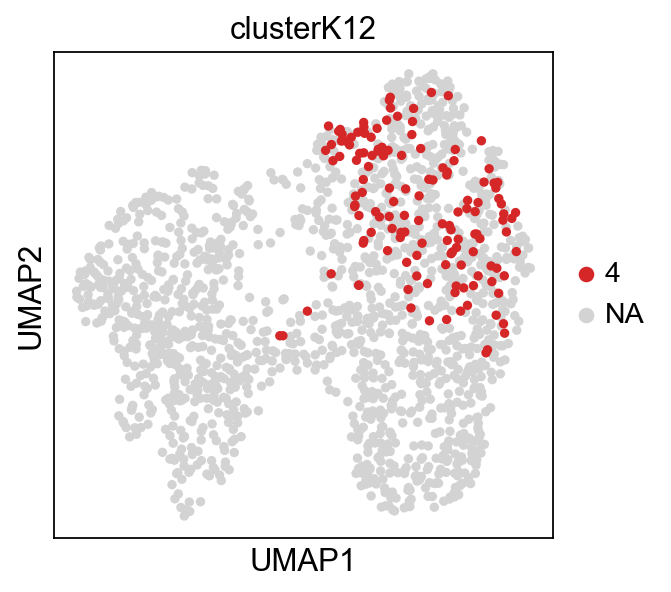

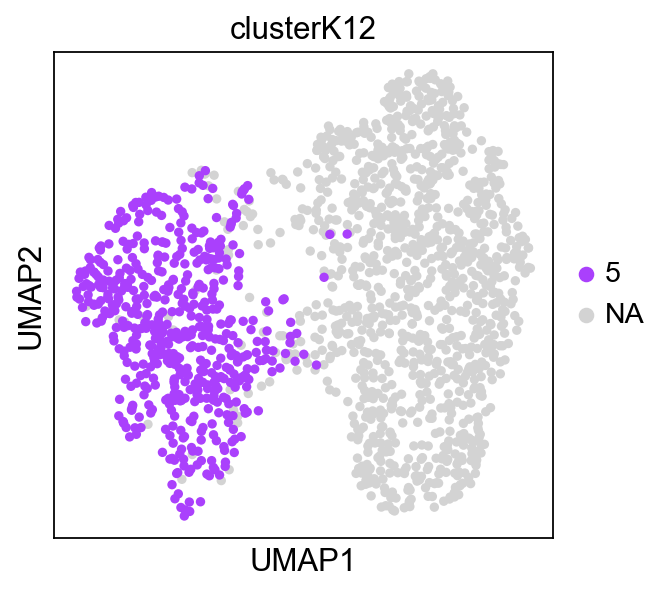

...

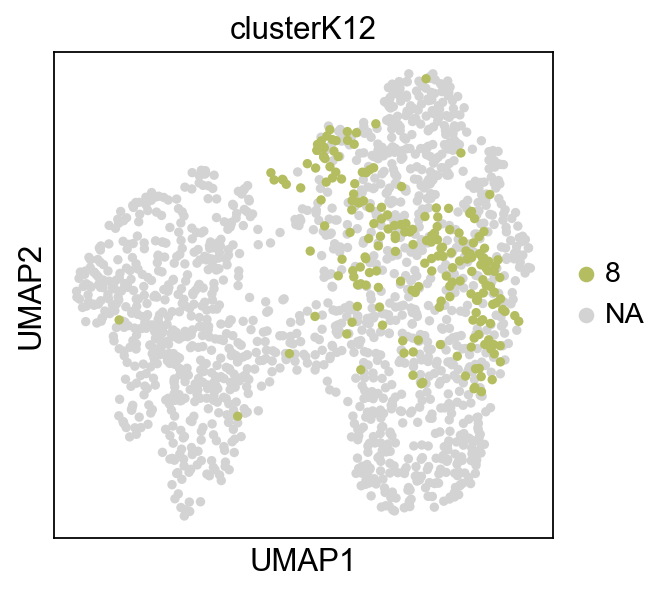

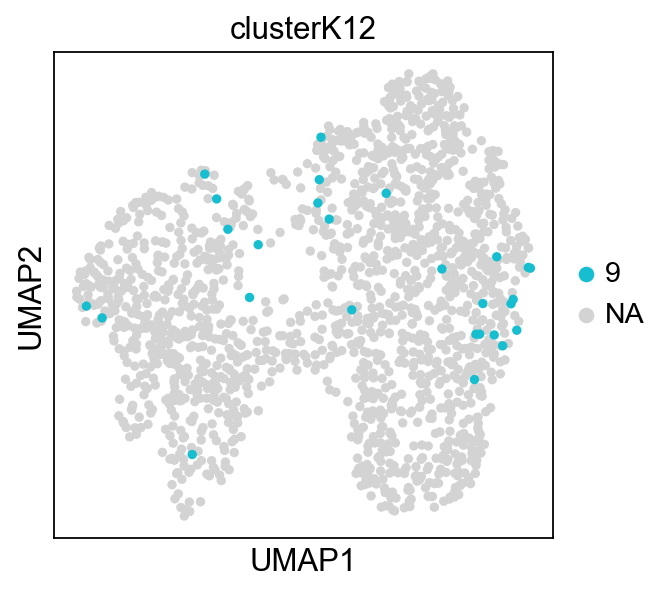

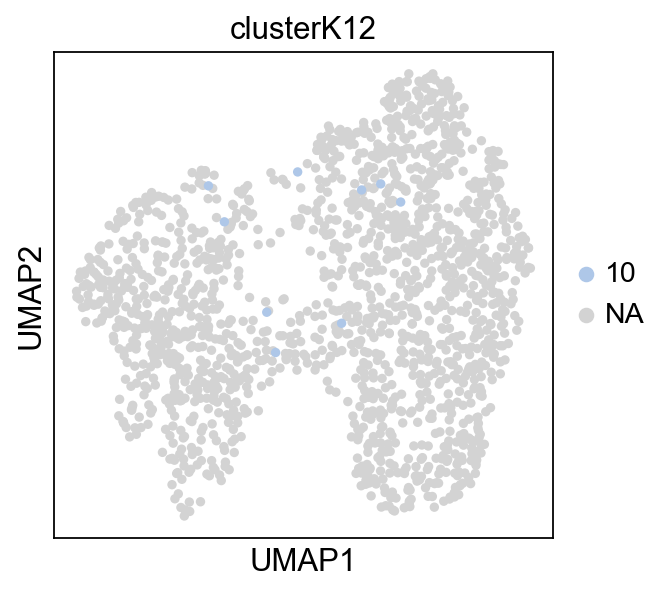

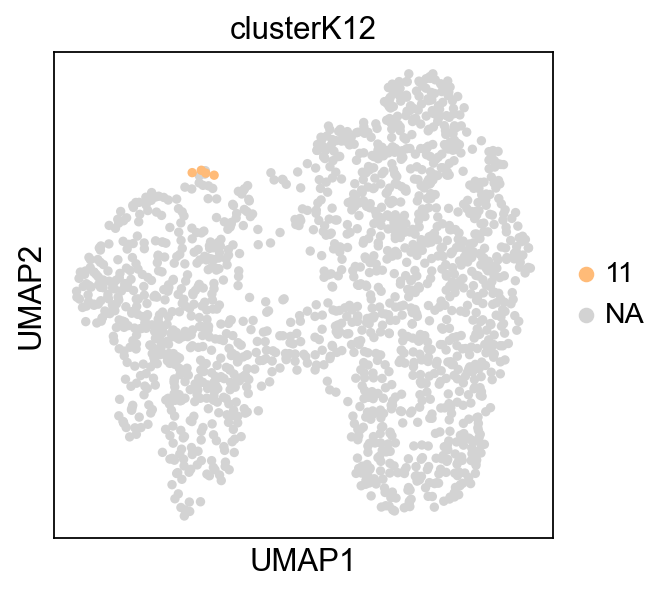

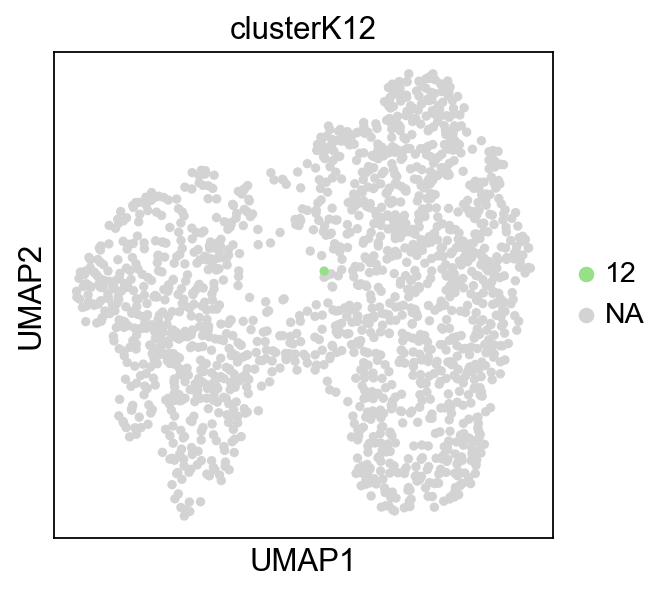

In [148]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

In [149]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

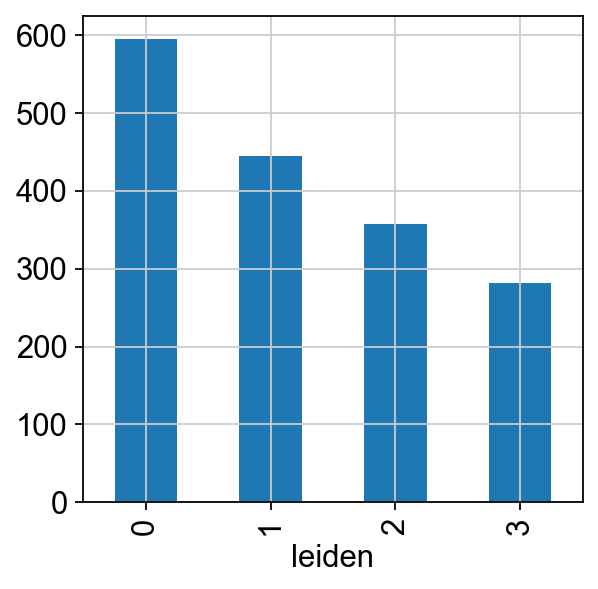

In [150]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

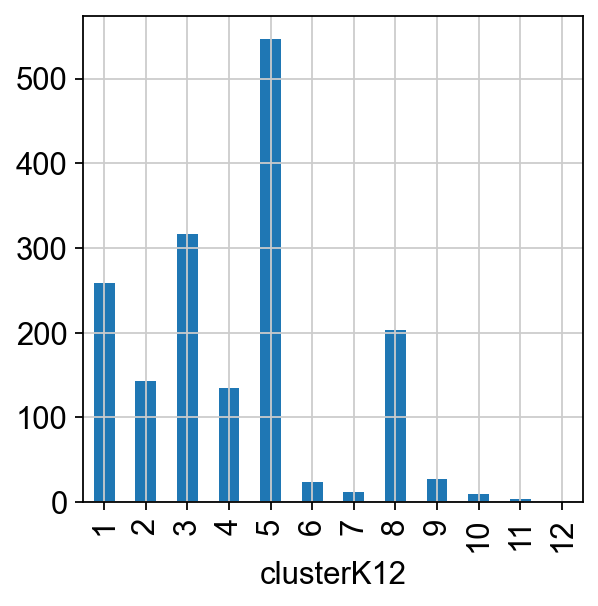

In [151]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

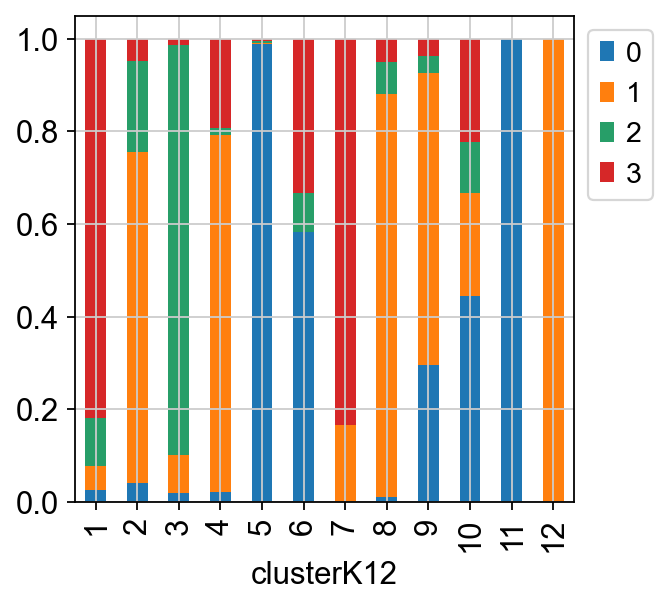

In [152]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [153]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,4,0.012438,4.059924e-05,7.821237e-06,9.784859e-01,2.377176e-06,0.001040,0.000572,0.005495,2.265362e-04,8.580332e-04,0.000448,0.000386,0.978486
1,5,0.002106,3.660747e-04,3.012307e-04,9.627256e-06,9.923349e-01,0.000201,0.000924,0.000035,6.619485e-05,8.116370e-05,0.001716,0.001858,0.992335
2,4,0.000013,1.714823e-02,9.057567e-02,8.391585e-01,3.158727e-05,0.000297,0.001323,0.042516,1.857472e-03,2.281054e-03,0.000805,0.003992,0.839158
3,3,0.006844,2.706692e-05,9.840476e-01,2.495587e-04,1.137637e-03,0.000450,0.000895,0.003291,9.996344e-05,7.674597e-04,0.000448,0.001743,0.984048
4,2,0.002507,9.834160e-01,1.227591e-05,3.260414e-03,1.629534e-04,0.001242,0.000518,0.000415,6.425448e-03,1.347233e-03,0.000654,0.000040,0.983416
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1675,5,0.000038,8.248195e-07,6.072560e-06,5.161427e-07,9.998798e-01,0.000016,0.000011,0.000004,8.203551e-08,4.334397e-07,0.000008,0.000035,0.999880
1676,2,0.005834,9.115170e-01,6.806482e-06,4.131990e-02,4.654026e-06,0.001537,0.000770,0.020903,1.702679e-02,6.043759e-04,0.000321,0.000156,0.911517
1677,9,0.000328,1.926393e-03,5.492548e-06,1.528811e-05,1.476467e-04,0.000126,0.001752,0.000010,9.947489e-01,2.888974e-05,0.000440,0.000471,0.994749
1678,2,0.003773,6.595384e-01,2.393777e-01,3.219613e-02,1.417888e-04,0.019164,0.001532,0.014459,4.419045e-03,2.158069e-02,0.002873,0.000945,0.659538


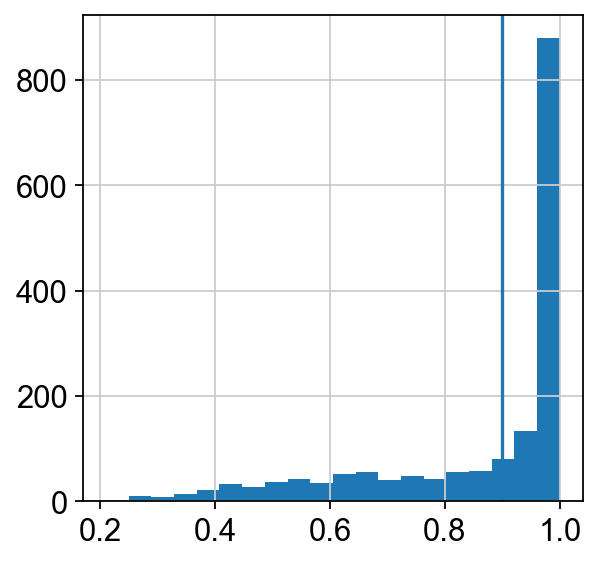

In [154]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [155]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.21-0.61,0.2090,0.6110
1,0.61-0.8,0.6110,0.8040
2,0.8-0.94,0.8040,0.9380
3,0.94-0.98,0.9380,0.9840
4,0.98-1.0,0.9840,0.9960
5,1.0-1.0,0.9975,0.9995


In [156]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_61975/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [157]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCGCACCTAACC-1       04
AAACCCGCACCTGCTG-1       05
AAACCCTGTGGGTCTC-1       04
AAACGACAGCAACCGT-1       03
AAAGCATGTGATTACC-1       02
                      ...  
TGTGCTGGTTGCAATC-1       05
TGTGGTTGTAGCAGAC-1       02
TGTGGTTGTTCGATAC-1       09
TGTGTACGTGATCCTG-1    other
TGTGTACGTTAGCGCC-1       01
Name: clusterK12_stringent, Length: 1680, dtype: object

In [158]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

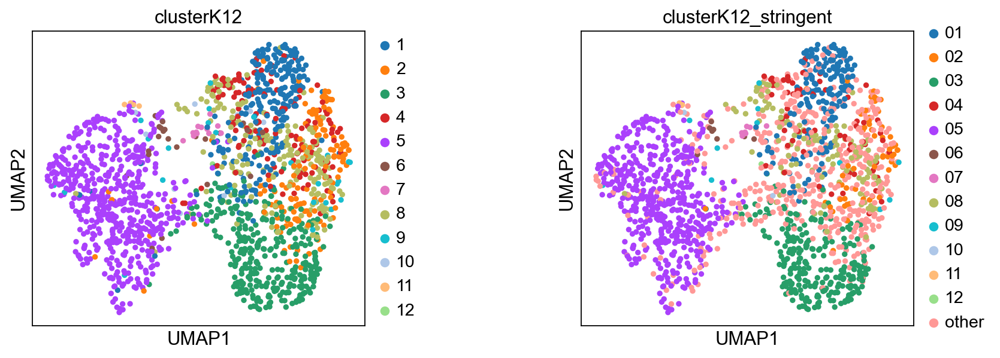

In [159]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

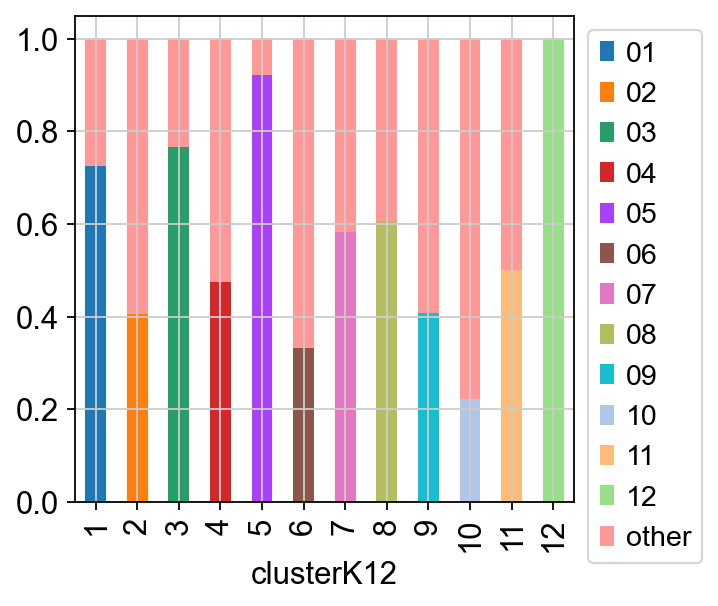

In [160]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

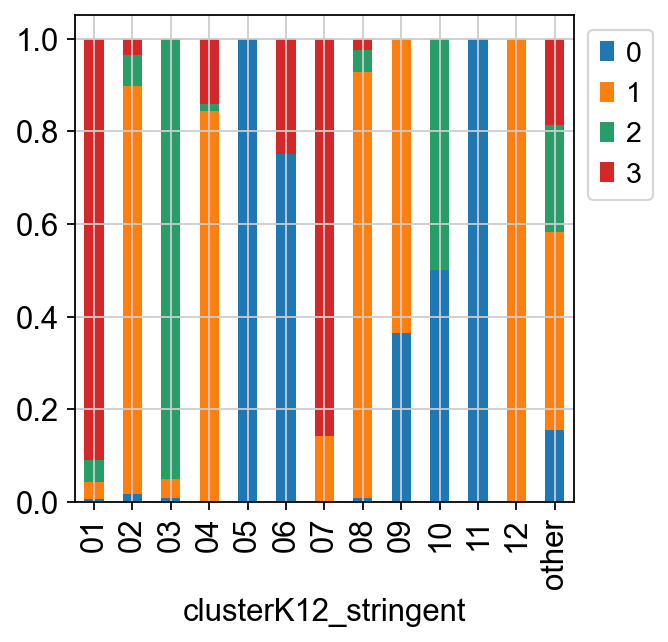

In [161]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

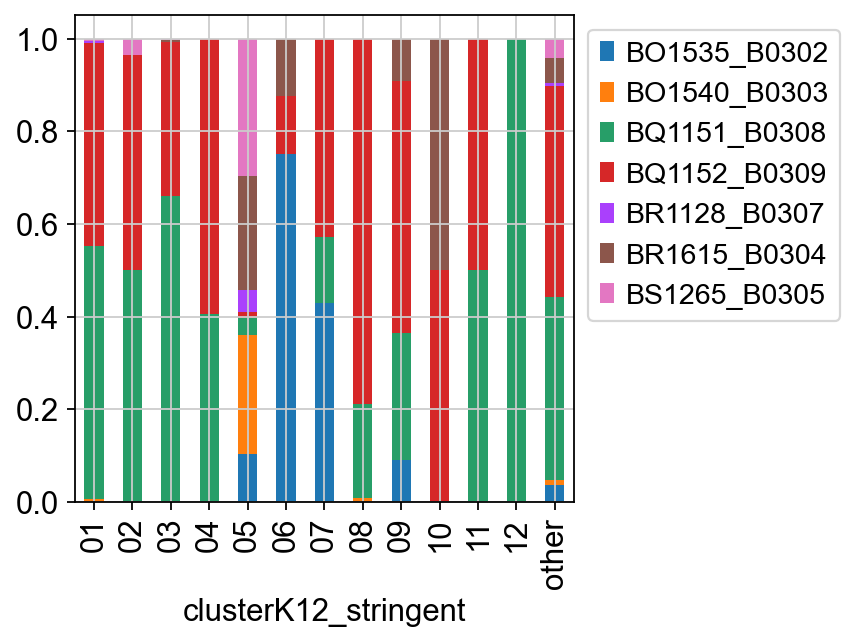

In [162]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Classification'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

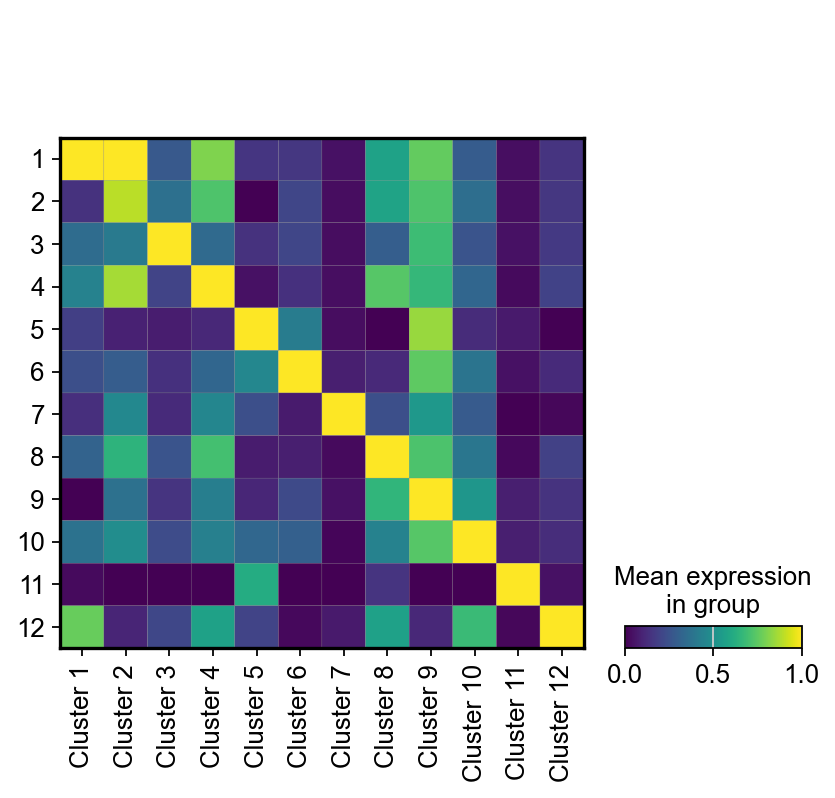

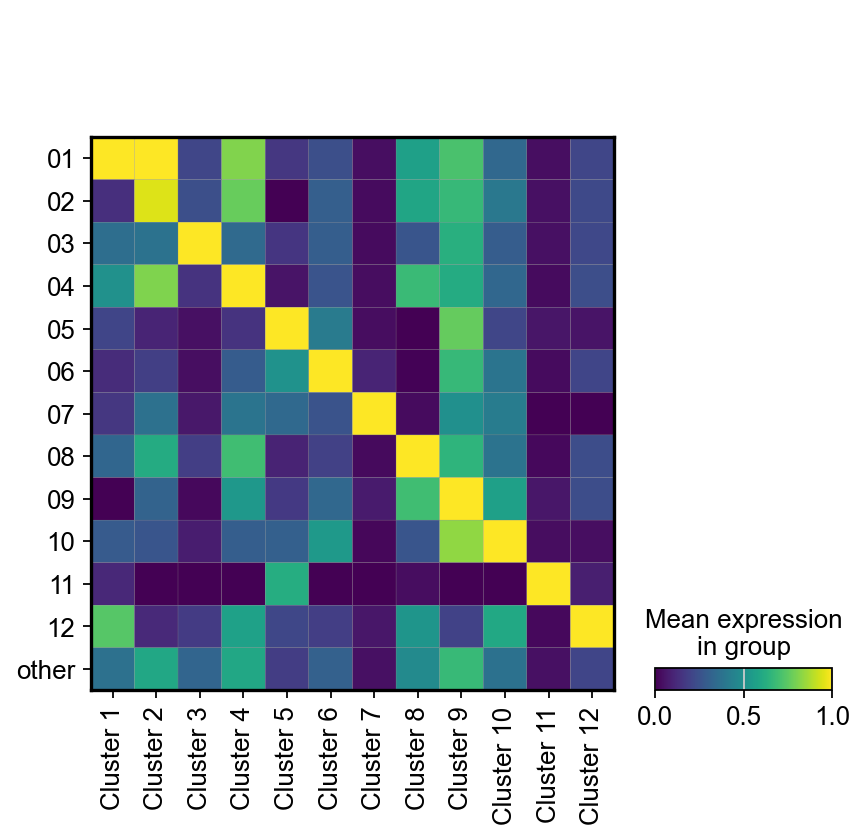

In [163]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

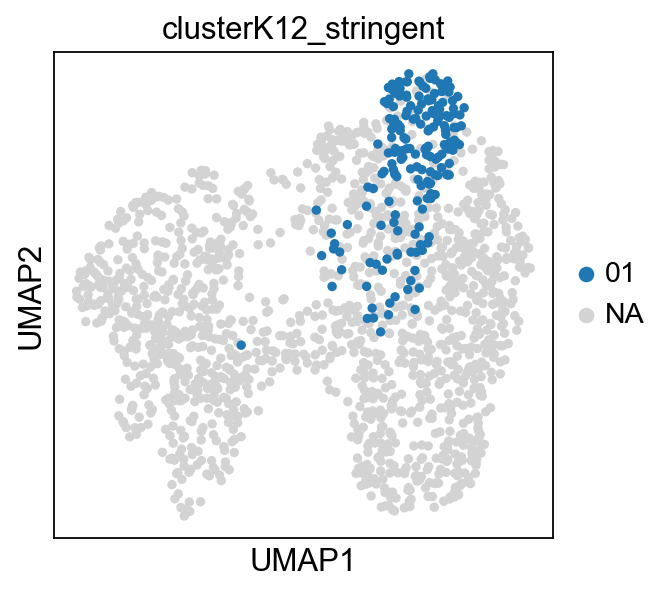

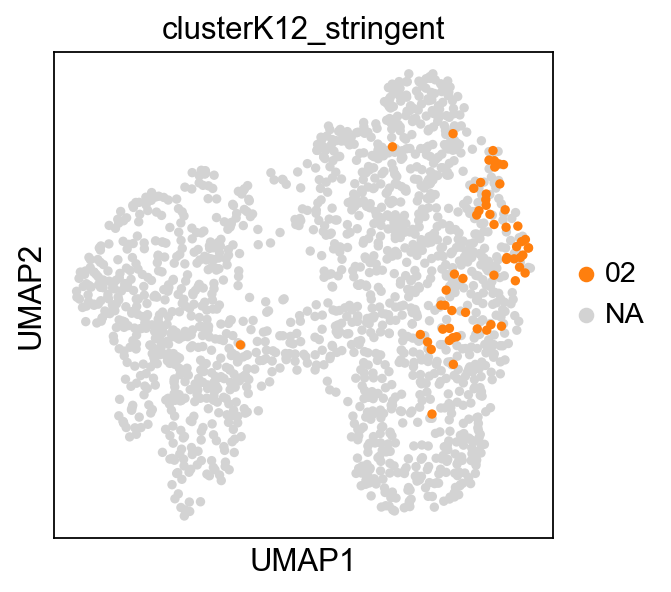

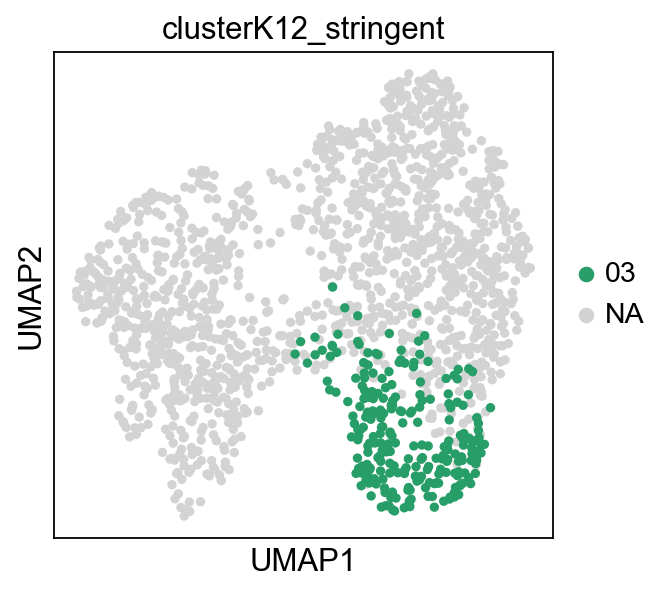

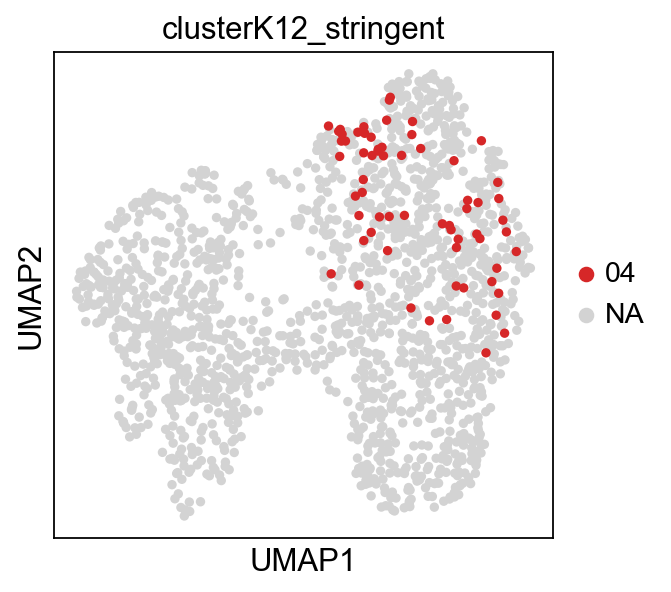

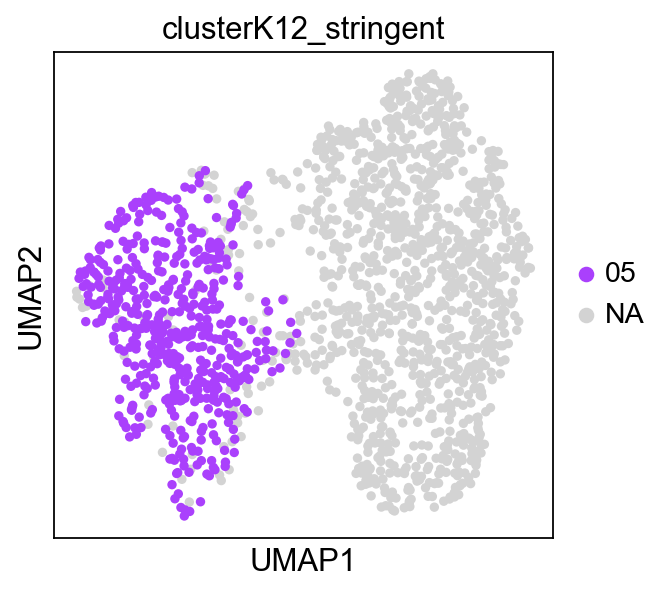

...

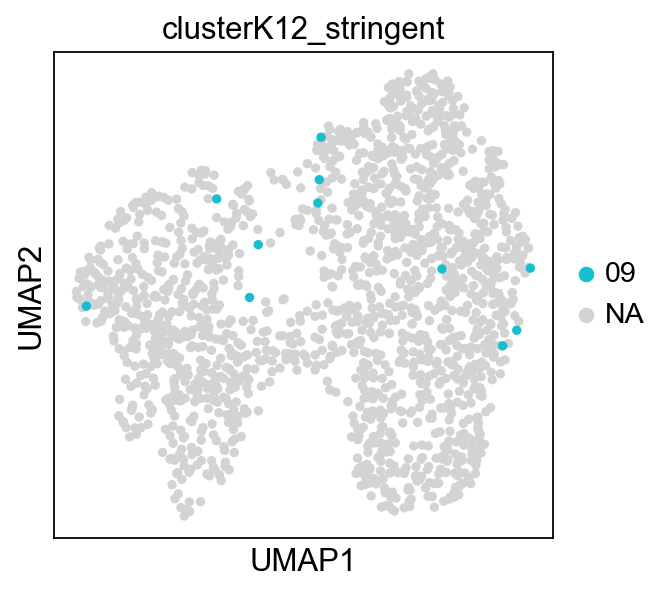

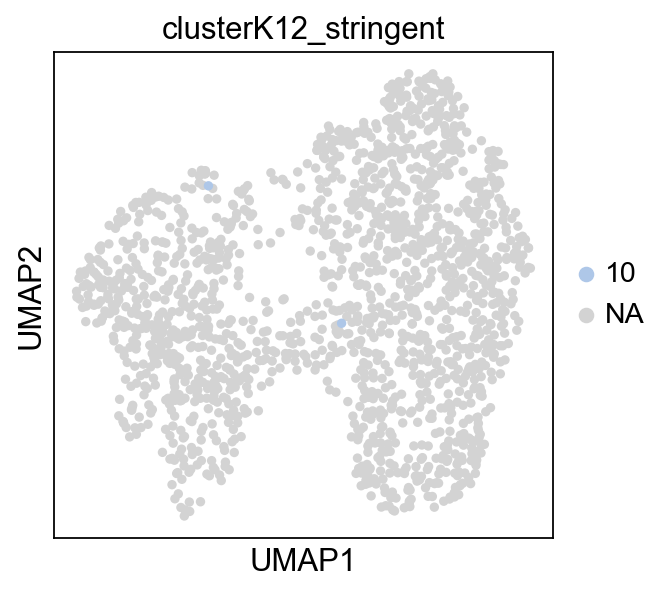

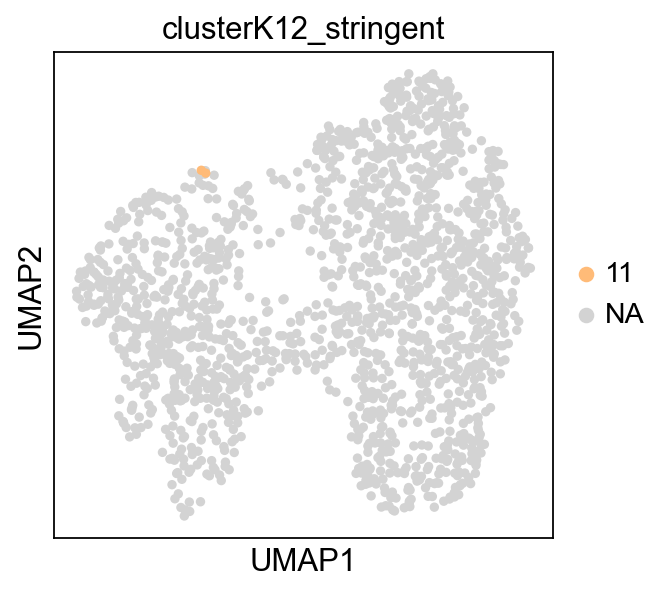

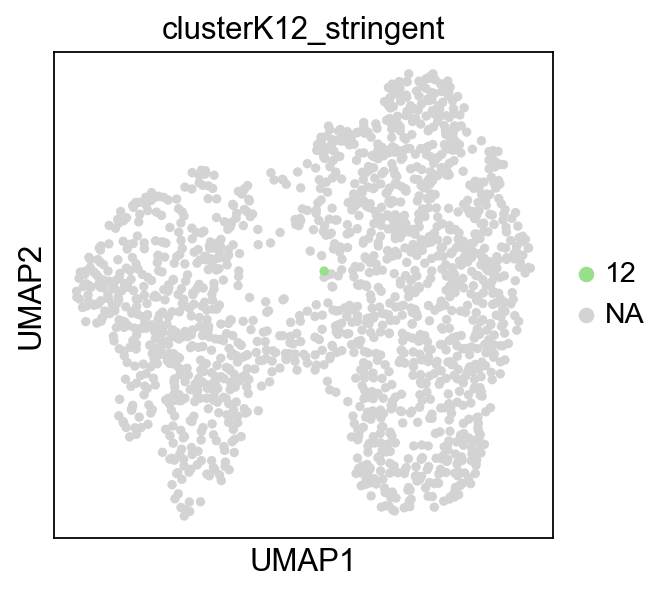

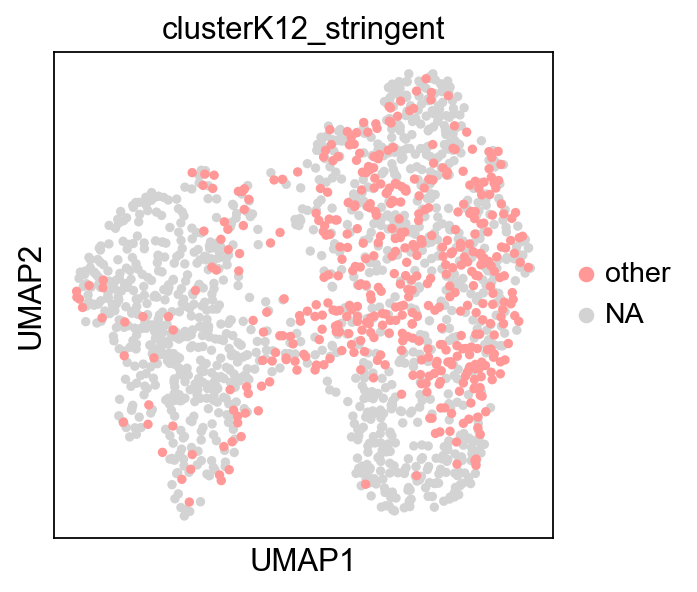

In [164]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [165]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
5     547
3     316
1     259
8     203
2     143
4     135
9      27
6      24
7      12
10      9
11      4
12      1
Name: count, dtype: int64

In [166]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

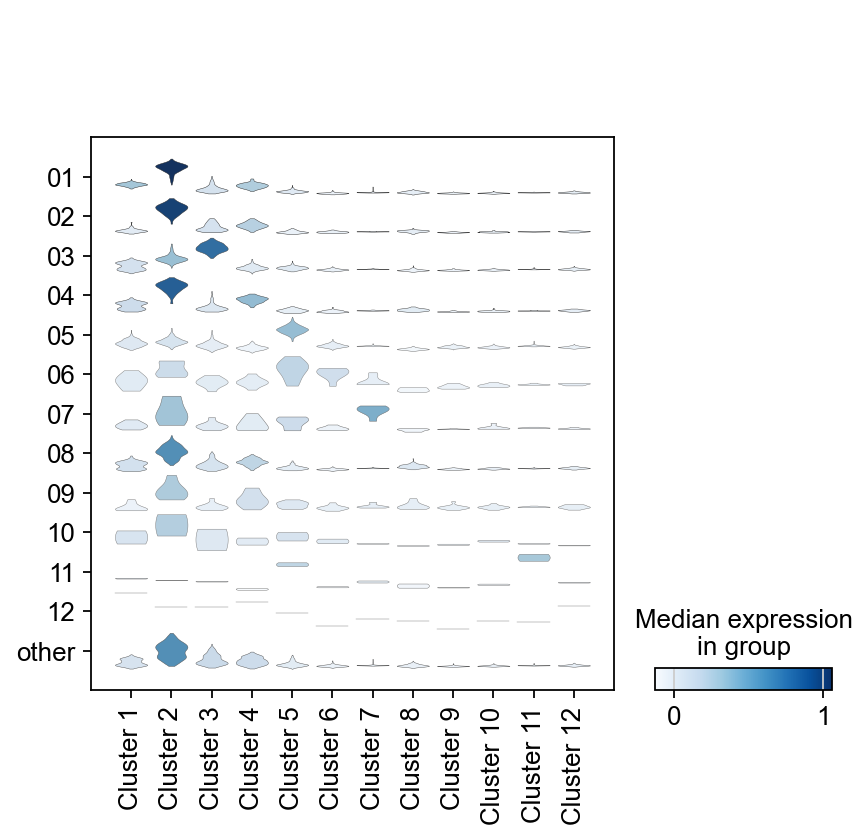

In [167]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

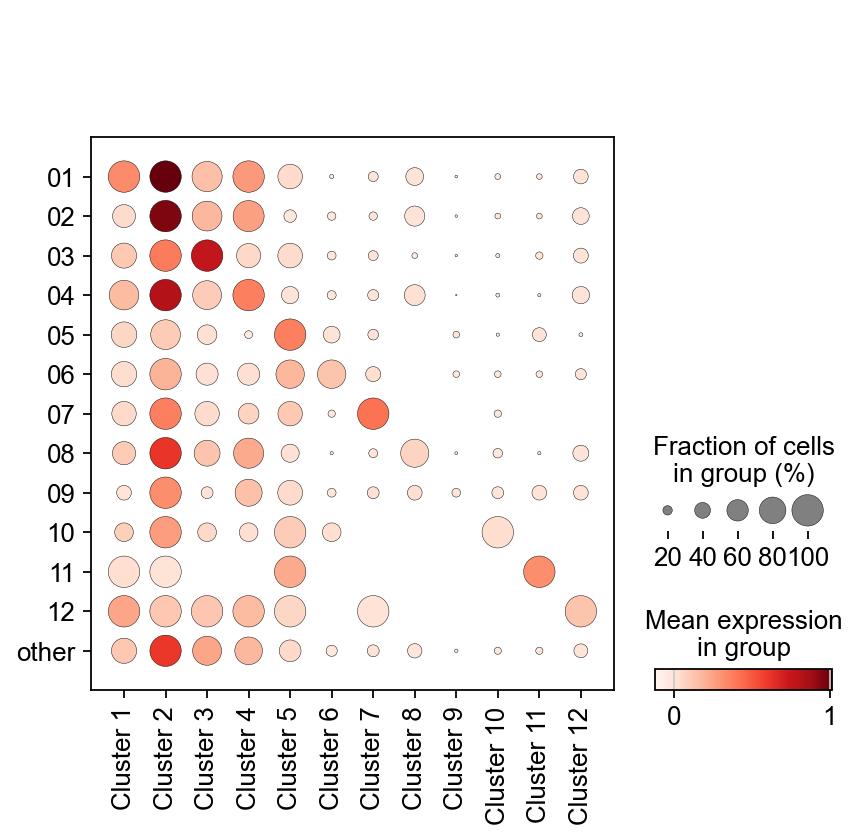

In [168]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')

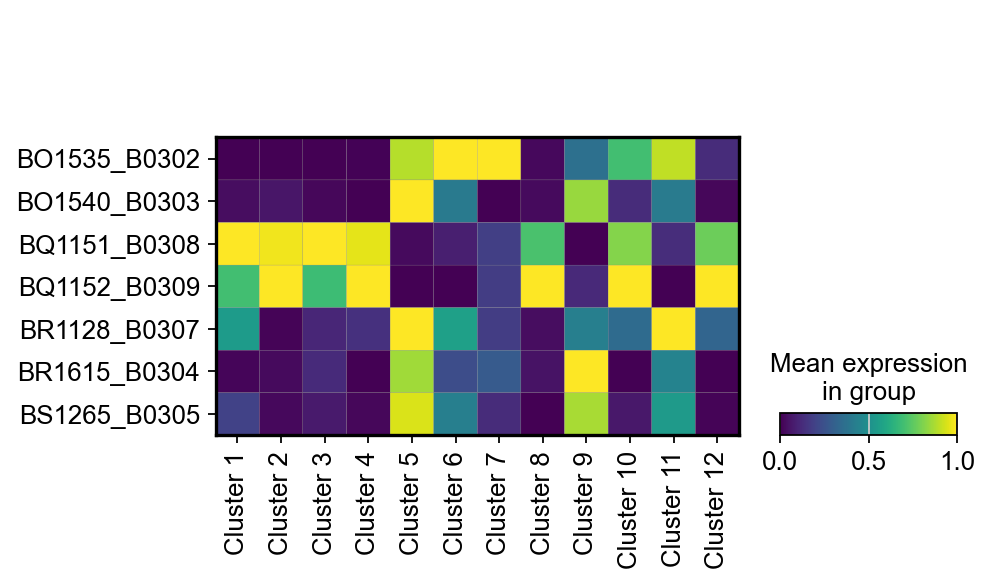

In [169]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Classification',standard_scale='var')

In [170]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

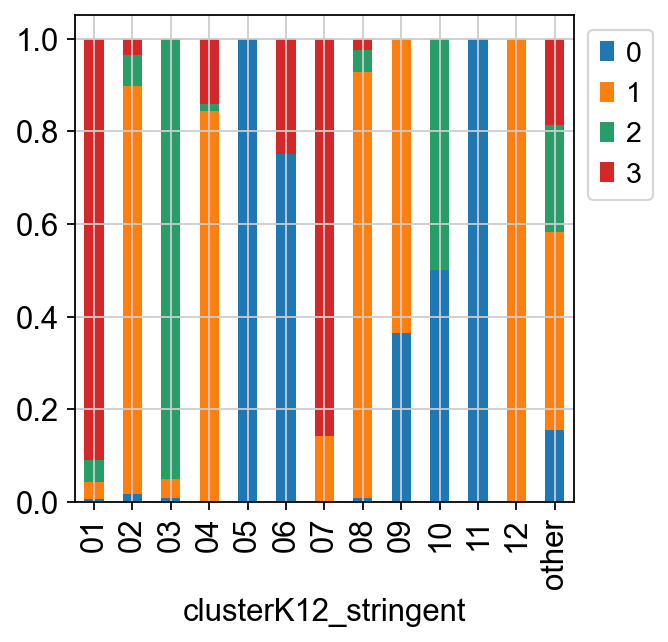

In [171]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

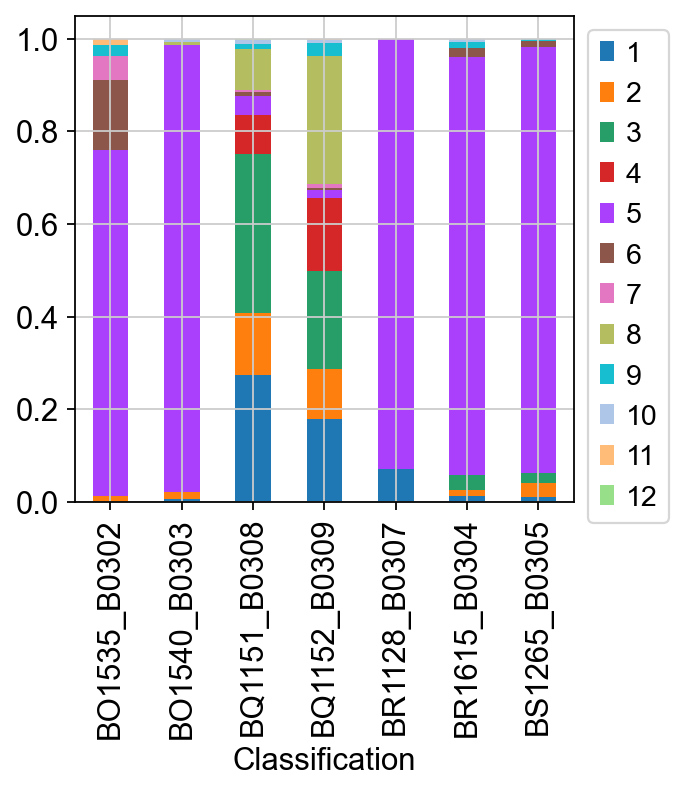

In [172]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

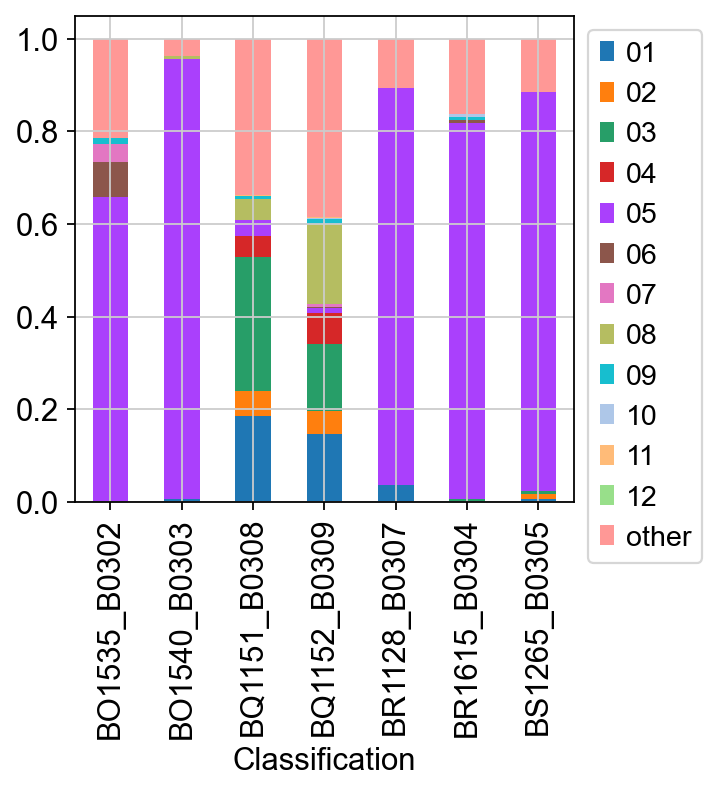

In [173]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Examine Groupings

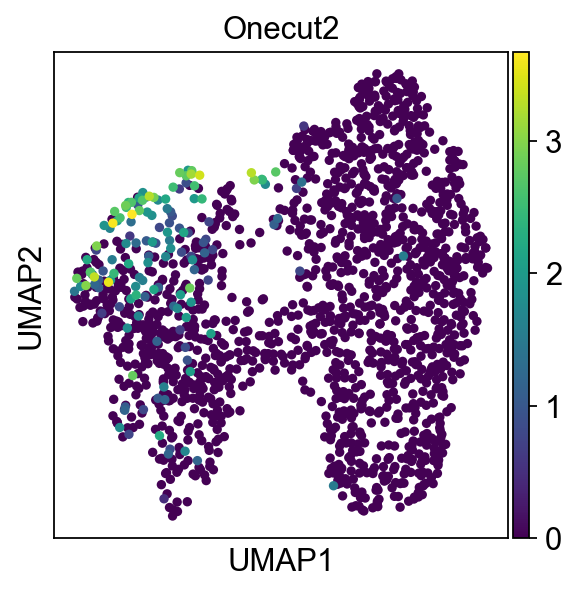

In [174]:
sc.pl.umap(adata, color=['Onecut2'])

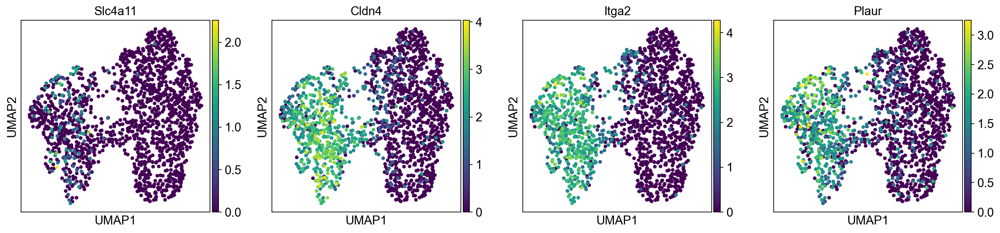

In [175]:
sc.pl.umap(adata, color=['Slc4a11','Cldn4','Itga2', 'Plaur']) #'Tigit',

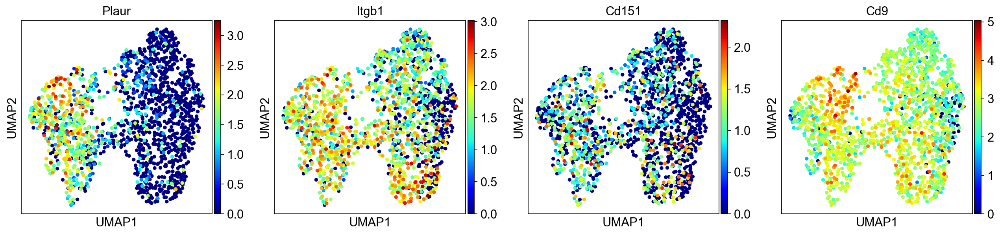

In [176]:
sc.pl.umap(adata, color=['Plaur','Itgb1','Cd151', 'Cd9'], cmap="jet")

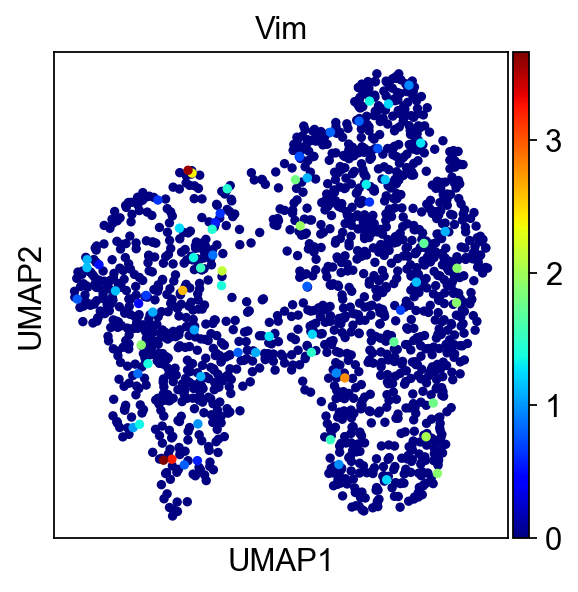

In [177]:
sc.pl.umap(adata, color=['Vim',], cmap="jet") #'Cd109'

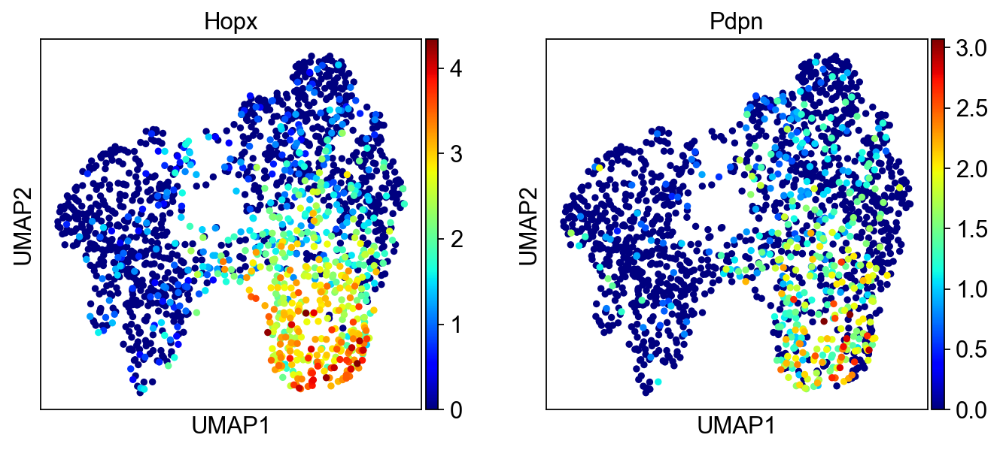

In [178]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], cmap="jet")

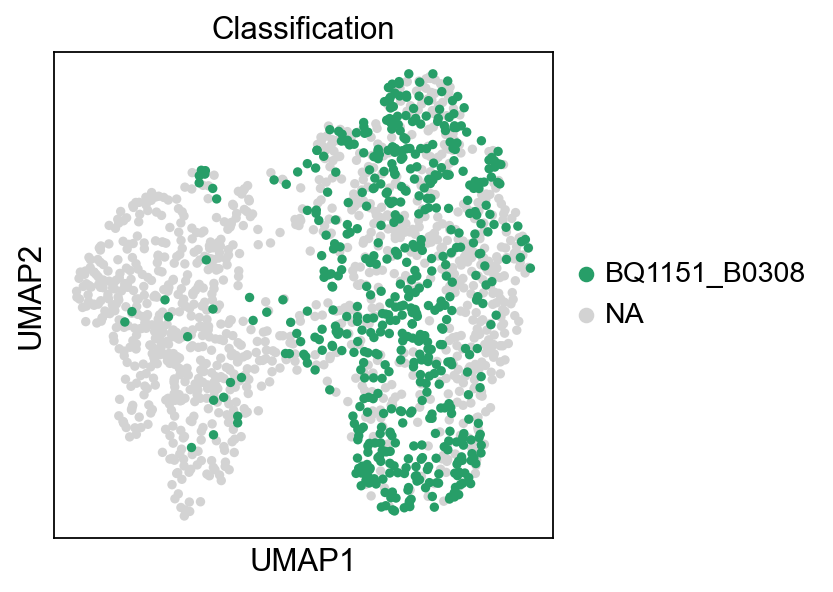

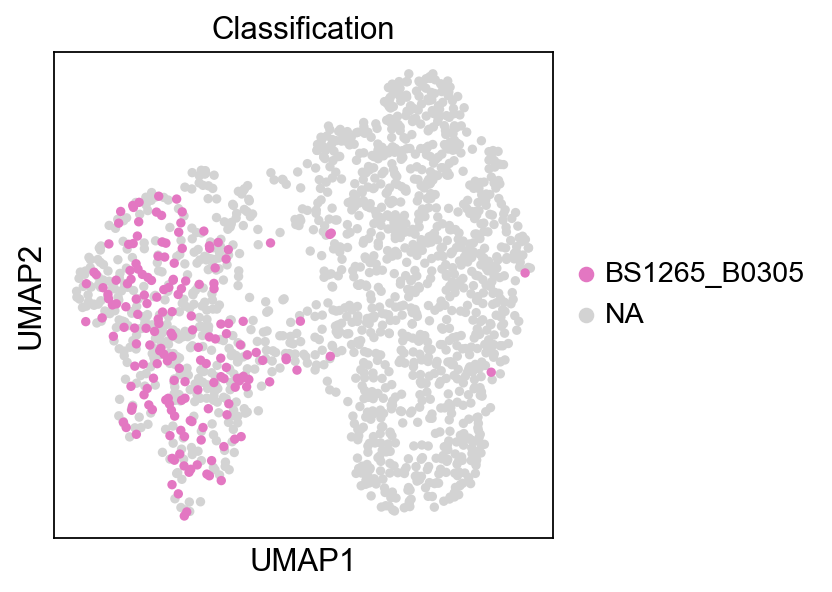

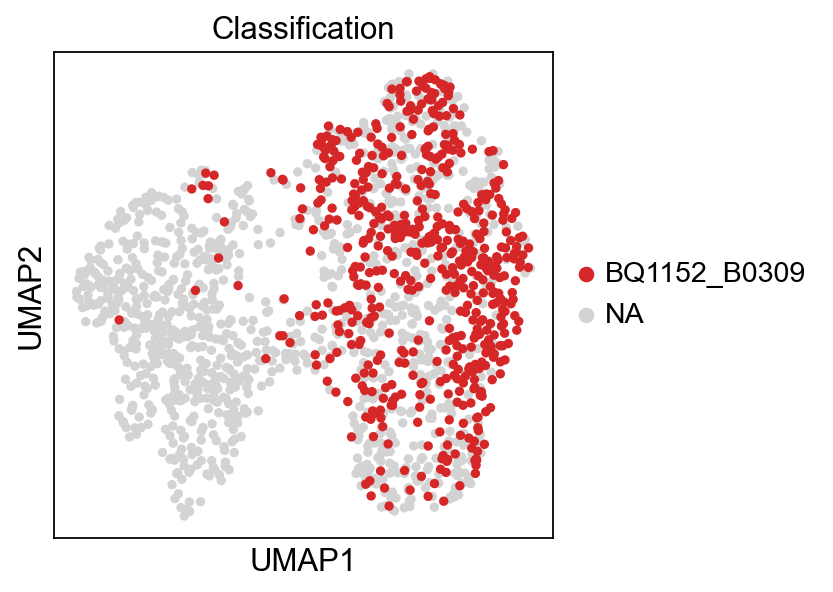

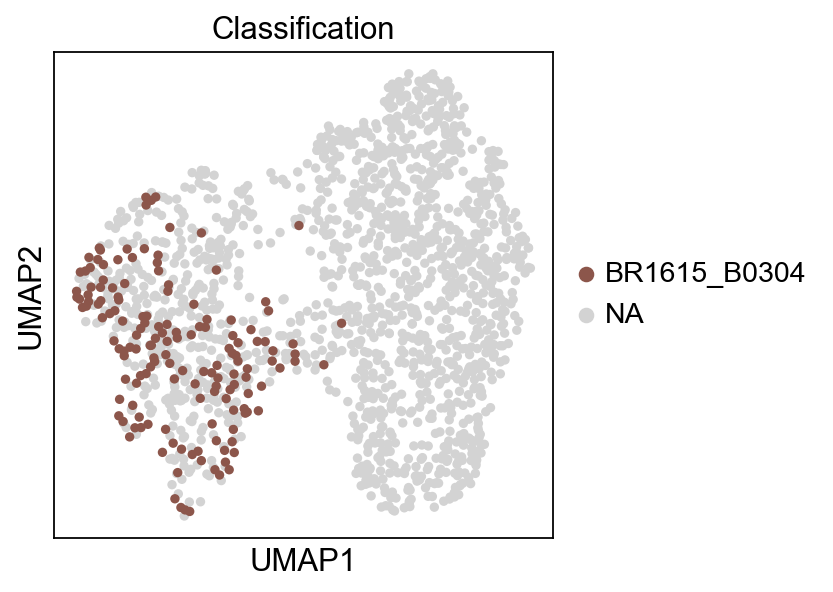

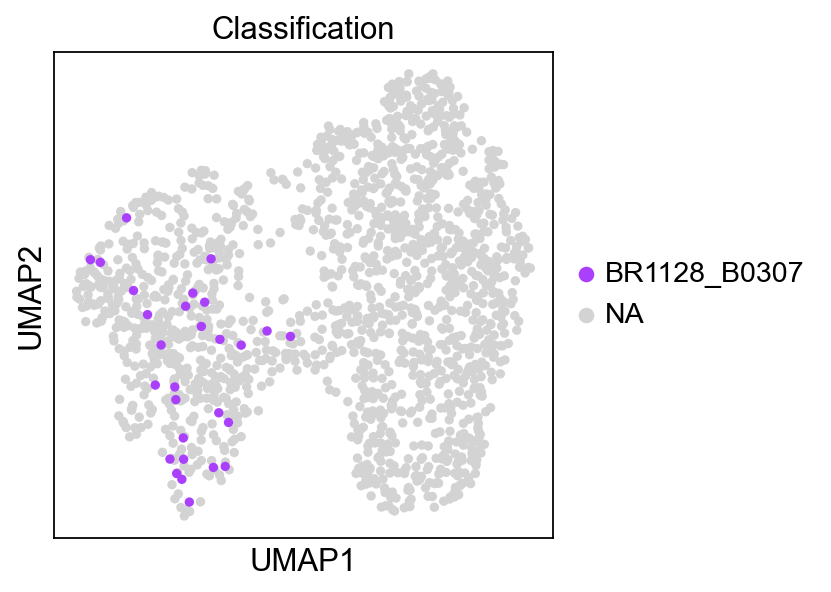

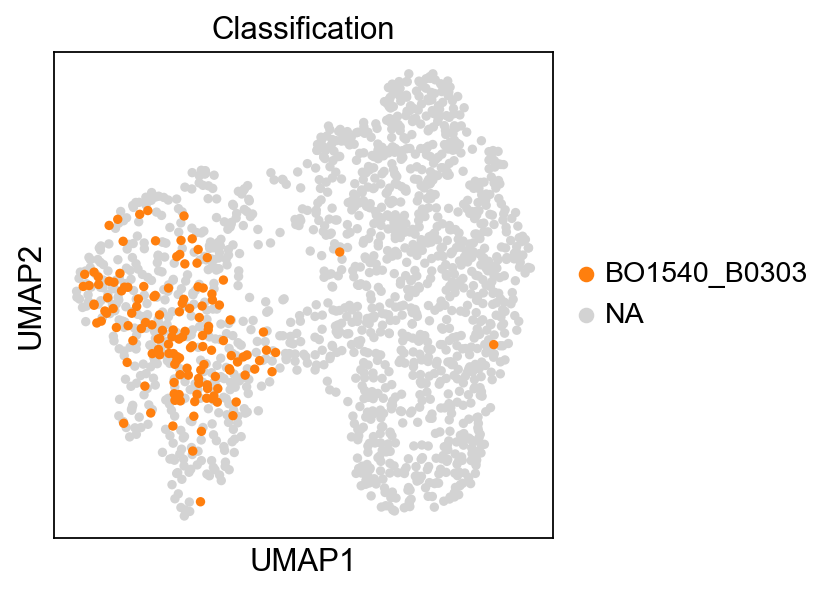

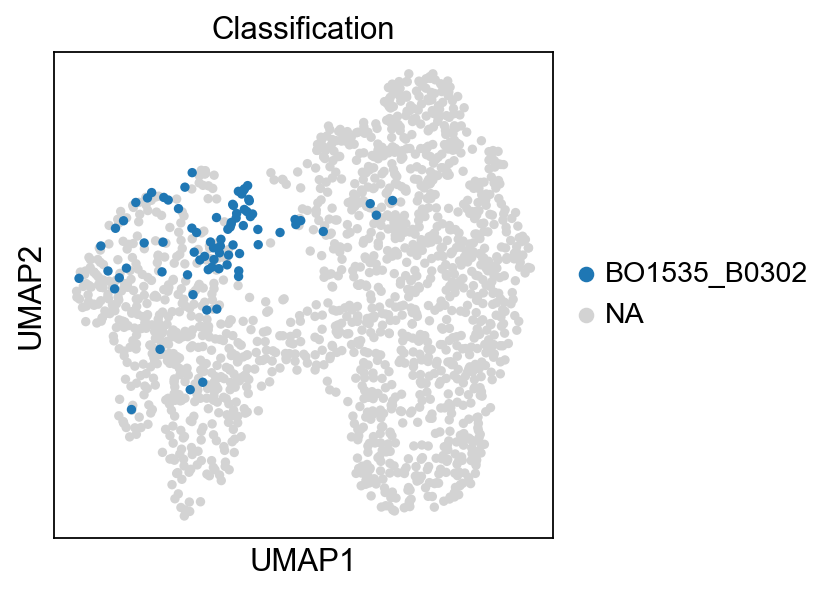

In [179]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [180]:
adata.obs.Group.value_counts()

Group
3d    1680
Name: count, dtype: int64

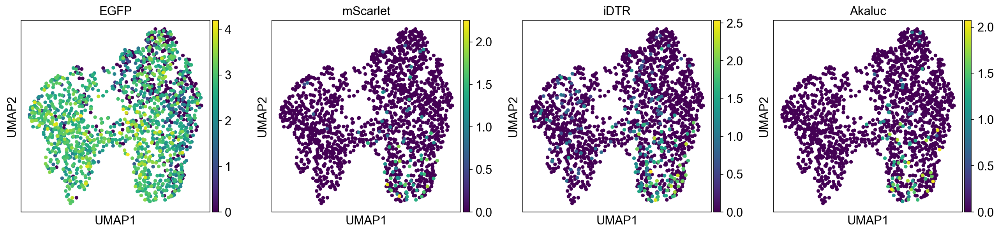

In [181]:
sc.pl.umap(adata, color=['EGFP','mScarlet','iDTR','Akaluc'])

In [182]:
sc.tl.embedding_density(adata,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


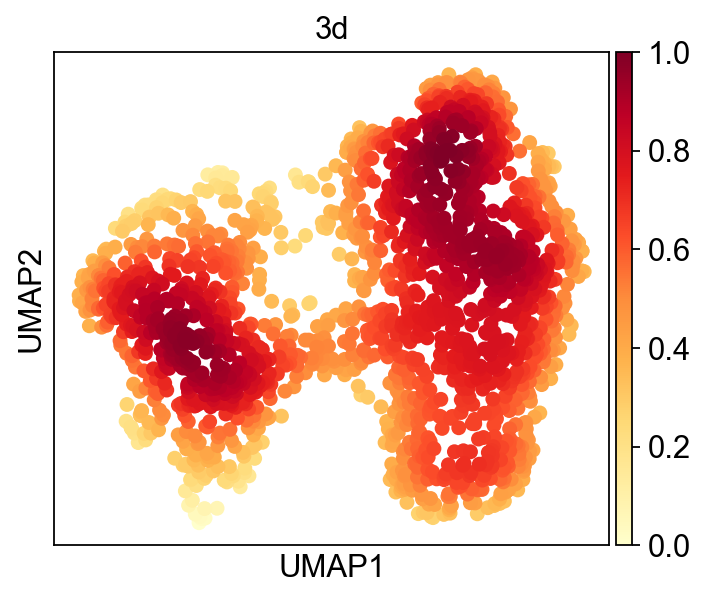

In [183]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Group')

In [184]:
adata.obs["clusterK12"] = adata.obs["clusterK12"].astype(str).str.zfill(2).astype("category")

In [185]:
adata.obs.Classification.value_counts()

Classification
BQ1152_B0309    556
BQ1151_B0308    553
BS1265_B0305    174
BR1615_B0304    153
BO1540_B0303    137
BO1535_B0302     79
BR1128_B0307     28
Name: count, dtype: int64

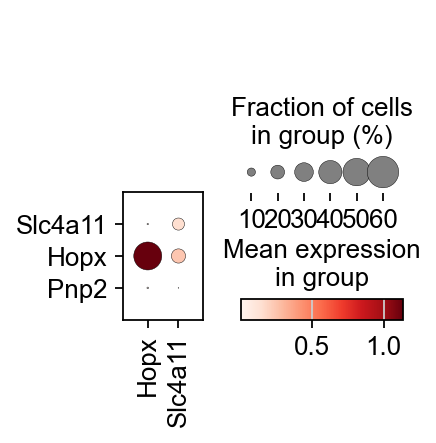

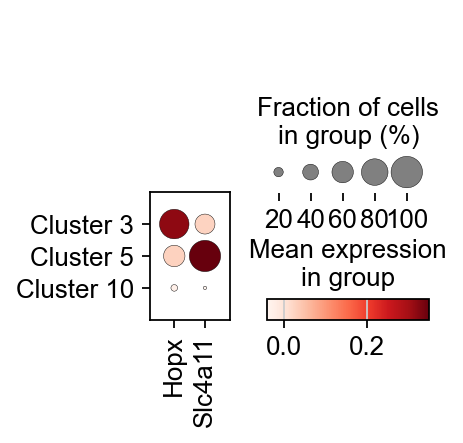

In [186]:
sc.pl.dotplot(adata, ['Slc4a11', 'Hopx','Pnp2'], groupby='Allele',swap_axes=True)
sc.pl.dotplot(adata, ['Cluster 3', 'Cluster 5','Cluster 10'], groupby='Allele',swap_axes=True)

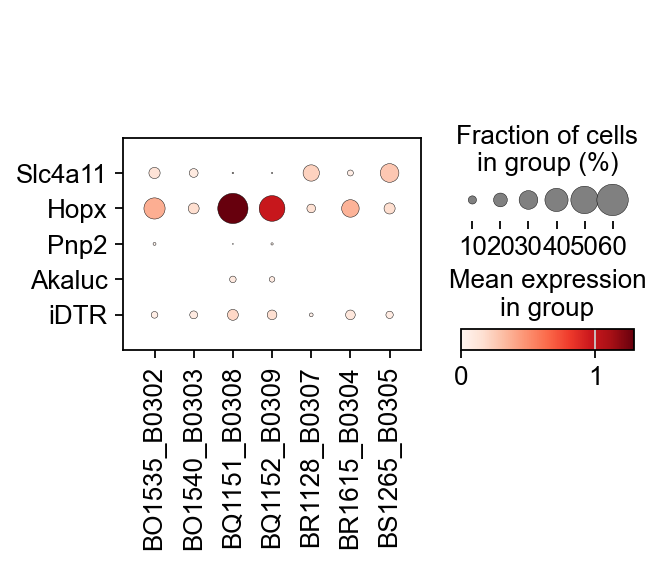

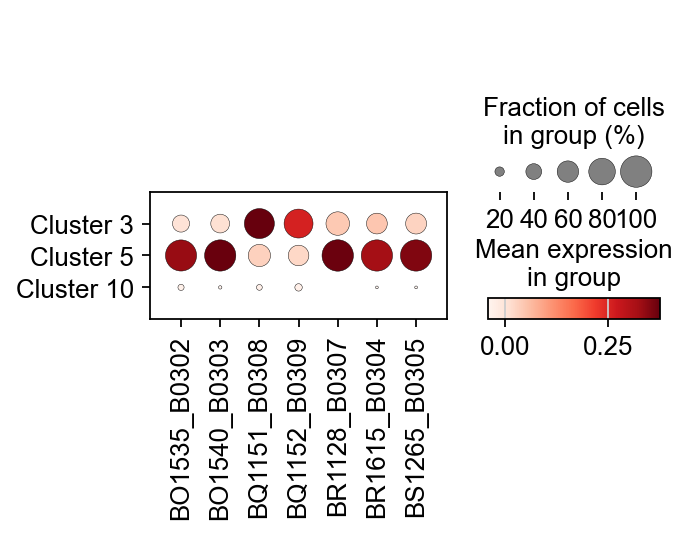

In [187]:
sc.pl.dotplot(adata, ['Slc4a11', 'Hopx','Pnp2','Akaluc','iDTR'], groupby='Classification',swap_axes=True)
sc.pl.dotplot(adata, ['Cluster 3', 'Cluster 5','Cluster 10'], groupby='Classification',swap_axes=True)

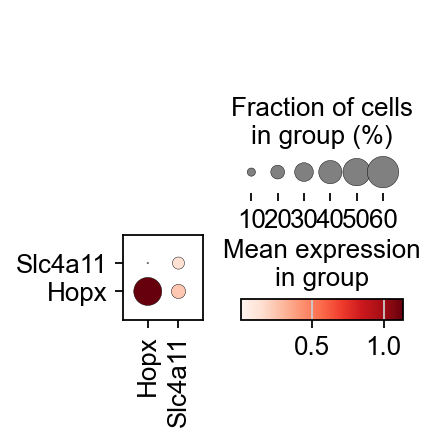

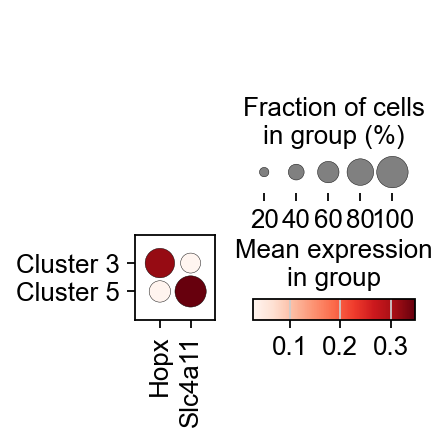

In [188]:
sc.pl.dotplot(adata, ['Slc4a11', 'Hopx'], groupby='Allele',swap_axes=True)
sc.pl.dotplot(adata, ['Cluster 3', 'Cluster 5'], groupby='Allele',swap_axes=True)

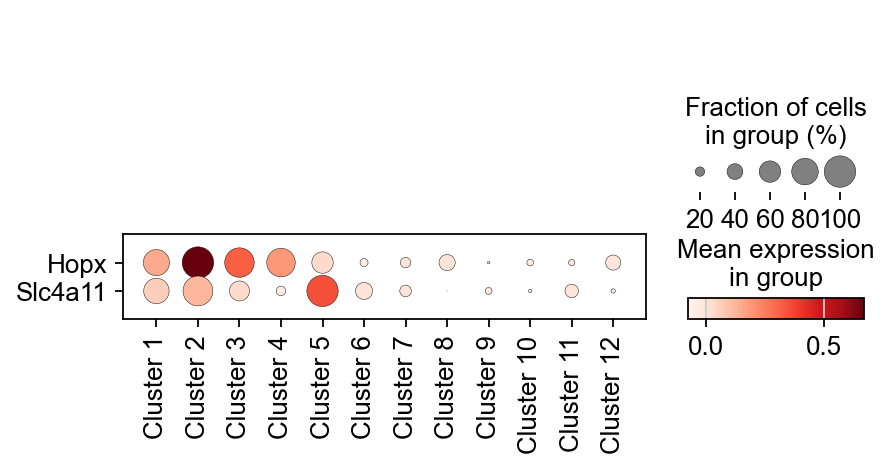

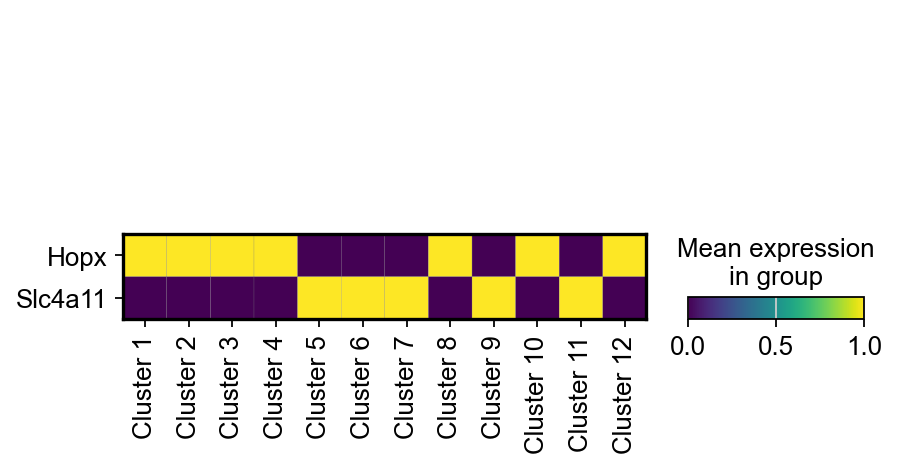

In [189]:
sc.pl.dotplot(adata, [*cancerCell], groupby='Allele',swap_axes=False)
sc.pl.matrixplot(adata, [*cancerCell], groupby='Allele',swap_axes=False,standard_scale='var')

running Leiden clustering
    finished: found 4 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


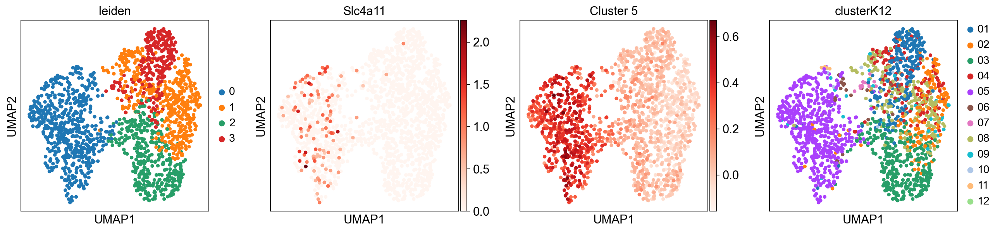

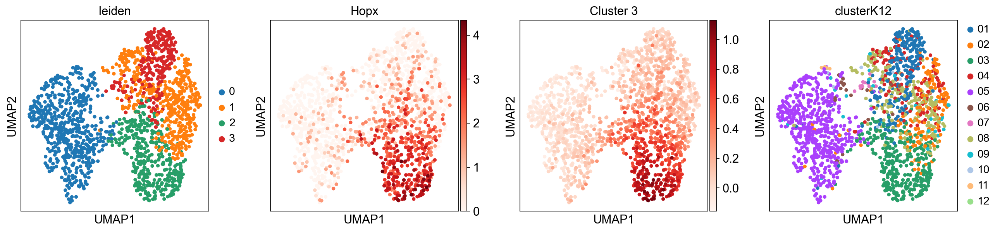

In [190]:
sc.tl.leiden(adata, resolution=.30)
sc.pl.umap(adata, color=['leiden','Slc4a11','Cluster 5', 'clusterK12'], cmap='Reds')
sc.pl.umap(adata, color=['leiden','Hopx','Cluster 3', 'clusterK12'], cmap='Reds')

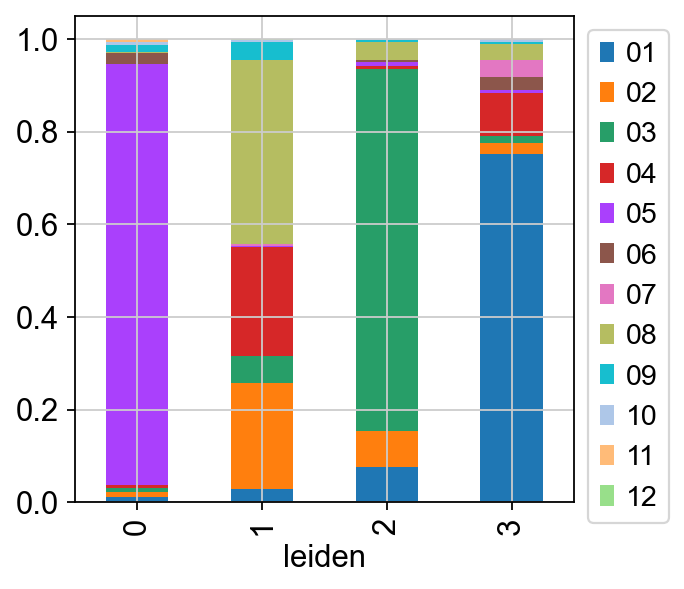

In [191]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

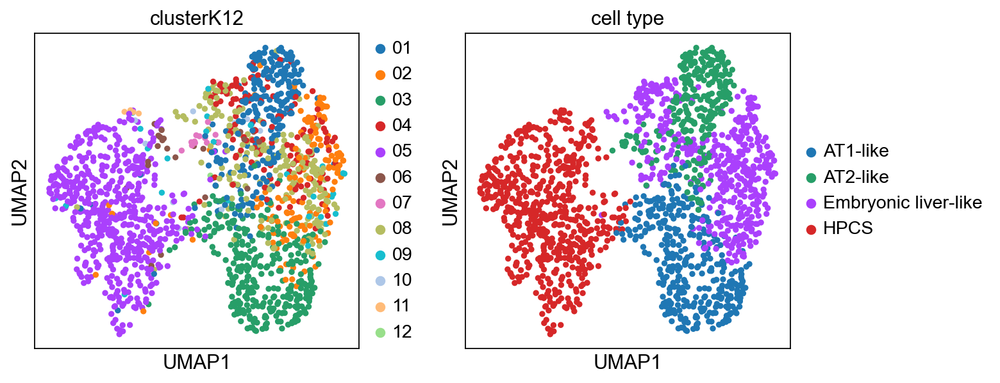

In [192]:
cluster2annotation = {
    "0": "HPCS",
    "1": "Embryonic liver-like",
    "2": "AT1-like",
    "3": "AT2-like",
}
#"AT1-like","AT2-like",'EMT', 'HPCS',"Lung Endoderm-like",'Highly Proliferative','Embryonic liver-like'
#adata.uns['cell type_colors'] = ['#1f77b4','#279e68', '#ff7f0e', '#d62728', '#8c564b','#e377c2', '#aa40fc']

adata.obs["cell type"] = adata.obs["leiden"].map(cluster2annotation).astype("category")
adata.obs['cell type'] = adata.obs['cell type'].cat.reorder_categories(['AT1-like', 'AT2-like', 'Embryonic liver-like','HPCS'], ordered=True)
adata.uns['cell type_colors'] = ['#1f77b4','#279e68', '#aa40fc','#d62728', ] #'#ff7f0e' EMT,'#e377c2' lung endoderm, '#8c564b' highly proliferative

sc.pl.umap(adata, color=['clusterK12','cell type'])

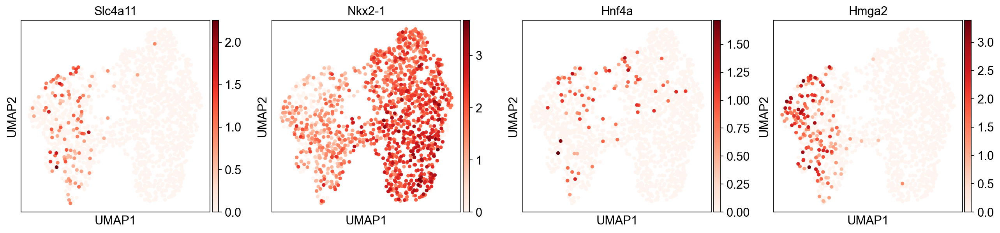

In [193]:
sc.pl.umap(adata, color=['Slc4a11','Nkx2-1','Hnf4a','Hmga2'], cmap='Reds')

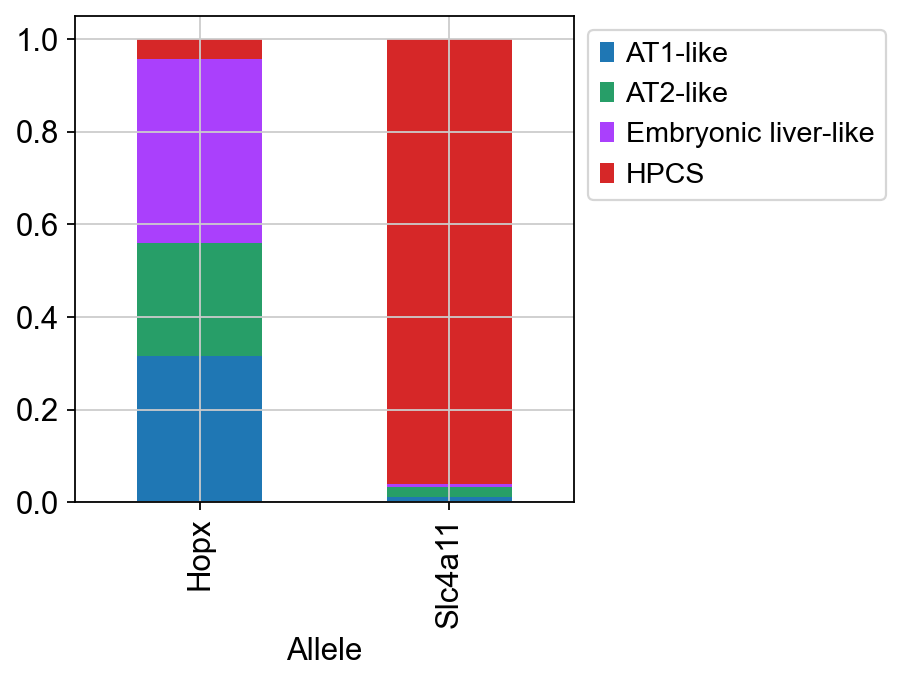

In [194]:
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Allele'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns['cell type_colors']).legend(bbox_to_anchor=(1,1))

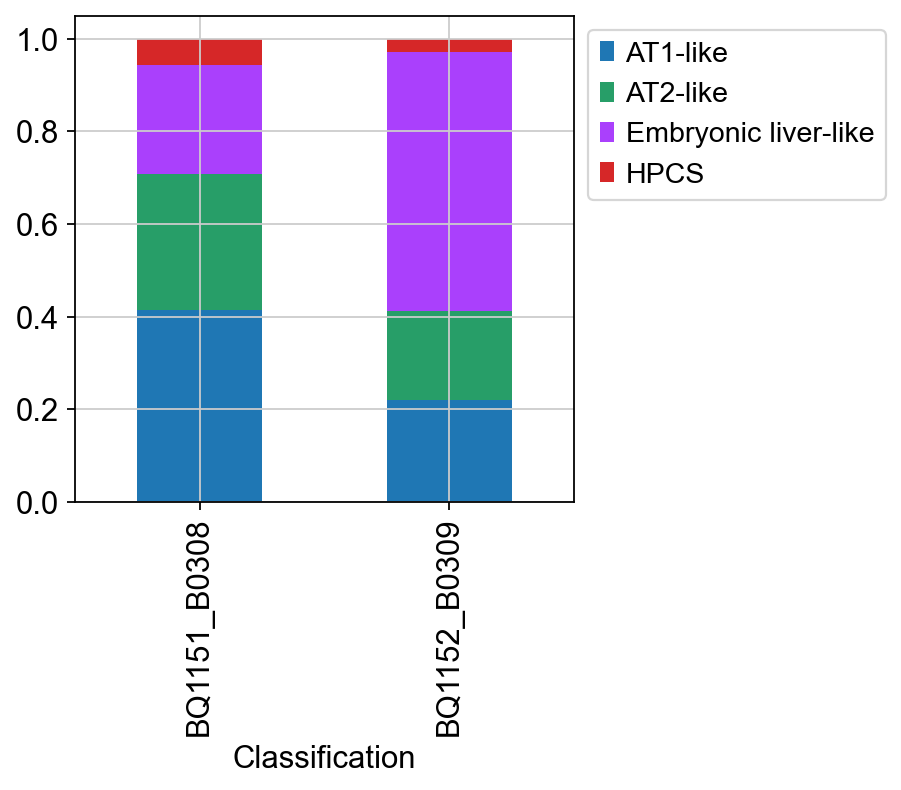

In [195]:
cell_proportion_df = pd.crosstab(adata[adata.obs.Allele == 'Hopx'].obs['cell type'],adata[adata.obs.Allele == 'Hopx'].obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata[adata.obs.Allele == 'Hopx'].uns['cell type_colors']).legend(bbox_to_anchor=(1,1))

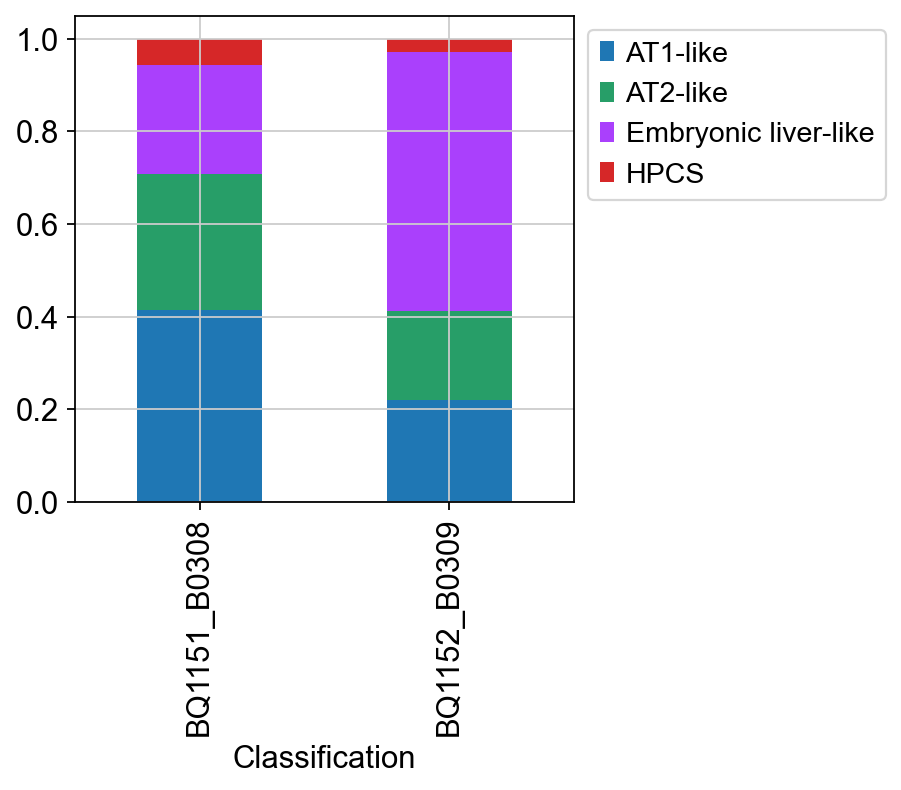

In [213]:
cell_proportion_df = pd.crosstab(adata[adata.obs.Allele == 'Hopx'].obs['cell type'],adata[adata.obs.Allele == 'Hopx'].obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata[adata.obs.Allele == 'Hopx'].uns['cell type_colors']).legend(bbox_to_anchor=(1,1))

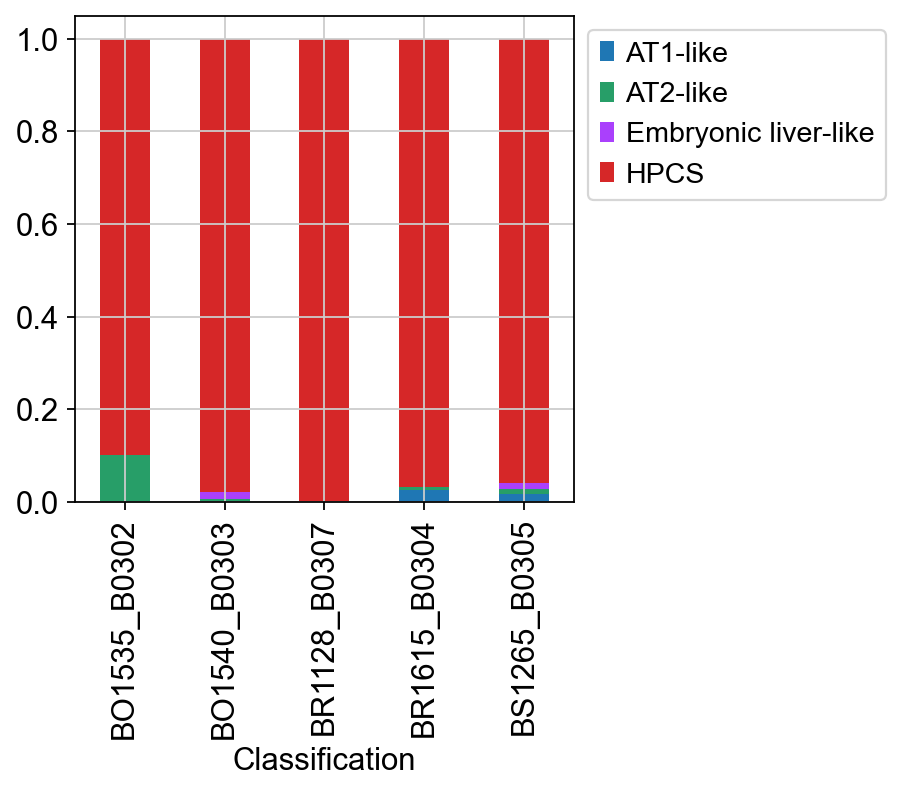

In [215]:
cell_proportion_df = pd.crosstab(adata[adata.obs.Allele == 'Slc4a11'].obs['cell type'],adata[adata.obs.Allele == 'Slc4a11'].obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata[adata.obs.Allele == 'Slc4a11'].uns['cell type_colors']).legend(bbox_to_anchor=(1,1))

In [216]:
adata.obs.Classification.value_counts(sort=False)

Classification
BO1535_B0302     79
BO1540_B0303    137
BQ1151_B0308    553
BQ1152_B0309    556
BR1128_B0307     28
BR1615_B0304    153
BS1265_B0305    174
Name: count, dtype: int64

In [217]:
adata.obs.Classification.value_counts(sort=False).index

CategoricalIndex(['BO1535_B0302', 'BO1540_B0303', 'BQ1151_B0308',
                  'BQ1152_B0309', 'BR1128_B0307', 'BR1615_B0304',
                  'BS1265_B0305'],
                 categories=['BO1535_B0302', 'BO1540_B0303', 'BQ1151_B0308', 'BQ1152_B0309', 'BR1128_B0307', 'BR1615_B0304', 'BS1265_B0305'], ordered=False, dtype='category', name='Classification')

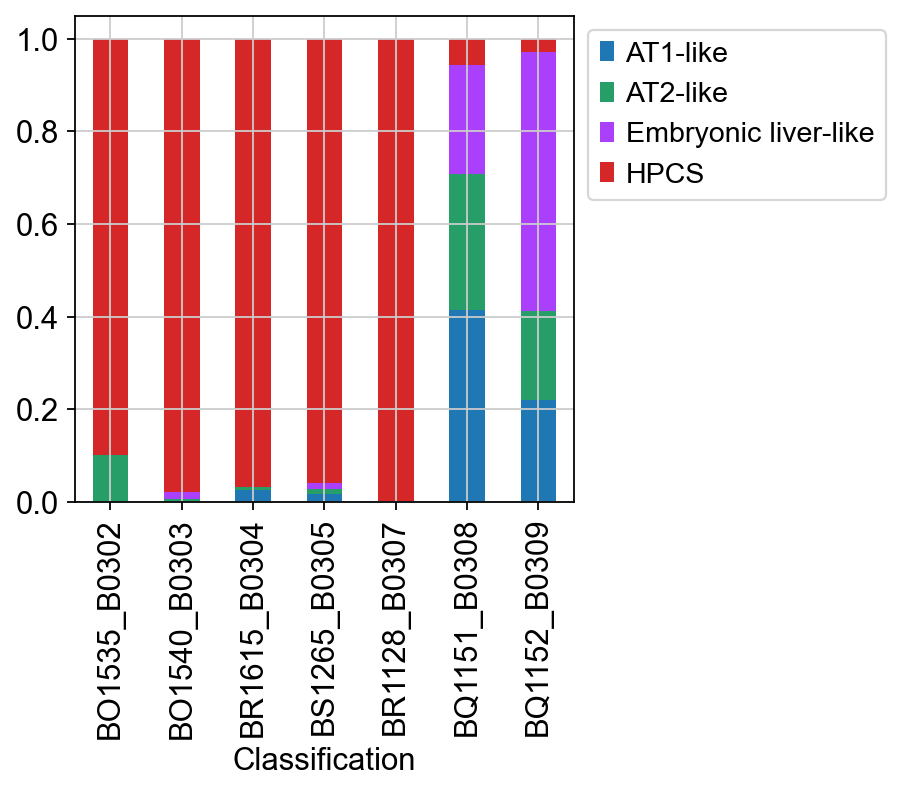

In [219]:
mice = ['BO1535_B0302','BO1540_B0303', 'BR1615_B0304','BS1265_B0305','BR1128_B0307','BQ1151_B0308','BQ1152_B0309']
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Classification'], normalize='columns')[mice].T.plot(kind='bar', stacked=True,color=adata.uns['cell type_colors']).legend(bbox_to_anchor=(1,1))

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


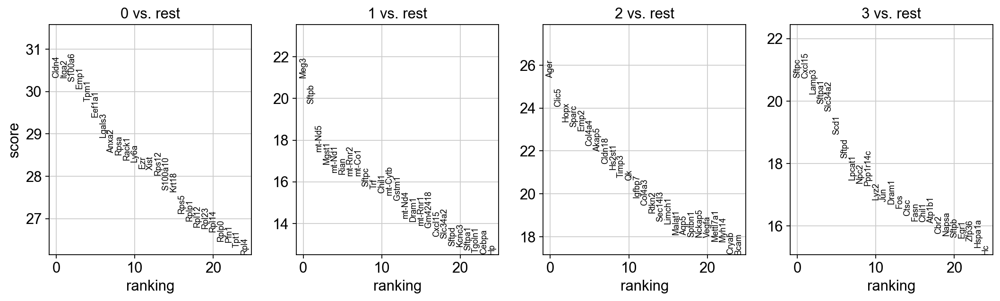

    using 'X_pca' with n_pcs = 150
Storing dendrogram info using `.uns['dendrogram_leiden']`


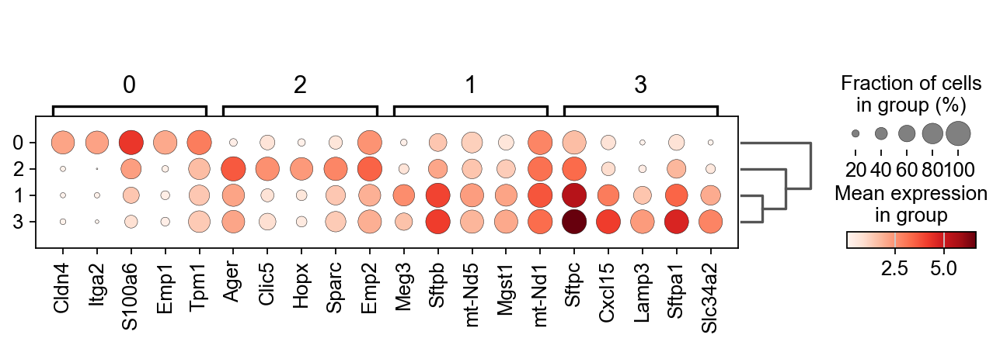

In [220]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby="leiden")

In [221]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
results_df = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores','logfoldchanges']})
results_df.to_excel('leiden_enriched_genes.xlsx')
results_df

,0_n,0_p,0_s,0_l,1_n,1_p,1_s,1_l,2_n,2_p,2_s,2_l,3_n,3_p,3_s,3_l
0,Cldn4,6.026508e-198,30.326105,5.420681,Meg3,1.453897e-93,21.000301,3.664896,Ager,3.460720e-138,25.419094,3.752263,Sftpc,1.974438e-91,20.748814,4.919121
1,Itga2,6.026508e-198,30.324789,5.970012,Sftpb,1.160149e-82,19.736879,2.695942,Clic5,8.466187e-124,24.053949,3.355952,Cxcl15,1.974438e-91,20.732330,4.167209
2,S100a6,6.259971e-197,30.234198,4.258318,mt-Nd5,1.108078e-64,17.449430,1.496429,Hopx,6.492572e-117,23.369505,4.264737,Lamp3,4.325162e-87,20.225697,3.445698
3,Emp1,7.777790e-195,30.064898,4.312593,Mgst1,3.173053e-60,16.831993,1.807891,Sparc,1.737199e-114,23.117121,2.997795,Sftpa1,1.945431e-84,19.907722,4.294651
4,Tpm1,5.204645e-191,29.763309,2.389058,mt-Nd1,1.194142e-57,16.461304,1.045572,Emp2,7.119999e-113,22.946531,1.980331,Slc34a2,1.877660e-82,19.666113,3.601797
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22304,Mettl7a1,5.971777e-131,-24.602840,-5.738339,H2-D1,1.862728e-63,-17.279785,-1.621038,Eef1a1,1.405842e-44,-14.444639,-1.112796,S100a14,4.881461e-34,-12.648672,-2.173791
22305,Sftpd,2.762578e-137,-25.195761,-3.552084,Ywhah,2.922218e-65,-17.534166,-2.019445,Clic1,1.064730e-44,-14.465395,-1.688809,Tpm1,1.228429e-34,-12.758140,-1.330082
22306,Cd74,6.021991e-170,-28.047220,-3.184452,H2-K1,1.342459e-67,-17.847757,-1.714915,Rpl12,6.663938e-47,-14.813697,-1.594310,Ahnak,4.040391e-36,-13.029353,-1.689432
22307,Sftpc,4.299455e-178,-28.727421,-5.271442,Ezr,4.826692e-68,-17.917223,-1.900386,Cd44,1.688283e-54,-15.951081,-2.375422,Lmo7,2.138301e-44,-14.445302,-1.959873


## End here

## Investigate mice to throw out

In [256]:
adata.obs[['Allele','Classification']].value_counts()

Allele  Classification
Hopx    BN1487-3          5061
        BN1487-2          2769
        BN1487-1          2680
Pnp2    111635-2            79
        111635-1            58
Name: count, dtype: int64

In [257]:
adata.obs[['Allele','traced']].value_counts(sort=False)

Allele  traced
Hopx    traced    10510
Pnp2    subq        137
Name: count, dtype: int64

In [258]:
adata2 = adata.copy()

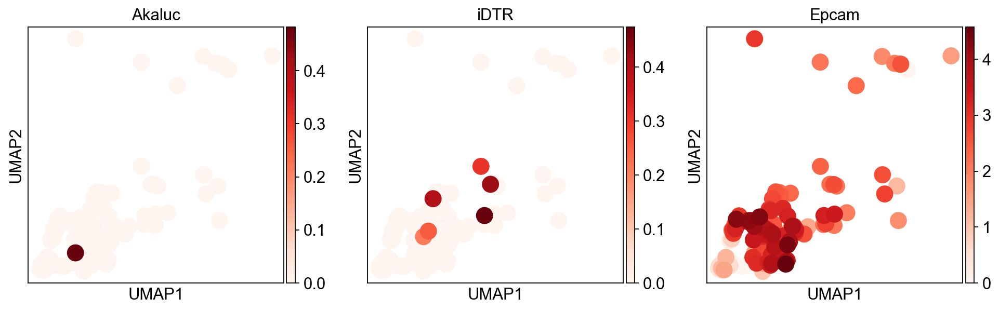

In [272]:
sc.pl.umap(adata[adata.obs.Allele=='Pnp2',:], color=['Akaluc','iDTR','Epcam'], cmap='Reds')

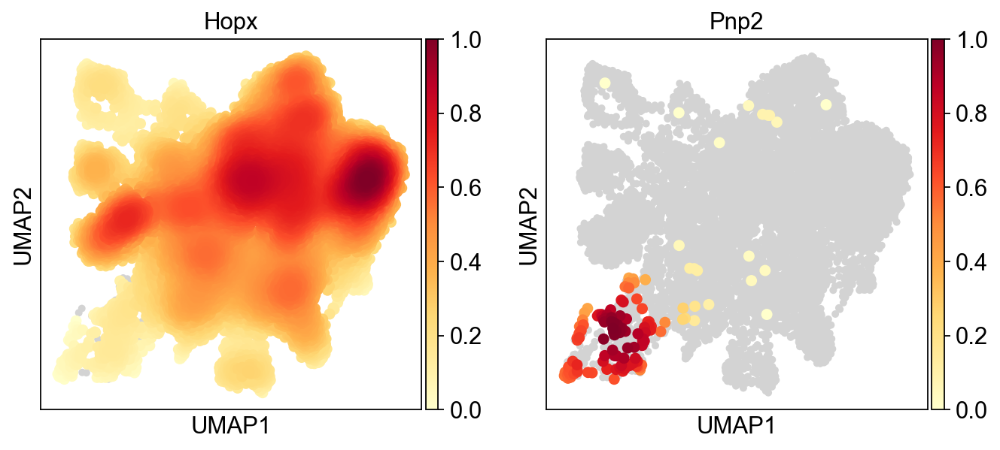

In [259]:
sc.pl.embedding_density(adata2, basis='umap', key='umap_density_Allele')

In [260]:
sc.tl.embedding_density(adata2, basis='umap', groupby='traced')

computing density on 'umap'
--> added
    'umap_density_traced', densities (adata.obs)
    'umap_density_traced_params', parameter (adata.uns)


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/__init__.py:1643: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_col_name] = dens_values


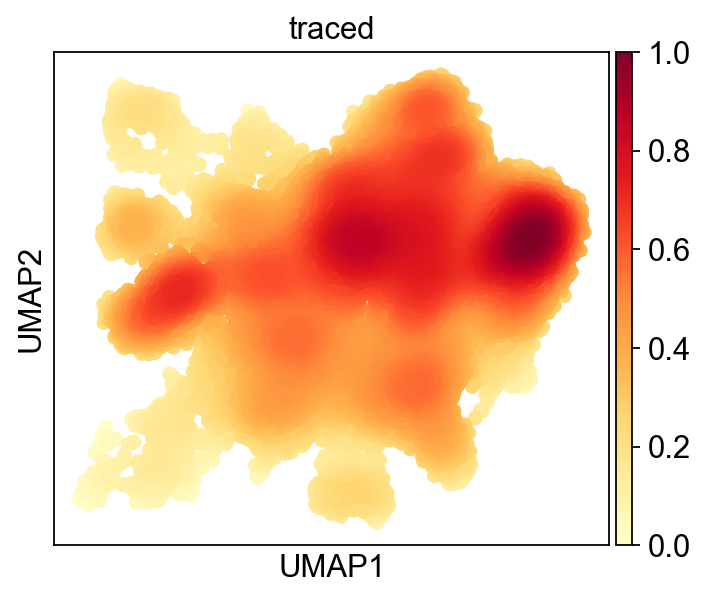

In [261]:
sc.pl.embedding_density(adata2[adata2.obs.Allele.isin(['Hopx']),:], basis='umap', key='umap_density_traced')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/__init__.py:1643: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[density_col_name] = dens_values


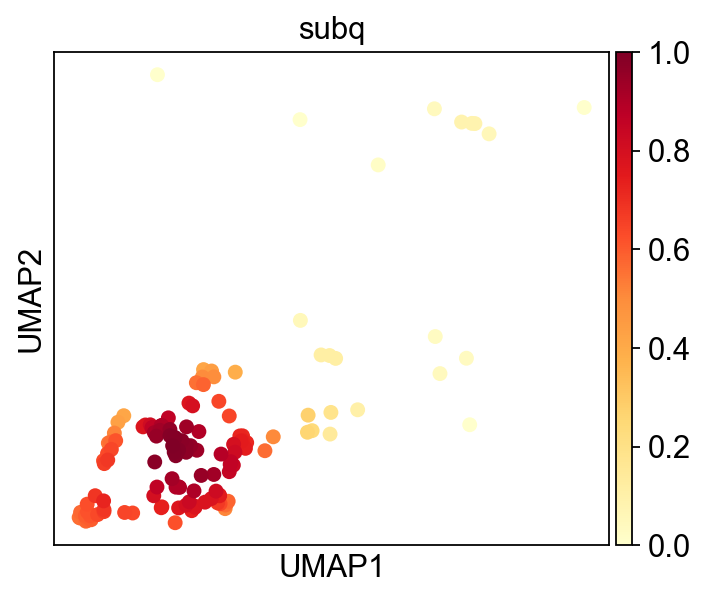

In [262]:
sc.pl.embedding_density(adata2[adata2.obs.Allele.isin(['Pnp2']),:], basis='umap', key='umap_density_traced')

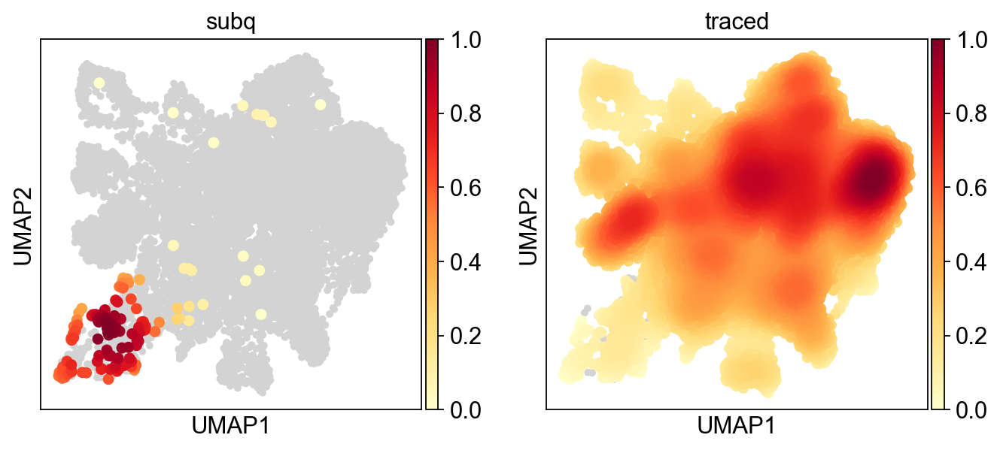

In [263]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_traced')

## Calculate PV

## Figures for paper

# Save the result

In [ ]:
adata.write(results_file, compression='gzip')